In [37]:
# Acquire the Data

In [56]:
%matplotlib inline
import csv 
import os 
import numpy as np
import requests 
import helper 
from glob import glob
from matplotlib import pyplot

In [20]:
DATA_FILE = os.path.join('data/pokemonGO.csv')

pokemon_collection = []

with open(DATA_FILE, 'r') as f:
    for line in f:
        line_cols = line.replace('\n', '').split(',')
        url = line_cols[6]
        if url.startswith('http'):
            pokemon_collection.append((line_cols[0], line_cols[1].lower(), url))

In [21]:
pokemon_collection[0]

('001',
 'bulbasaur',
 'http://cdn.bulbagarden.net/upload/thumb/2/21/001Bulbasaur.png/250px-001Bulbasaur.png')

In [31]:
for pokemon in pokemon_collection:    
    if len(pokemon[2]) == 0:
        continue 
        
    with open(os.path.join("data", os.path.split(pokemon[2])[1]), 'wb') as f:
        response = requests.get(pokemon[2], stream=True)

        if not response.ok:
            print(response)

        for block in response.iter_content(1024):
            if not block:
                break

            f.write(block)

In [57]:
# checkpoint

In [28]:
import zipfile
zip_ref = zipfile.ZipFile(os.path.join('data/main-sprites.zip'), 'r')
zip_ref.extractall(os.path.join('data'))
zip_ref.close()

In [1]:
%matplotlib inline
import csv 
import os 
import numpy as np
import requests 
import helper 
from glob import glob
from matplotlib import pyplot

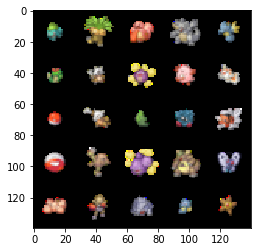

In [2]:
show_n_images = 25
images = helper.get_batch(helper.get_images()[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(images, 'RGB'))

In [3]:
# setup the GAN 

In [4]:
## import tensorflow (check if system supports GPU)

In [5]:
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.0.0


/Users/jnewnham/anaconda/lib/python3.6/site-packages/ipykernel/__main__.py:11: UserWarning: No GPU found. Please use a GPU to train your neural network.


In [6]:
## setup graphs inputs 

In [7]:
def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    inputs_real = tf.placeholder(tf.float32, (None, image_width, image_height, image_channels), name='input_real') 
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    learning_rate = tf.placeholder(tf.float32, name='learning_rate')
    
    return inputs_real, inputs_z, learning_rate

In [8]:
def leaky_relu(x, alpha=0.2, name='leaky_relu'):
    return tf.maximum(alpha * x, x)

In [9]:
## Create our discriminator network 

In [10]:
def discriminator(images, reuse=False, alpha=0.2, keep_prob=0.8):
    """
    Create the discriminator network
    :param image: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :param alpha: Leak factor for leaky ReLU (as mentioned in lecture)
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 28x28x3
        x1 = tf.layers.conv2d(images, 
                              64, 
                              5, 
                              strides=2, 
                              padding='same', 
                              kernel_initializer=tf.contrib.layers.xavier_initializer_conv2d())
        relu1 = leaky_relu(x1, alpha)
        # 14x14x64

        
        x2 = tf.layers.conv2d(relu1, 
                              128, 
                              5, 
                              strides=2, 
                              padding='same', 
                              kernel_initializer=tf.contrib.layers.xavier_initializer_conv2d())
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 =  leaky_relu(bn2, alpha) 
        # 7x7x128
        
        x3 = tf.layers.conv2d(relu2, 
                              256, 
                              5, 
                              strides=1, 
                              padding='same', 
                              kernel_initializer=tf.contrib.layers.xavier_initializer_conv2d())
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = leaky_relu(bn3, alpha)
        # as advised in the feedback 
        relu3 = tf.nn.dropout(relu3, keep_prob)
        # 7x7x256 (approx.)
        
        # Flatten it
        flat = tf.reshape(relu3, (-1, 7*7*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

In [11]:
## Create our generator network 

In [12]:
def generator(z, out_channel_dim, is_train=True, alpha=0.2, keep_prob=0.6):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :param alpha: Leak factor for leaky ReLU (as mentioned in lecture)
    :return: The tensor output of the generator
    """
    
    with tf.variable_scope('generator', reuse=not is_train):
        # First fully connected layer
        x1 = tf.layers.dense(z, 7*7*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 7, 7, 512))
        x1 = tf.layers.batch_normalization(x1, training=is_train)
        x1 = leaky_relu(x1, alpha)
        x1 = tf.nn.dropout(x1, keep_prob)
        # 7x7x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=1, padding='same', 
                                        kernel_initializer=tf.contrib.layers.xavier_initializer_conv2d())
        x2 = tf.layers.batch_normalization(x2, training=is_train)
        x2 = leaky_relu(x2, alpha)
        x2 = tf.nn.dropout(x2, keep_prob)
        # 7x7x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same', 
                                        kernel_initializer=tf.contrib.layers.xavier_initializer_conv2d())
        x3 = tf.layers.batch_normalization(x3, training=is_train)
        x3 = leaky_relu(x3, alpha)
        x3 = tf.nn.dropout(x3, keep_prob)
        # 14x14x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, out_channel_dim, 5, strides=2, padding='same', 
                                           kernel_initializer=tf.contrib.layers.xavier_initializer_conv2d())
        # 28x28x3 now
        
        out = tf.tanh(logits)
        
        return out

In [13]:
## loss function (for both, the generator and discriminator)

In [14]:

def model_loss(input_real, input_z, out_channel_dim, alpha=0.2, smooth=0.1):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset, 
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :param alpha: Leak factor for leaky ReLU (as mentioned in lecture)
    :param smooth:  To help the discriminator generalize better, the labels are reduced a bit 
           from 1.0 to 0.9, for example, using the parameter smooth. This is known as label smoothing, 
           typically used with classifiers to improve performance. In TensorFlow, 
           it looks something like labels = tf.ones_like(tensor) * (1 - smooth)
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, out_channel_dim, alpha=alpha)
    
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)
    
    
    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real) * (1 - smooth)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

In [15]:
## create the generator and discriminator optimisation operations 

In [16]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]
    
    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

In [17]:
# training

In [18]:
def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()
    
    return images_grid

In [19]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, 
          data_shape, data_image_mode, alpha=0.2, smooth=0.1):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    out_channel_dim = data_shape[3] 
    
    input_real, input_z, learning_rate_ph = model_inputs(data_shape[1], 
                                                        data_shape[2], 
                                                        out_channel_dim, 
                                                        z_dim)
    
    d_loss, g_loss = model_loss(input_real, input_z, out_channel_dim, alpha=alpha, smooth=smooth)
    
    d_train_opt, g_train_opt = model_opt(d_loss, g_loss, learning_rate_ph, beta1)
    
    steps = 0
    print_every = 10    
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                steps += 1
                
                batch_images = batch_images * 2
                
                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                
                # Run optimizers
                _ = sess.run(d_train_opt, 
                             feed_dict={
                                 input_real: batch_images, 
                                 input_z: batch_z, 
                                 learning_rate_ph: learning_rate})
                _ = sess.run(g_train_opt, 
                             feed_dict={
                                 input_z: batch_z, 
                                 input_real: batch_images, 
                                 learning_rate_ph: learning_rate})
                
                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    output_image = show_generator_output(sess, 
                                          20, # number of images to display 
                                          input_z, 
                                          out_channel_dim, 
                                          data_image_mode)
                    
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = sess.run(d_loss, {input_z: batch_z, input_real: batch_images})
                    train_loss_g = g_loss.eval({input_z: batch_z})
            
                    print("Epoch {}/{}...".format(epoch_i+1, epoch_count),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))        

In [20]:
## run the GAN 

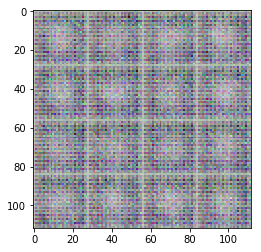

Epoch 1/10000... Discriminator Loss: 2.7170... Generator Loss: 0.2634


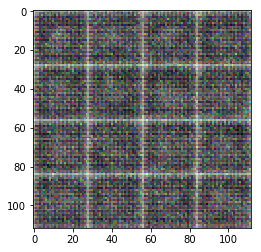

Epoch 1/10000... Discriminator Loss: 1.8916... Generator Loss: 1.4830


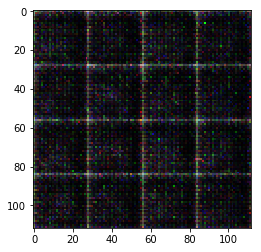

Epoch 1/10000... Discriminator Loss: 2.8073... Generator Loss: 0.1656


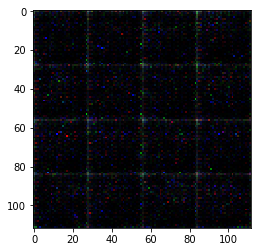

Epoch 1/10000... Discriminator Loss: 1.1292... Generator Loss: 2.2996


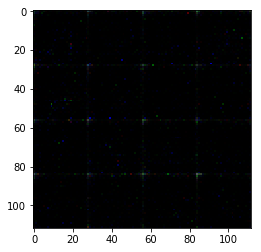

Epoch 1/10000... Discriminator Loss: 1.9420... Generator Loss: 0.2999


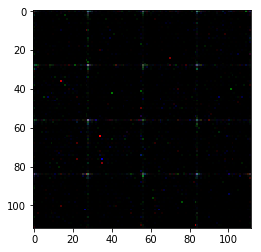

Epoch 1/10000... Discriminator Loss: 0.9734... Generator Loss: 1.2002


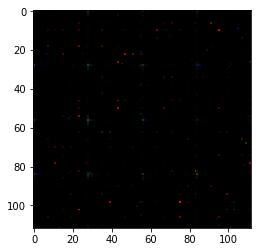

Epoch 1/10000... Discriminator Loss: 1.5892... Generator Loss: 3.2865


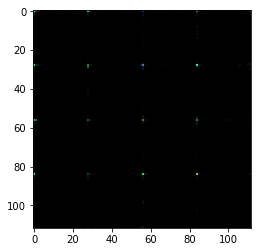

Epoch 1/10000... Discriminator Loss: 1.6276... Generator Loss: 1.8426


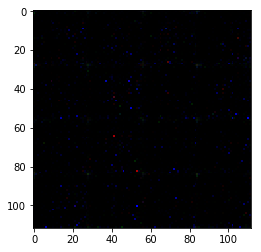

Epoch 1/10000... Discriminator Loss: 1.2869... Generator Loss: 0.9857


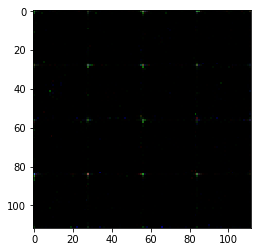

Epoch 1/10000... Discriminator Loss: 1.2977... Generator Loss: 2.0896


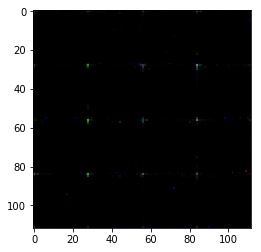

Epoch 1/10000... Discriminator Loss: 0.7160... Generator Loss: 2.1175


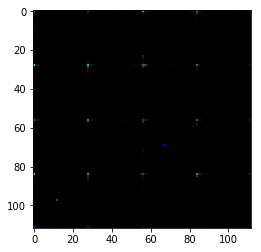

Epoch 1/10000... Discriminator Loss: 2.4087... Generator Loss: 0.2297


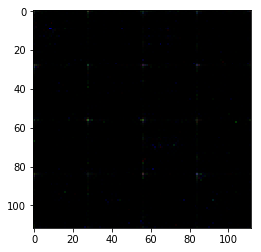

Epoch 1/10000... Discriminator Loss: 1.1019... Generator Loss: 1.6607


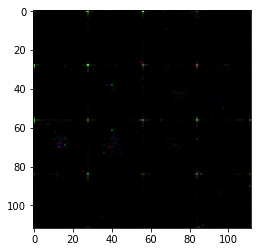

Epoch 1/10000... Discriminator Loss: 1.2727... Generator Loss: 0.8482


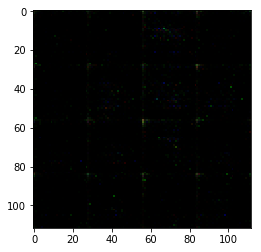

Epoch 1/10000... Discriminator Loss: 1.1751... Generator Loss: 1.1798


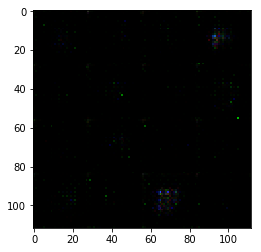

Epoch 1/10000... Discriminator Loss: 0.9768... Generator Loss: 2.2585


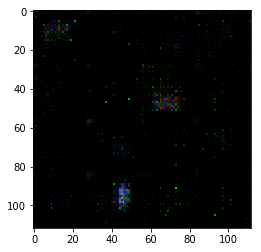

Epoch 1/10000... Discriminator Loss: 0.8585... Generator Loss: 1.1089


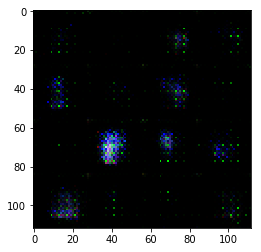

Epoch 1/10000... Discriminator Loss: 1.8174... Generator Loss: 0.4085


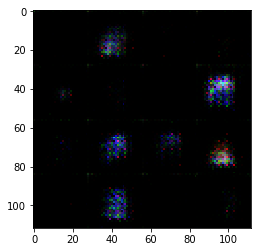

Epoch 1/10000... Discriminator Loss: 0.9173... Generator Loss: 1.7403


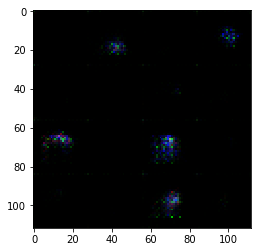

Epoch 1/10000... Discriminator Loss: 0.7034... Generator Loss: 1.8850


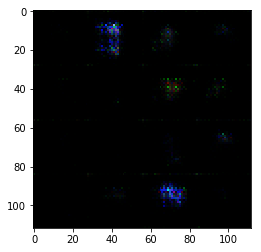

Epoch 1/10000... Discriminator Loss: 1.4325... Generator Loss: 0.6238


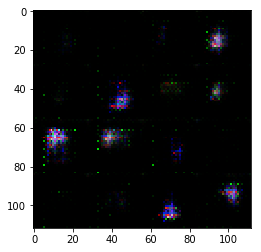

Epoch 1/10000... Discriminator Loss: 1.2730... Generator Loss: 0.5426


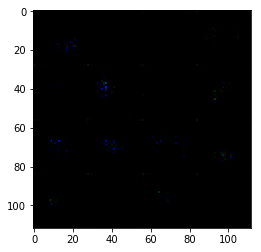

Epoch 1/10000... Discriminator Loss: 1.9598... Generator Loss: 4.1559


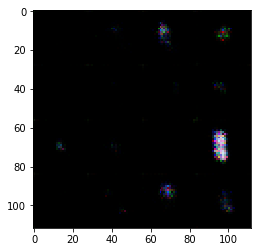

Epoch 1/10000... Discriminator Loss: 1.4312... Generator Loss: 1.0056


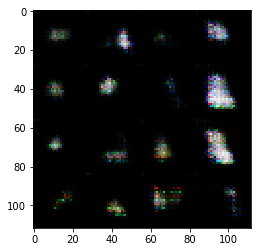

Epoch 1/10000... Discriminator Loss: 1.3226... Generator Loss: 0.7450


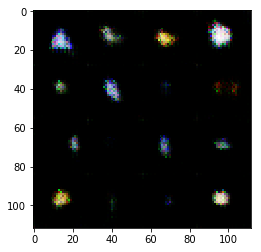

Epoch 1/10000... Discriminator Loss: 0.9546... Generator Loss: 1.5911


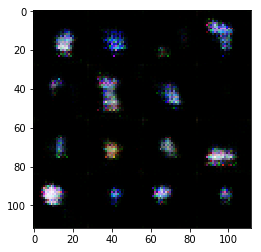

Epoch 1/10000... Discriminator Loss: 0.9106... Generator Loss: 2.0357


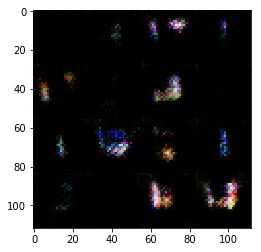

Epoch 1/10000... Discriminator Loss: 1.4399... Generator Loss: 0.8919


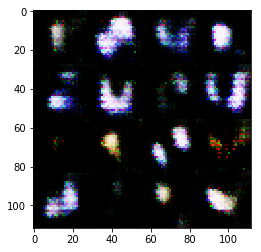

Epoch 1/10000... Discriminator Loss: 0.5662... Generator Loss: 4.5591


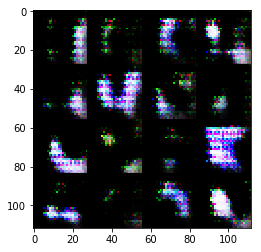

Epoch 1/10000... Discriminator Loss: 0.4799... Generator Loss: 3.2544


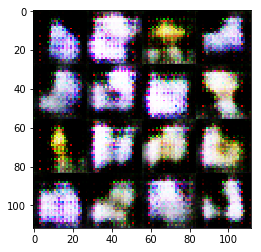

Epoch 1/10000... Discriminator Loss: 1.6155... Generator Loss: 1.1220


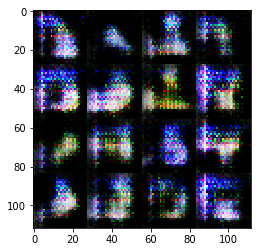

Epoch 1/10000... Discriminator Loss: 1.7021... Generator Loss: 0.4234


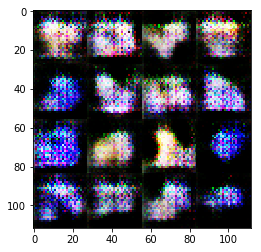

Epoch 1/10000... Discriminator Loss: 1.7212... Generator Loss: 0.7641


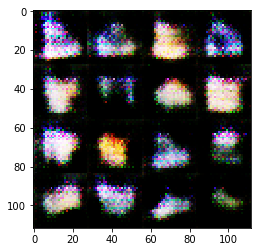

Epoch 1/10000... Discriminator Loss: 1.0346... Generator Loss: 1.4059


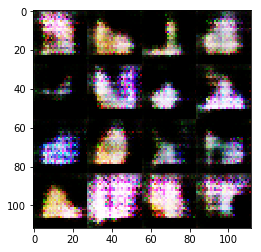

Epoch 1/10000... Discriminator Loss: 1.2795... Generator Loss: 0.8918


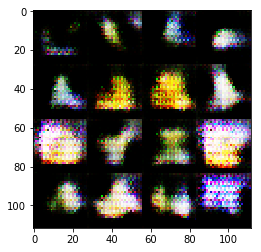

Epoch 1/10000... Discriminator Loss: 0.7538... Generator Loss: 2.0756


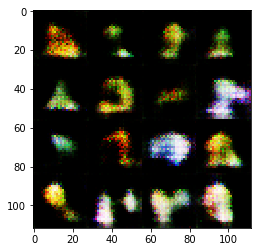

Epoch 1/10000... Discriminator Loss: 1.0610... Generator Loss: 1.2396


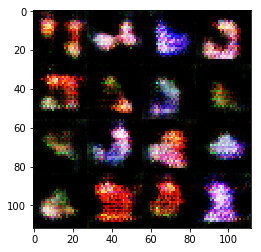

Epoch 1/10000... Discriminator Loss: 1.0199... Generator Loss: 1.5388


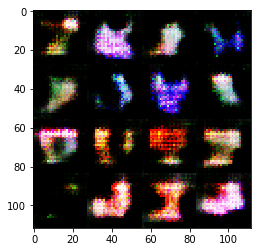

Epoch 1/10000... Discriminator Loss: 0.3948... Generator Loss: 4.0284


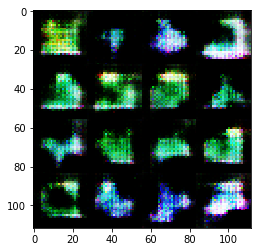

Epoch 1/10000... Discriminator Loss: 0.5527... Generator Loss: 2.3237


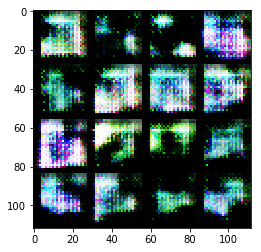

Epoch 1/10000... Discriminator Loss: 0.4432... Generator Loss: 2.8711


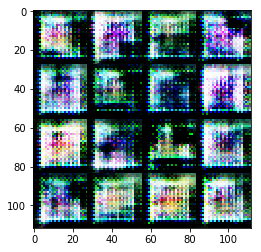

Epoch 1/10000... Discriminator Loss: 0.4522... Generator Loss: 2.9913


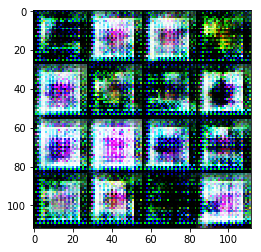

Epoch 1/10000... Discriminator Loss: 0.4135... Generator Loss: 3.4040


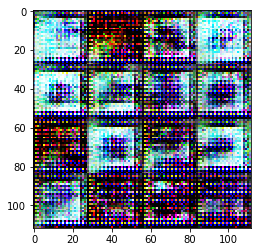

Epoch 1/10000... Discriminator Loss: 0.4653... Generator Loss: 2.9698


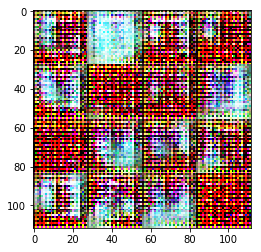

Epoch 2/10000... Discriminator Loss: 1.2977... Generator Loss: 1.2521


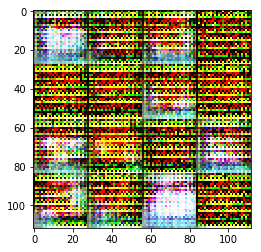

Epoch 2/10000... Discriminator Loss: 0.4831... Generator Loss: 2.4354


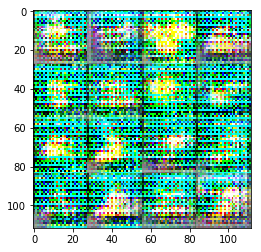

Epoch 2/10000... Discriminator Loss: 0.3839... Generator Loss: 3.8607


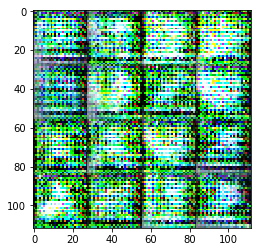

Epoch 2/10000... Discriminator Loss: 0.5661... Generator Loss: 2.1453


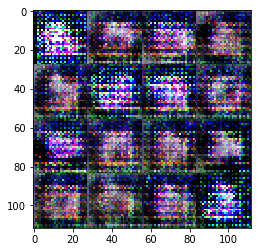

Epoch 2/10000... Discriminator Loss: 1.9048... Generator Loss: 0.4742


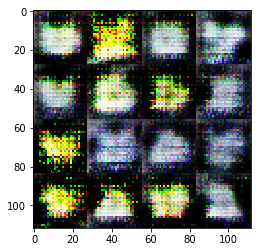

Epoch 2/10000... Discriminator Loss: 0.7572... Generator Loss: 1.3284


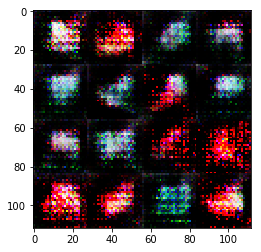

Epoch 2/10000... Discriminator Loss: 0.7165... Generator Loss: 2.2391


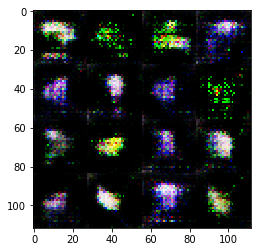

Epoch 2/10000... Discriminator Loss: 2.0351... Generator Loss: 0.3128


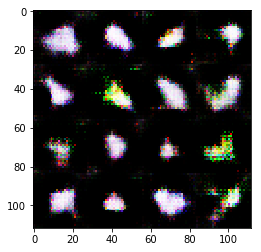

Epoch 2/10000... Discriminator Loss: 1.9616... Generator Loss: 4.2444


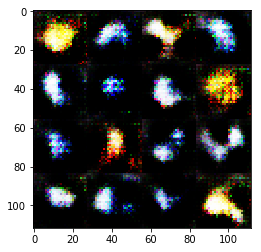

Epoch 2/10000... Discriminator Loss: 0.8044... Generator Loss: 2.2536


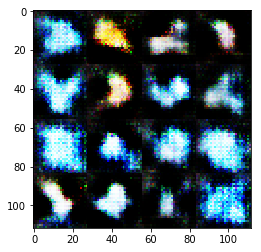

Epoch 2/10000... Discriminator Loss: 1.3786... Generator Loss: 0.5973


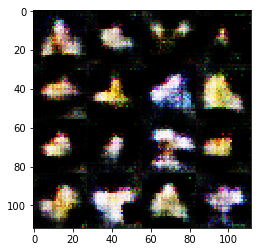

Epoch 2/10000... Discriminator Loss: 1.6740... Generator Loss: 2.7526


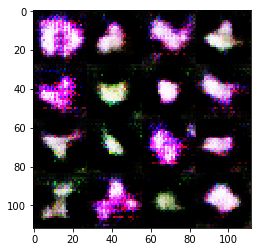

Epoch 2/10000... Discriminator Loss: 1.1287... Generator Loss: 0.8677


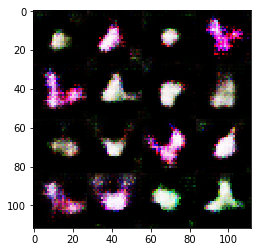

Epoch 2/10000... Discriminator Loss: 1.0519... Generator Loss: 1.0402


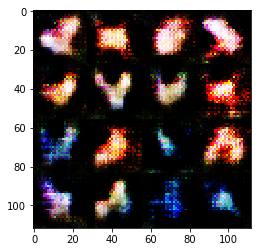

Epoch 2/10000... Discriminator Loss: 1.0365... Generator Loss: 0.9896


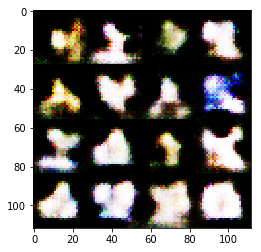

Epoch 2/10000... Discriminator Loss: 1.4747... Generator Loss: 1.8301


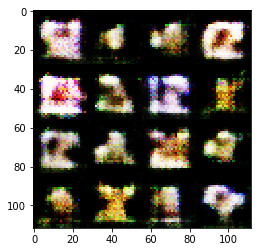

Epoch 2/10000... Discriminator Loss: 1.6404... Generator Loss: 2.0694


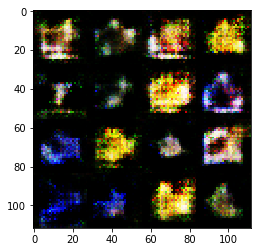

Epoch 2/10000... Discriminator Loss: 1.2851... Generator Loss: 0.8920


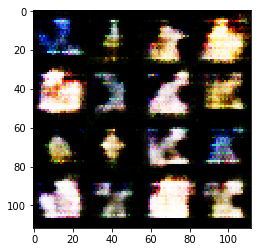

Epoch 2/10000... Discriminator Loss: 1.3331... Generator Loss: 0.8264


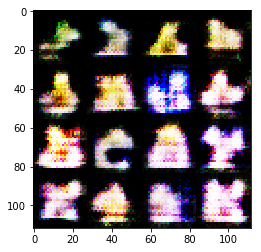

Epoch 2/10000... Discriminator Loss: 1.6530... Generator Loss: 0.3900


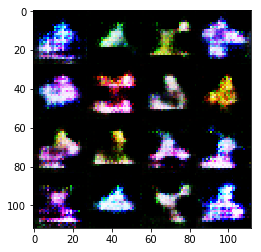

Epoch 2/10000... Discriminator Loss: 1.1871... Generator Loss: 1.1689


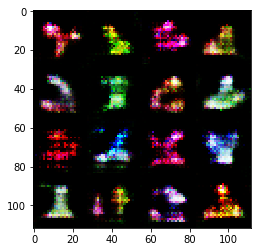

Epoch 2/10000... Discriminator Loss: 1.0354... Generator Loss: 1.1760


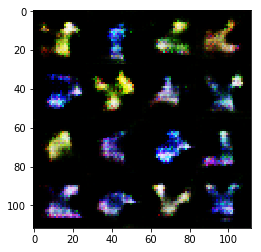

Epoch 2/10000... Discriminator Loss: 3.0400... Generator Loss: 0.1191


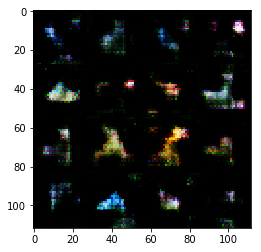

Epoch 2/10000... Discriminator Loss: 1.6099... Generator Loss: 0.4729


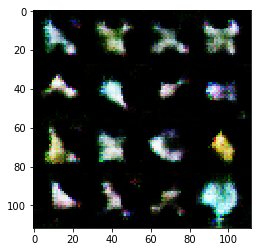

Epoch 2/10000... Discriminator Loss: 1.1153... Generator Loss: 1.1059


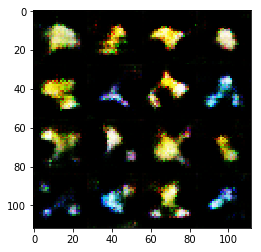

Epoch 2/10000... Discriminator Loss: 1.0278... Generator Loss: 1.2606


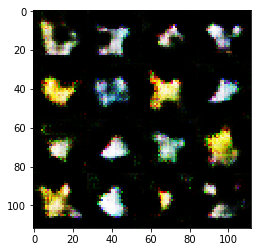

Epoch 2/10000... Discriminator Loss: 1.1660... Generator Loss: 1.0913


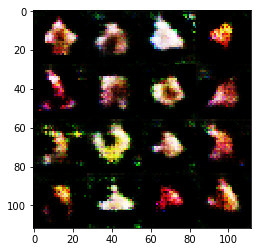

Epoch 2/10000... Discriminator Loss: 1.2792... Generator Loss: 0.8178


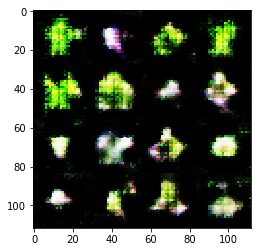

Epoch 2/10000... Discriminator Loss: 1.5338... Generator Loss: 0.5826


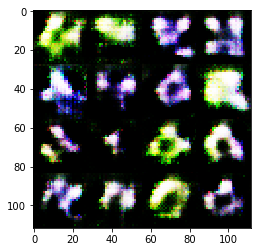

Epoch 2/10000... Discriminator Loss: 0.4516... Generator Loss: 3.2668


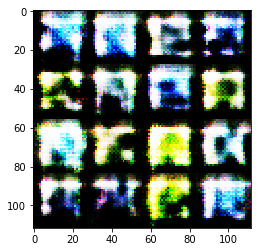

Epoch 2/10000... Discriminator Loss: 0.3855... Generator Loss: 3.6542


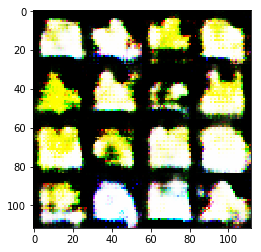

Epoch 2/10000... Discriminator Loss: 1.1155... Generator Loss: 1.1051


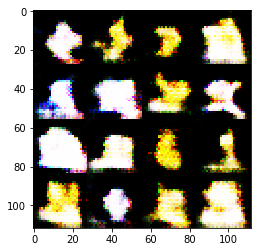

Epoch 2/10000... Discriminator Loss: 0.5845... Generator Loss: 1.9859


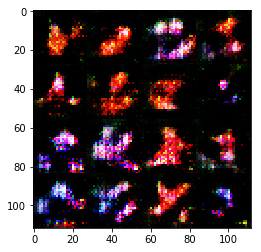

Epoch 2/10000... Discriminator Loss: 1.5238... Generator Loss: 0.5445


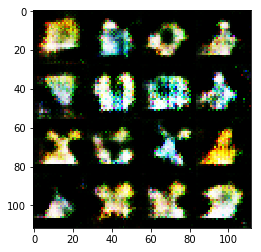

Epoch 2/10000... Discriminator Loss: 1.2037... Generator Loss: 0.6923


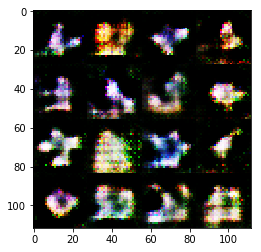

Epoch 2/10000... Discriminator Loss: 1.1816... Generator Loss: 1.1632


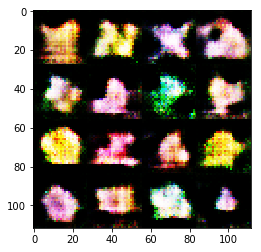

Epoch 2/10000... Discriminator Loss: 1.2616... Generator Loss: 0.7981


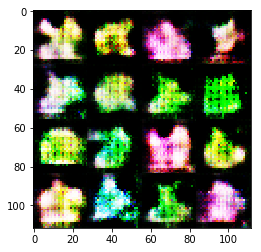

Epoch 2/10000... Discriminator Loss: 0.8982... Generator Loss: 1.3610


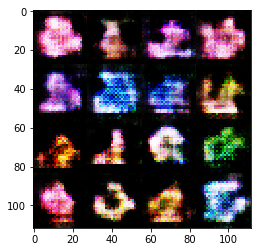

Epoch 2/10000... Discriminator Loss: 1.2081... Generator Loss: 0.9468


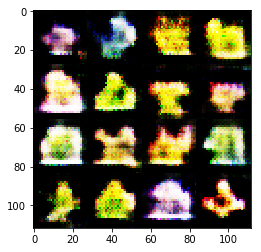

Epoch 2/10000... Discriminator Loss: 0.4069... Generator Loss: 3.1957


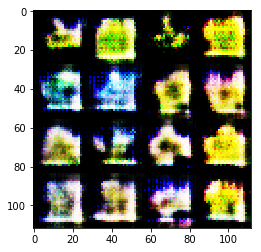

Epoch 2/10000... Discriminator Loss: 0.4169... Generator Loss: 3.1184


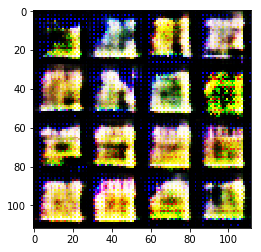

Epoch 2/10000... Discriminator Loss: 0.4319... Generator Loss: 2.6780


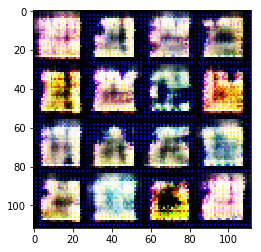

Epoch 2/10000... Discriminator Loss: 0.3855... Generator Loss: 4.2386


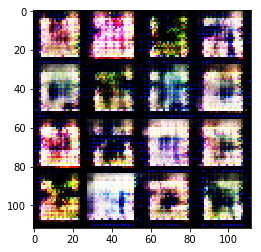

Epoch 2/10000... Discriminator Loss: 0.3824... Generator Loss: 3.5111


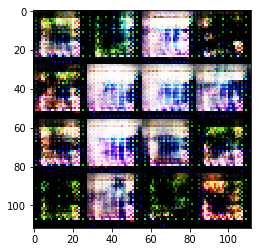

Epoch 2/10000... Discriminator Loss: 0.4658... Generator Loss: 6.5879


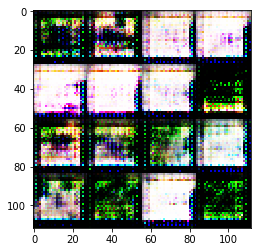

Epoch 3/10000... Discriminator Loss: 0.6297... Generator Loss: 4.5625


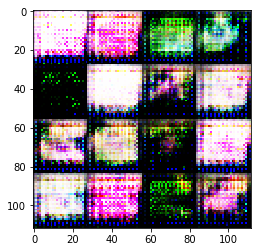

Epoch 3/10000... Discriminator Loss: 0.4363... Generator Loss: 3.4635


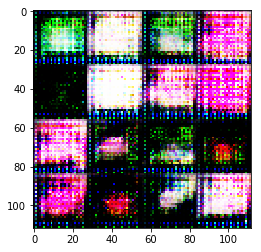

Epoch 3/10000... Discriminator Loss: 0.6011... Generator Loss: 2.5019


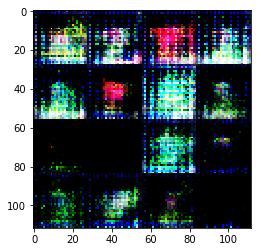

Epoch 3/10000... Discriminator Loss: 0.5415... Generator Loss: 2.3584


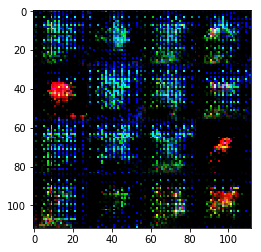

Epoch 3/10000... Discriminator Loss: 1.0123... Generator Loss: 0.8674


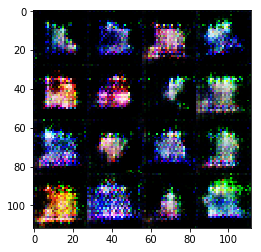

Epoch 3/10000... Discriminator Loss: 2.2655... Generator Loss: 5.3427


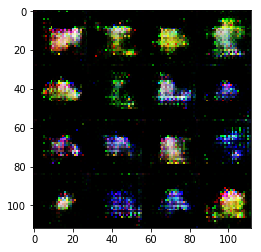

Epoch 3/10000... Discriminator Loss: 1.4253... Generator Loss: 3.7216


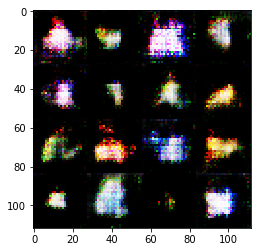

Epoch 3/10000... Discriminator Loss: 1.0284... Generator Loss: 1.3439


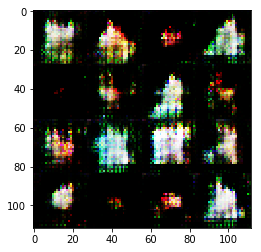

Epoch 3/10000... Discriminator Loss: 1.1196... Generator Loss: 0.7662


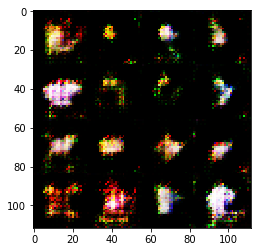

Epoch 3/10000... Discriminator Loss: 1.5918... Generator Loss: 0.4524


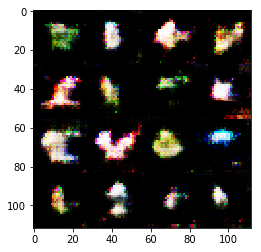

Epoch 3/10000... Discriminator Loss: 1.3066... Generator Loss: 2.4546


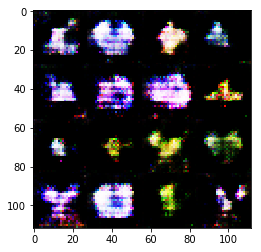

Epoch 3/10000... Discriminator Loss: 1.5263... Generator Loss: 0.6468


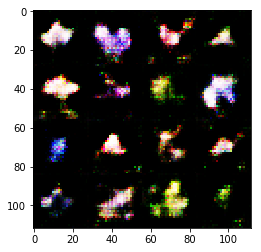

Epoch 3/10000... Discriminator Loss: 1.2527... Generator Loss: 0.9044


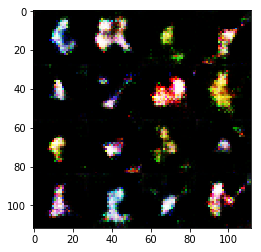

Epoch 3/10000... Discriminator Loss: 1.3632... Generator Loss: 0.6300


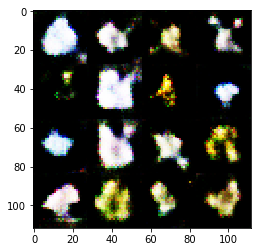

Epoch 3/10000... Discriminator Loss: 1.0643... Generator Loss: 1.0269


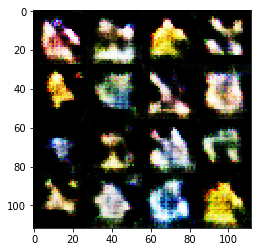

Epoch 3/10000... Discriminator Loss: 1.0554... Generator Loss: 1.3188


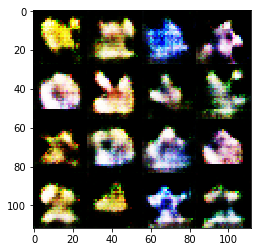

Epoch 3/10000... Discriminator Loss: 1.2429... Generator Loss: 0.8127


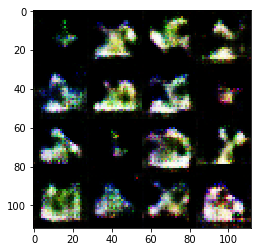

Epoch 3/10000... Discriminator Loss: 1.2210... Generator Loss: 1.0322


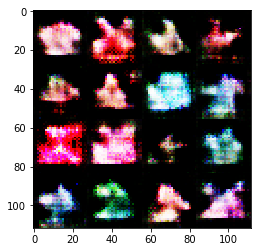

Epoch 3/10000... Discriminator Loss: 1.3662... Generator Loss: 1.0080


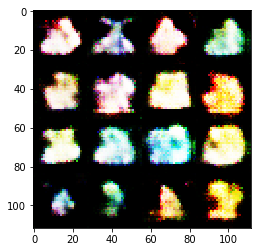

Epoch 3/10000... Discriminator Loss: 1.0925... Generator Loss: 1.1483


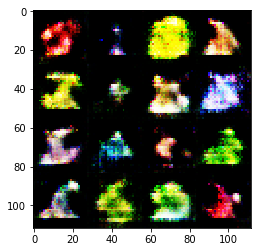

Epoch 3/10000... Discriminator Loss: 1.0107... Generator Loss: 1.3006


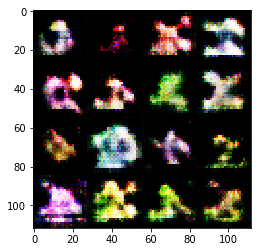

Epoch 3/10000... Discriminator Loss: 1.1739... Generator Loss: 1.1957


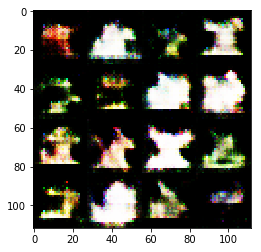

Epoch 3/10000... Discriminator Loss: 0.8557... Generator Loss: 1.7796


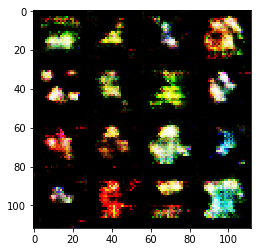

Epoch 3/10000... Discriminator Loss: 1.2335... Generator Loss: 0.7451


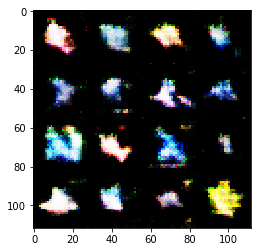

Epoch 3/10000... Discriminator Loss: 1.4924... Generator Loss: 0.6053


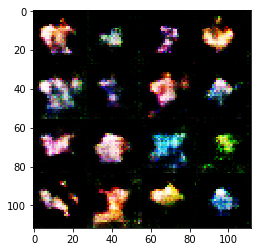

Epoch 3/10000... Discriminator Loss: 1.2530... Generator Loss: 0.8276


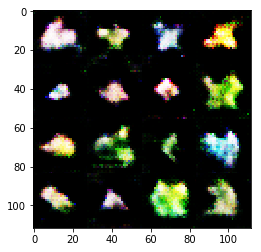

Epoch 3/10000... Discriminator Loss: 1.6537... Generator Loss: 0.8305


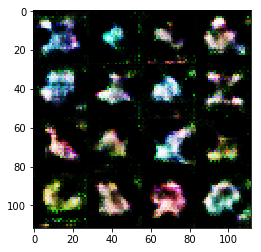

Epoch 3/10000... Discriminator Loss: 1.9214... Generator Loss: 1.4991


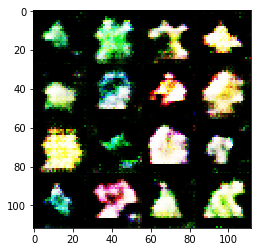

Epoch 3/10000... Discriminator Loss: 1.0469... Generator Loss: 0.8383


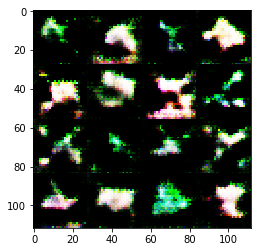

Epoch 3/10000... Discriminator Loss: 0.4286... Generator Loss: 2.9292


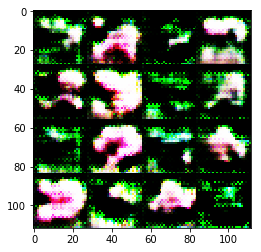

Epoch 3/10000... Discriminator Loss: 2.1427... Generator Loss: 0.8495


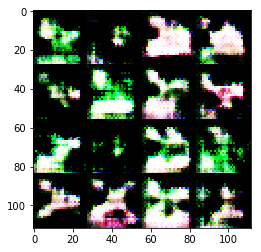

Epoch 3/10000... Discriminator Loss: 1.0263... Generator Loss: 1.0225


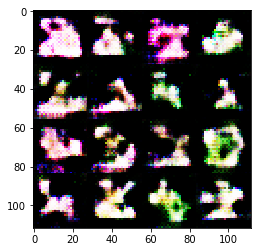

Epoch 3/10000... Discriminator Loss: 0.9731... Generator Loss: 1.3131


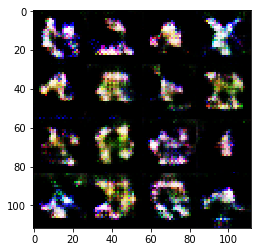

Epoch 3/10000... Discriminator Loss: 1.1520... Generator Loss: 2.5576


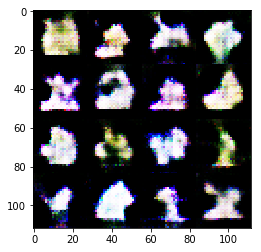

Epoch 3/10000... Discriminator Loss: 1.1920... Generator Loss: 1.1133


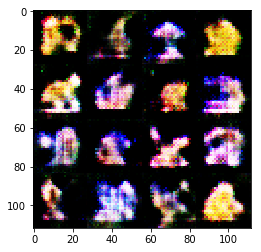

Epoch 3/10000... Discriminator Loss: 1.2796... Generator Loss: 0.9974


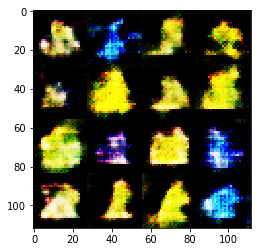

Epoch 3/10000... Discriminator Loss: 0.9519... Generator Loss: 1.0900


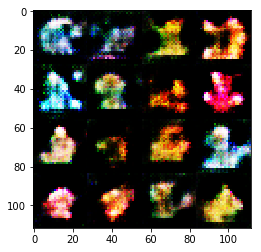

Epoch 3/10000... Discriminator Loss: 1.1291... Generator Loss: 1.3467


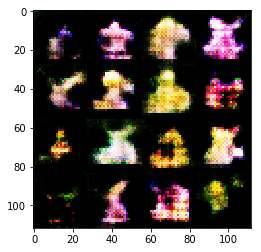

Epoch 3/10000... Discriminator Loss: 1.5069... Generator Loss: 0.5951


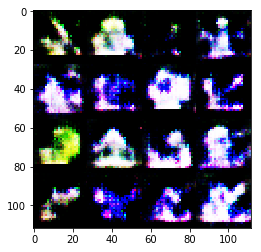

Epoch 3/10000... Discriminator Loss: 0.4946... Generator Loss: 2.8427


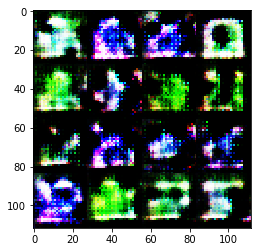

Epoch 3/10000... Discriminator Loss: 0.3755... Generator Loss: 3.5878


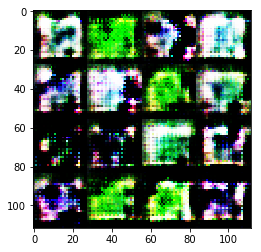

Epoch 3/10000... Discriminator Loss: 0.4089... Generator Loss: 3.7826


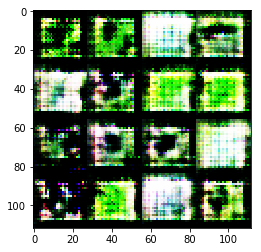

Epoch 3/10000... Discriminator Loss: 0.5315... Generator Loss: 2.7395


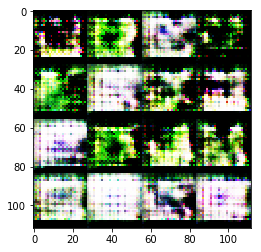

Epoch 3/10000... Discriminator Loss: 0.3664... Generator Loss: 3.9767


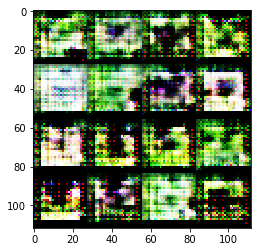

Epoch 3/10000... Discriminator Loss: 0.4577... Generator Loss: 4.2063


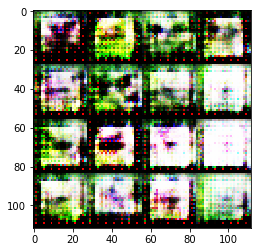

Epoch 4/10000... Discriminator Loss: 0.4374... Generator Loss: 5.1355


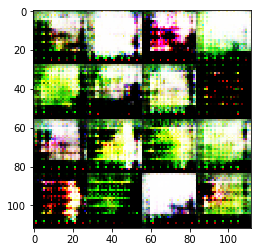

Epoch 4/10000... Discriminator Loss: 0.4737... Generator Loss: 2.3673


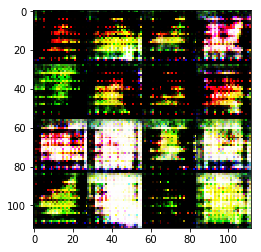

Epoch 4/10000... Discriminator Loss: 0.5083... Generator Loss: 2.6098


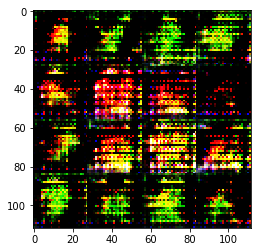

Epoch 4/10000... Discriminator Loss: 0.5150... Generator Loss: 2.2498


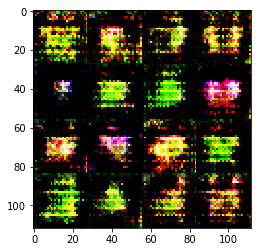

Epoch 4/10000... Discriminator Loss: 0.6809... Generator Loss: 1.7664


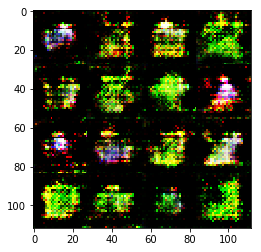

Epoch 4/10000... Discriminator Loss: 1.3957... Generator Loss: 2.9640


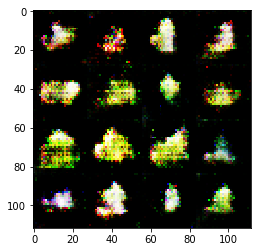

Epoch 4/10000... Discriminator Loss: 1.3344... Generator Loss: 3.1065


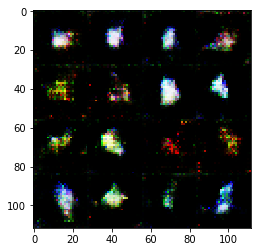

Epoch 4/10000... Discriminator Loss: 1.1405... Generator Loss: 0.8213


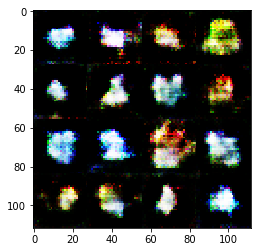

Epoch 4/10000... Discriminator Loss: 0.9934... Generator Loss: 2.9289


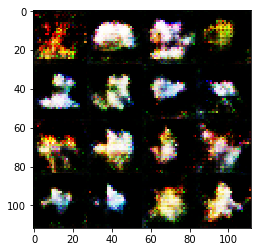

Epoch 4/10000... Discriminator Loss: 0.8544... Generator Loss: 1.4136


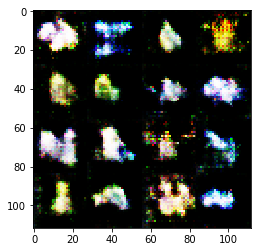

Epoch 4/10000... Discriminator Loss: 1.3342... Generator Loss: 0.8957


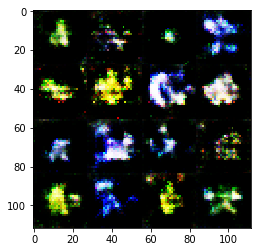

Epoch 4/10000... Discriminator Loss: 1.6421... Generator Loss: 0.5273


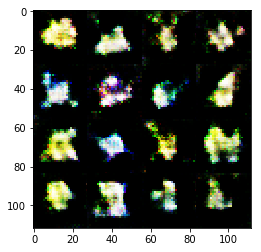

Epoch 4/10000... Discriminator Loss: 1.2238... Generator Loss: 0.7578


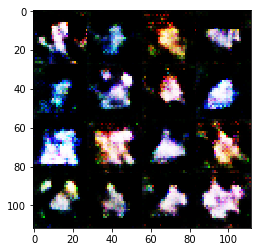

Epoch 4/10000... Discriminator Loss: 1.4644... Generator Loss: 0.8761


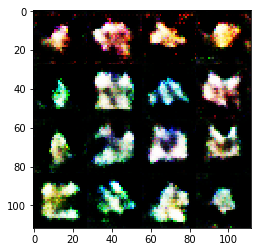

Epoch 4/10000... Discriminator Loss: 1.0702... Generator Loss: 1.3917


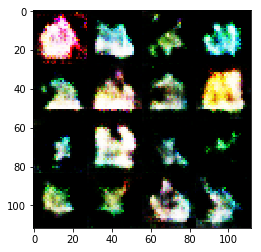

Epoch 4/10000... Discriminator Loss: 1.2912... Generator Loss: 0.8821


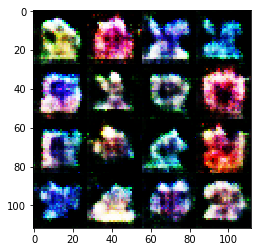

Epoch 4/10000... Discriminator Loss: 1.1268... Generator Loss: 1.1337


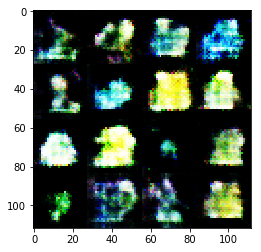

Epoch 4/10000... Discriminator Loss: 1.2143... Generator Loss: 1.2097


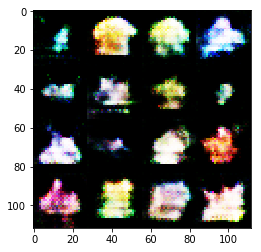

Epoch 4/10000... Discriminator Loss: 1.2925... Generator Loss: 1.4739


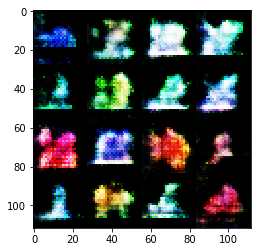

Epoch 4/10000... Discriminator Loss: 0.7545... Generator Loss: 1.7367


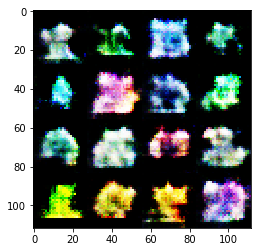

Epoch 4/10000... Discriminator Loss: 2.0720... Generator Loss: 1.6700


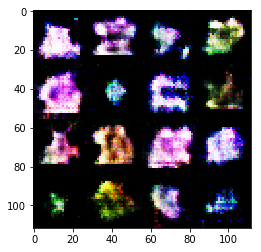

Epoch 4/10000... Discriminator Loss: 1.4812... Generator Loss: 0.7166


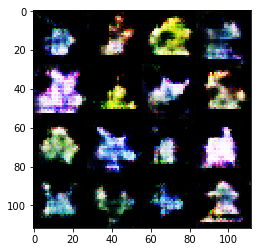

Epoch 4/10000... Discriminator Loss: 1.0833... Generator Loss: 1.7276


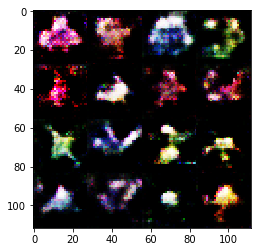

Epoch 4/10000... Discriminator Loss: 1.0228... Generator Loss: 1.1335


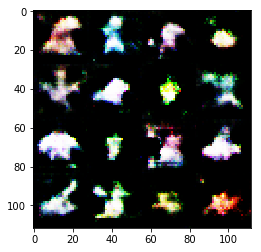

Epoch 4/10000... Discriminator Loss: 1.3739... Generator Loss: 0.7922


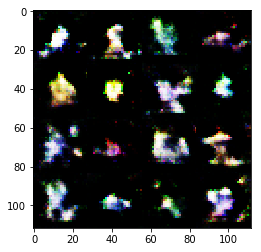

Epoch 4/10000... Discriminator Loss: 1.1815... Generator Loss: 1.3793


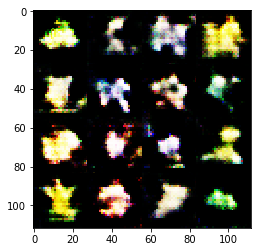

Epoch 4/10000... Discriminator Loss: 1.5590... Generator Loss: 0.5574


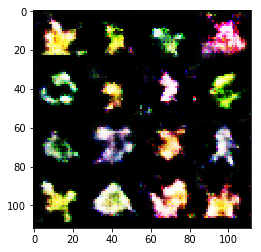

Epoch 4/10000... Discriminator Loss: 1.5783... Generator Loss: 0.4044


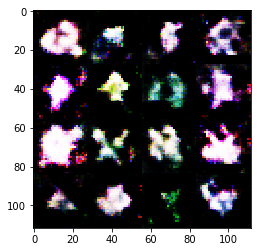

Epoch 4/10000... Discriminator Loss: 0.7071... Generator Loss: 1.7314


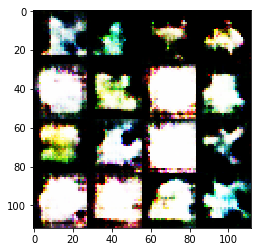

Epoch 4/10000... Discriminator Loss: 0.3693... Generator Loss: 3.7188


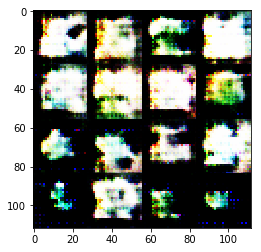

Epoch 4/10000... Discriminator Loss: 0.7277... Generator Loss: 1.6054


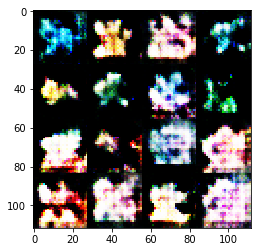

Epoch 4/10000... Discriminator Loss: 0.7844... Generator Loss: 1.6564


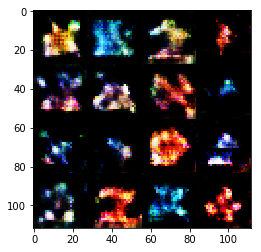

Epoch 4/10000... Discriminator Loss: 0.7901... Generator Loss: 1.7559


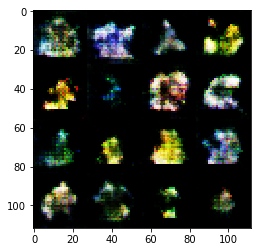

Epoch 4/10000... Discriminator Loss: 1.2623... Generator Loss: 0.9037


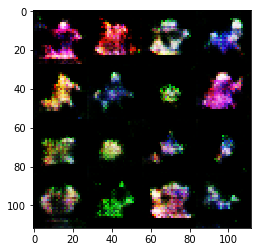

Epoch 4/10000... Discriminator Loss: 1.1262... Generator Loss: 1.2423


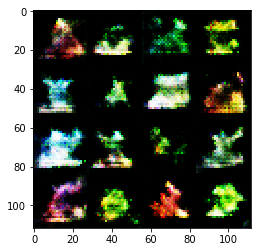

Epoch 4/10000... Discriminator Loss: 1.5892... Generator Loss: 0.4108


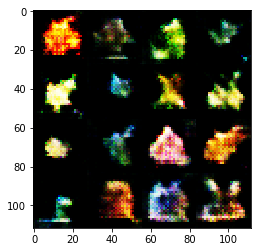

Epoch 4/10000... Discriminator Loss: 1.0549... Generator Loss: 1.0929


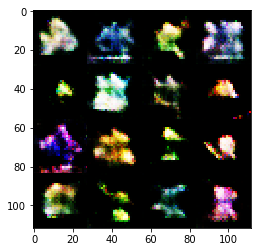

Epoch 4/10000... Discriminator Loss: 1.3801... Generator Loss: 0.7178


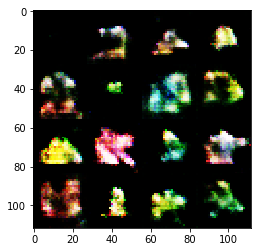

Epoch 4/10000... Discriminator Loss: 0.3998... Generator Loss: 3.5757


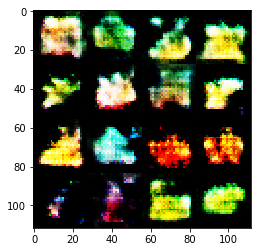

Epoch 4/10000... Discriminator Loss: 0.3731... Generator Loss: 3.7963


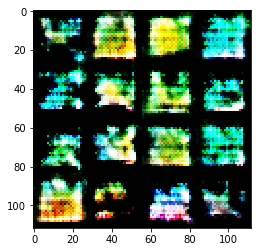

Epoch 4/10000... Discriminator Loss: 0.4304... Generator Loss: 3.1693


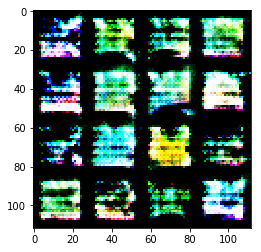

Epoch 4/10000... Discriminator Loss: 0.3657... Generator Loss: 5.1469


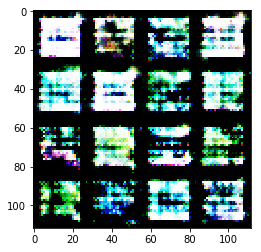

Epoch 4/10000... Discriminator Loss: 0.3828... Generator Loss: 5.1077


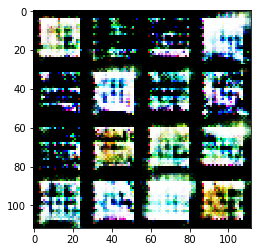

Epoch 4/10000... Discriminator Loss: 0.3556... Generator Loss: 4.3900


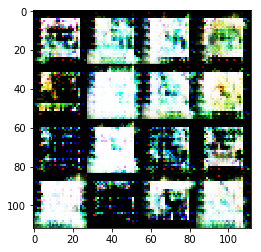

Epoch 4/10000... Discriminator Loss: 0.4324... Generator Loss: 3.3991


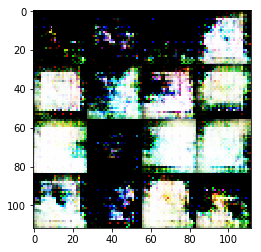

Epoch 5/10000... Discriminator Loss: 0.4107... Generator Loss: 3.3694


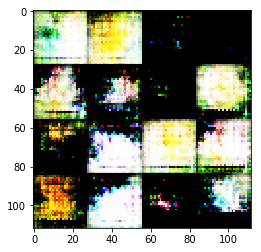

Epoch 5/10000... Discriminator Loss: 0.4692... Generator Loss: 2.8138


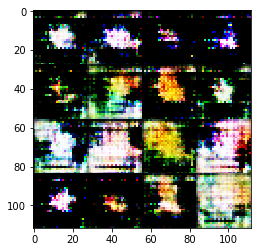

Epoch 5/10000... Discriminator Loss: 0.4405... Generator Loss: 2.9812


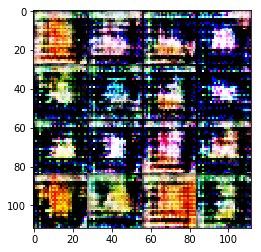

Epoch 5/10000... Discriminator Loss: 0.4695... Generator Loss: 2.6493


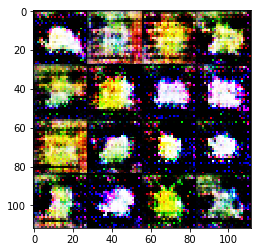

Epoch 5/10000... Discriminator Loss: 1.7384... Generator Loss: 0.3757


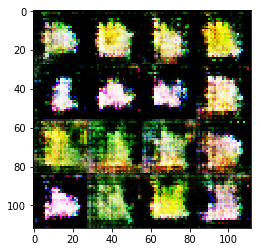

Epoch 5/10000... Discriminator Loss: 1.0904... Generator Loss: 2.0328


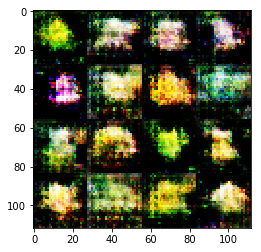

Epoch 5/10000... Discriminator Loss: 0.9680... Generator Loss: 0.8836


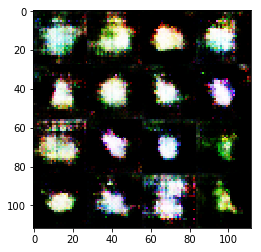

Epoch 5/10000... Discriminator Loss: 0.8824... Generator Loss: 1.6087


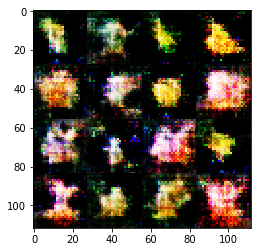

Epoch 5/10000... Discriminator Loss: 0.9958... Generator Loss: 1.8473


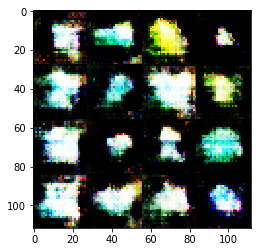

Epoch 5/10000... Discriminator Loss: 1.6692... Generator Loss: 0.4351


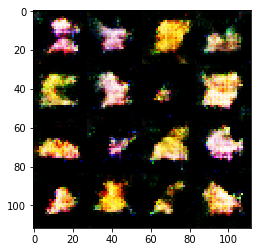

Epoch 5/10000... Discriminator Loss: 1.2175... Generator Loss: 1.8329


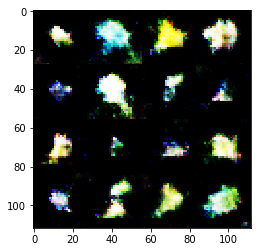

Epoch 5/10000... Discriminator Loss: 1.4052... Generator Loss: 1.5978


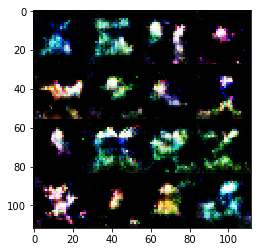

Epoch 5/10000... Discriminator Loss: 2.2396... Generator Loss: 0.2562


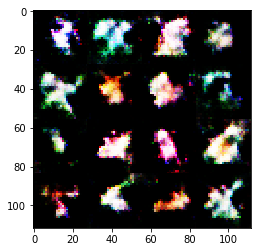

Epoch 5/10000... Discriminator Loss: 0.9954... Generator Loss: 1.7189


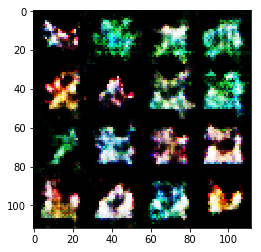

Epoch 5/10000... Discriminator Loss: 1.1629... Generator Loss: 1.2880


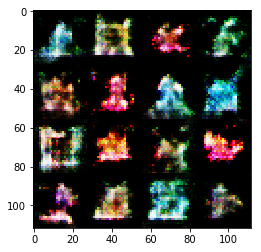

Epoch 5/10000... Discriminator Loss: 1.3559... Generator Loss: 1.2868


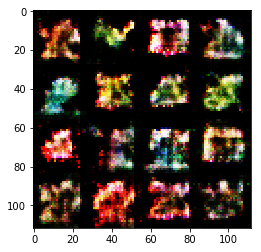

Epoch 5/10000... Discriminator Loss: 1.0502... Generator Loss: 1.3531


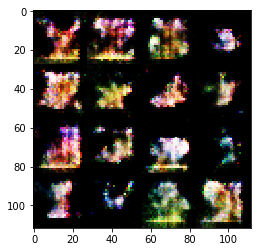

Epoch 5/10000... Discriminator Loss: 1.7063... Generator Loss: 1.2007


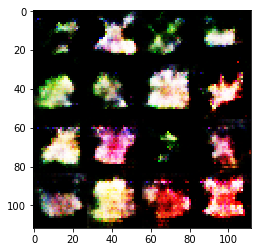

Epoch 5/10000... Discriminator Loss: 0.9740... Generator Loss: 1.6304


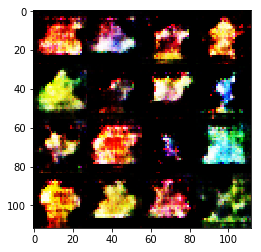

Epoch 5/10000... Discriminator Loss: 1.1737... Generator Loss: 2.5110


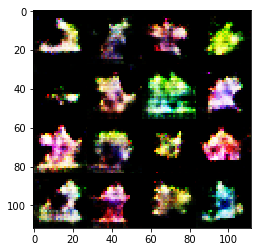

Epoch 5/10000... Discriminator Loss: 1.0605... Generator Loss: 1.8784


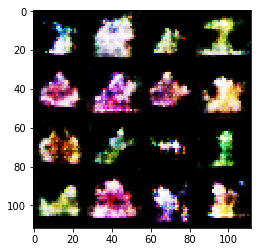

Epoch 5/10000... Discriminator Loss: 1.2980... Generator Loss: 0.8379


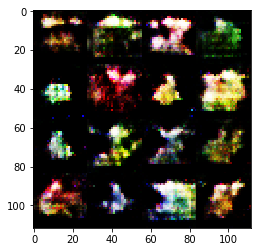

Epoch 5/10000... Discriminator Loss: 1.7255... Generator Loss: 2.7032


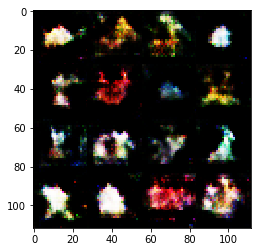

Epoch 5/10000... Discriminator Loss: 1.4446... Generator Loss: 0.5056


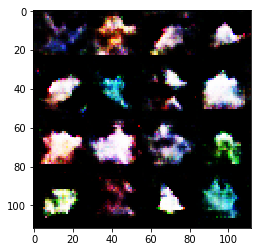

Epoch 5/10000... Discriminator Loss: 0.9317... Generator Loss: 1.4127


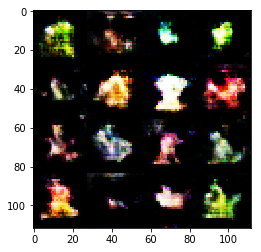

Epoch 5/10000... Discriminator Loss: 1.4171... Generator Loss: 2.2507


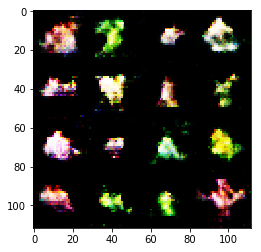

Epoch 5/10000... Discriminator Loss: 1.4993... Generator Loss: 1.1689


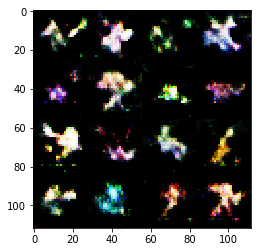

Epoch 5/10000... Discriminator Loss: 0.8911... Generator Loss: 1.6917


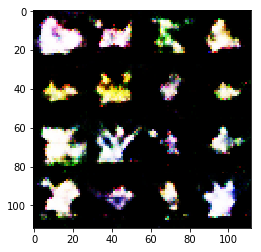

Epoch 5/10000... Discriminator Loss: 0.4146... Generator Loss: 4.5613


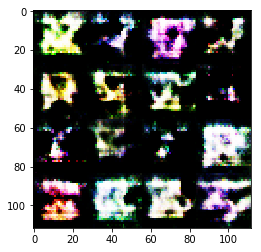

Epoch 5/10000... Discriminator Loss: 0.4077... Generator Loss: 2.9900


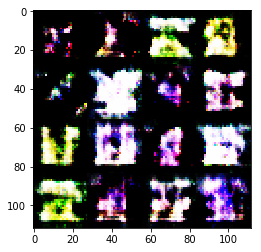

Epoch 5/10000... Discriminator Loss: 0.8584... Generator Loss: 1.0992


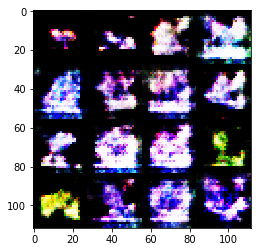

Epoch 5/10000... Discriminator Loss: 1.1589... Generator Loss: 0.8763


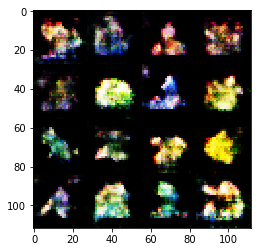

Epoch 5/10000... Discriminator Loss: 1.5016... Generator Loss: 1.6775


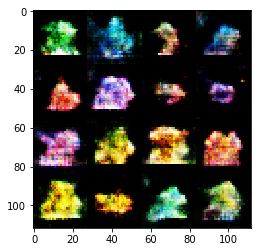

Epoch 5/10000... Discriminator Loss: 1.1099... Generator Loss: 1.2619


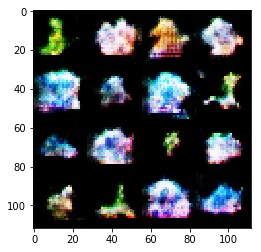

Epoch 5/10000... Discriminator Loss: 1.4017... Generator Loss: 0.6303


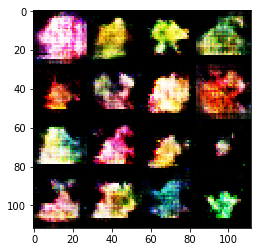

Epoch 5/10000... Discriminator Loss: 1.3584... Generator Loss: 1.1924


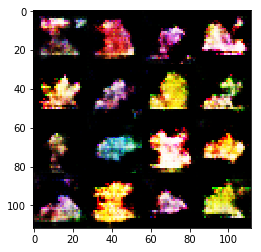

Epoch 5/10000... Discriminator Loss: 0.8496... Generator Loss: 1.5822


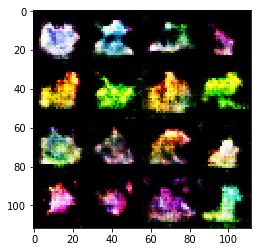

Epoch 5/10000... Discriminator Loss: 1.1328... Generator Loss: 0.8521


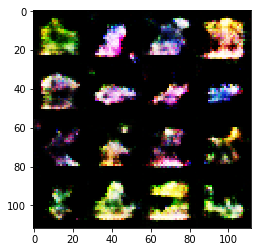

Epoch 5/10000... Discriminator Loss: 0.4107... Generator Loss: 3.4148


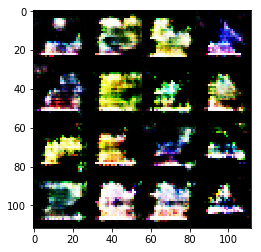

Epoch 5/10000... Discriminator Loss: 0.3781... Generator Loss: 3.7026


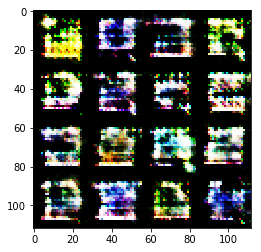

Epoch 5/10000... Discriminator Loss: 0.3751... Generator Loss: 4.3839


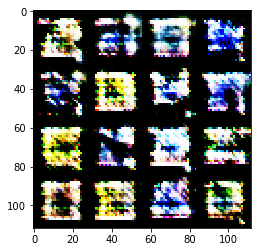

Epoch 5/10000... Discriminator Loss: 0.3772... Generator Loss: 3.7607


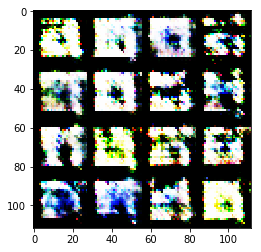

Epoch 5/10000... Discriminator Loss: 0.3764... Generator Loss: 3.5269


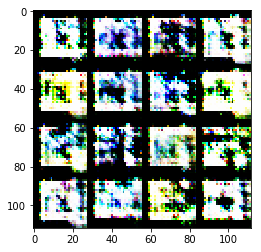

Epoch 5/10000... Discriminator Loss: 0.3847... Generator Loss: 3.3105


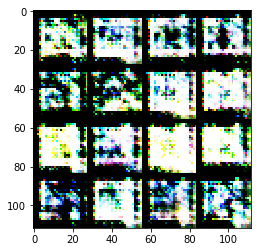

Epoch 5/10000... Discriminator Loss: 0.3586... Generator Loss: 5.1236


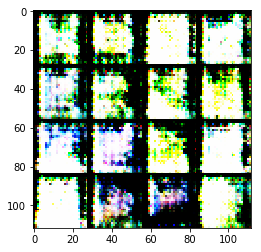

Epoch 6/10000... Discriminator Loss: 0.5212... Generator Loss: 2.4044


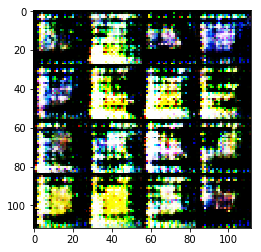

Epoch 6/10000... Discriminator Loss: 0.5563... Generator Loss: 2.0159


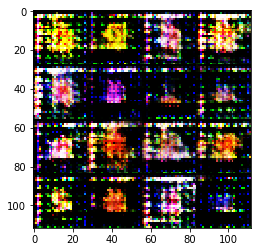

Epoch 6/10000... Discriminator Loss: 0.5386... Generator Loss: 2.3417


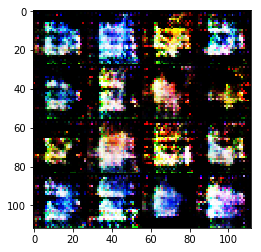

Epoch 6/10000... Discriminator Loss: 1.8722... Generator Loss: 0.2846


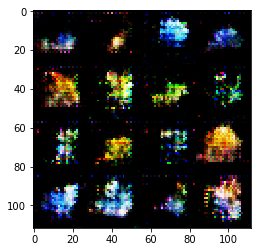

Epoch 6/10000... Discriminator Loss: 1.4717... Generator Loss: 0.6416


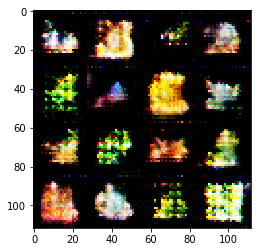

Epoch 6/10000... Discriminator Loss: 1.4355... Generator Loss: 3.3389


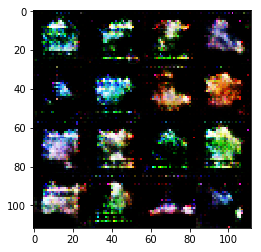

Epoch 6/10000... Discriminator Loss: 1.8476... Generator Loss: 2.5078


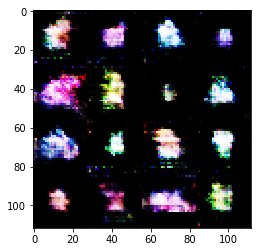

Epoch 6/10000... Discriminator Loss: 1.5325... Generator Loss: 0.5247


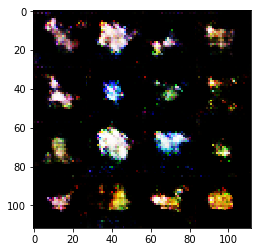

Epoch 6/10000... Discriminator Loss: 1.1675... Generator Loss: 1.4653


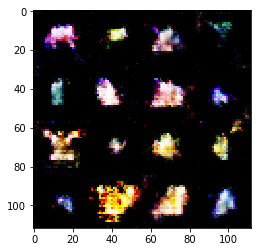

Epoch 6/10000... Discriminator Loss: 0.9258... Generator Loss: 1.1655


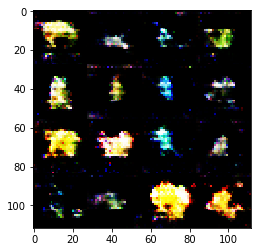

Epoch 6/10000... Discriminator Loss: 1.2375... Generator Loss: 0.8549


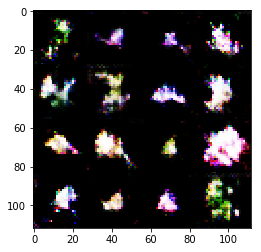

Epoch 6/10000... Discriminator Loss: 1.1300... Generator Loss: 1.0728


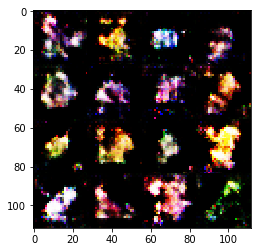

Epoch 6/10000... Discriminator Loss: 1.8257... Generator Loss: 0.3698


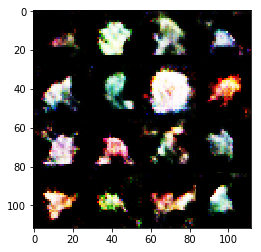

Epoch 6/10000... Discriminator Loss: 1.6769... Generator Loss: 2.5857


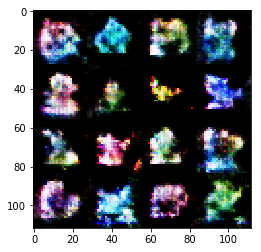

Epoch 6/10000... Discriminator Loss: 1.1965... Generator Loss: 0.8804


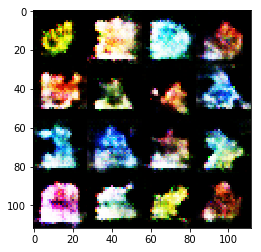

Epoch 6/10000... Discriminator Loss: 1.0559... Generator Loss: 1.3090


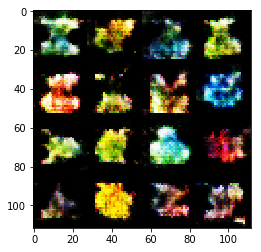

Epoch 6/10000... Discriminator Loss: 1.0633... Generator Loss: 1.3549


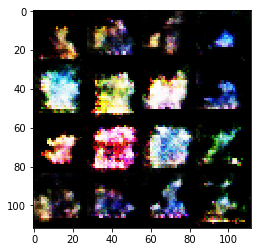

Epoch 6/10000... Discriminator Loss: 1.0281... Generator Loss: 1.0416


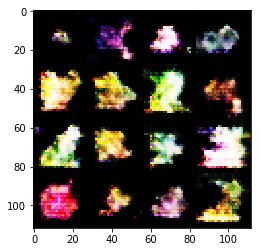

Epoch 6/10000... Discriminator Loss: 1.1598... Generator Loss: 0.6972


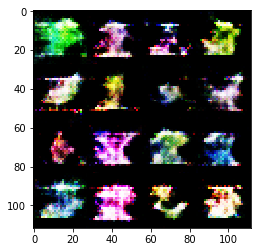

Epoch 6/10000... Discriminator Loss: 0.8163... Generator Loss: 1.5889


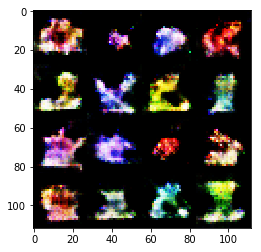

Epoch 6/10000... Discriminator Loss: 1.0620... Generator Loss: 1.4074


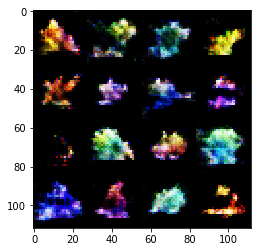

Epoch 6/10000... Discriminator Loss: 1.2219... Generator Loss: 0.9068


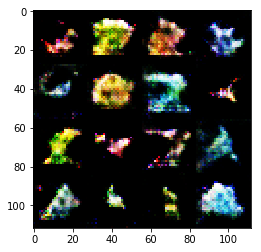

Epoch 6/10000... Discriminator Loss: 0.7944... Generator Loss: 1.4934


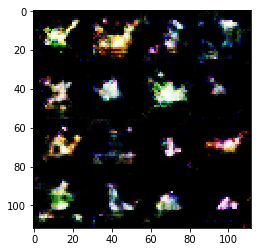

Epoch 6/10000... Discriminator Loss: 1.9944... Generator Loss: 0.2316


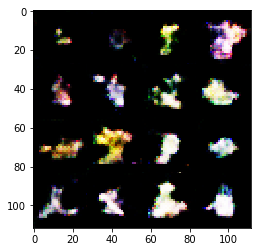

Epoch 6/10000... Discriminator Loss: 0.9062... Generator Loss: 1.3378


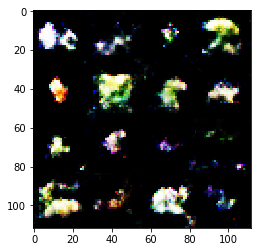

Epoch 6/10000... Discriminator Loss: 1.1677... Generator Loss: 0.7945


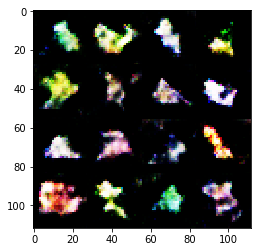

Epoch 6/10000... Discriminator Loss: 1.1485... Generator Loss: 1.4165


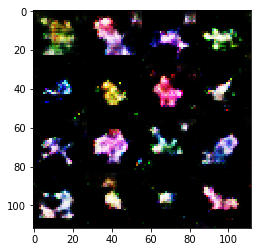

Epoch 6/10000... Discriminator Loss: 1.1755... Generator Loss: 0.7505


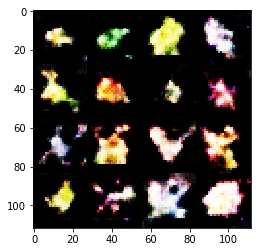

Epoch 6/10000... Discriminator Loss: 0.3594... Generator Loss: 4.6238


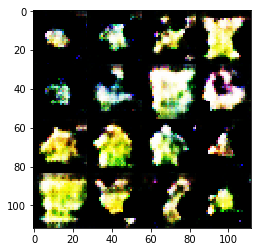

Epoch 6/10000... Discriminator Loss: 0.4115... Generator Loss: 3.2487


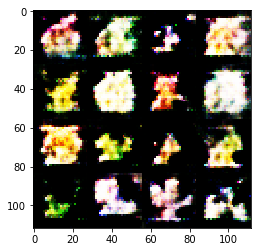

Epoch 6/10000... Discriminator Loss: 0.6770... Generator Loss: 1.9803


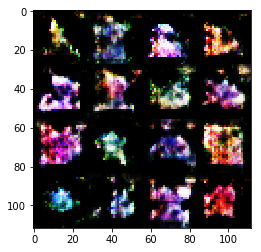

Epoch 6/10000... Discriminator Loss: 1.7288... Generator Loss: 0.4503


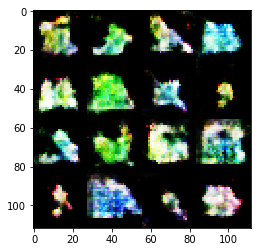

Epoch 6/10000... Discriminator Loss: 1.1439... Generator Loss: 0.8364


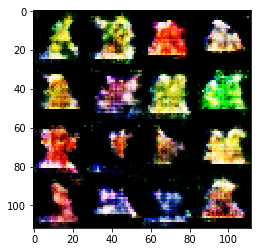

Epoch 6/10000... Discriminator Loss: 1.4057... Generator Loss: 0.7167


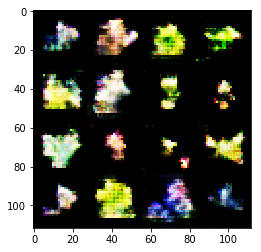

Epoch 6/10000... Discriminator Loss: 0.9970... Generator Loss: 1.3160


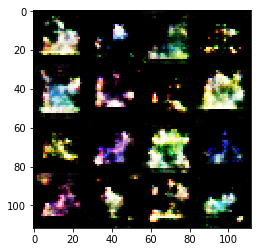

Epoch 6/10000... Discriminator Loss: 0.8638... Generator Loss: 1.3066


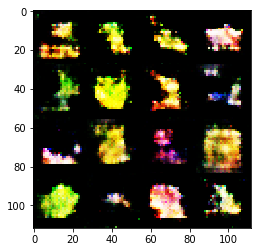

Epoch 6/10000... Discriminator Loss: 0.9858... Generator Loss: 0.8779


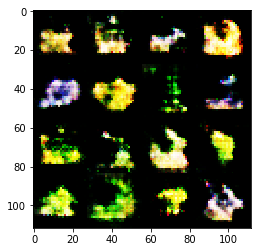

Epoch 6/10000... Discriminator Loss: 1.3633... Generator Loss: 0.9612


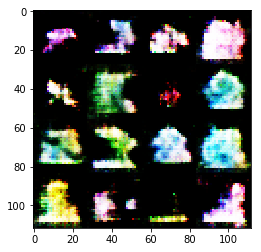

Epoch 6/10000... Discriminator Loss: 0.3790... Generator Loss: 4.3007


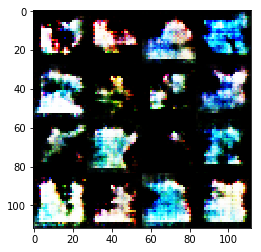

Epoch 6/10000... Discriminator Loss: 0.3800... Generator Loss: 3.6493


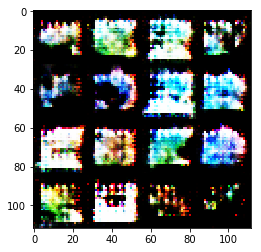

Epoch 6/10000... Discriminator Loss: 0.3649... Generator Loss: 4.0065


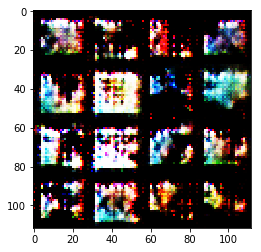

Epoch 6/10000... Discriminator Loss: 0.3793... Generator Loss: 3.5820


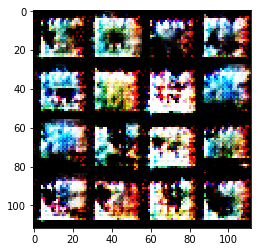

Epoch 6/10000... Discriminator Loss: 0.3655... Generator Loss: 4.1791


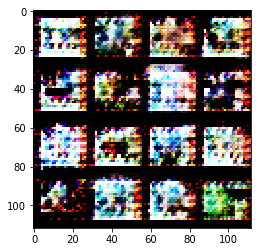

Epoch 6/10000... Discriminator Loss: 0.3708... Generator Loss: 4.1607


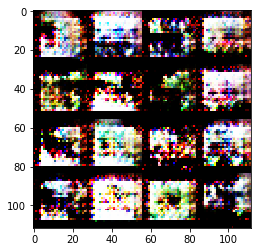

Epoch 7/10000... Discriminator Loss: 1.2038... Generator Loss: 0.8433


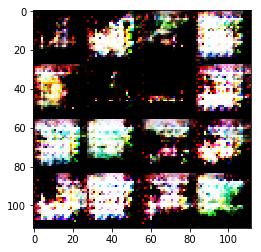

Epoch 7/10000... Discriminator Loss: 0.4877... Generator Loss: 2.5026


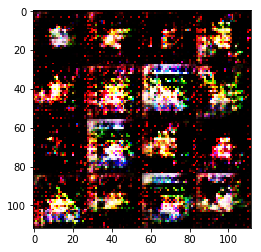

Epoch 7/10000... Discriminator Loss: 0.4216... Generator Loss: 3.5158


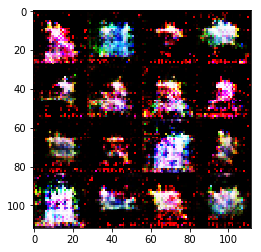

Epoch 7/10000... Discriminator Loss: 0.6854... Generator Loss: 1.5185


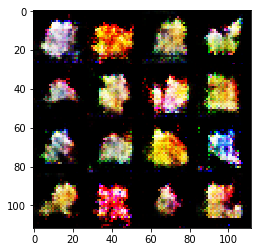

Epoch 7/10000... Discriminator Loss: 1.4118... Generator Loss: 0.6339


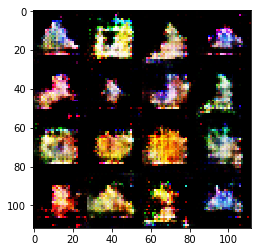

Epoch 7/10000... Discriminator Loss: 0.9823... Generator Loss: 1.4300


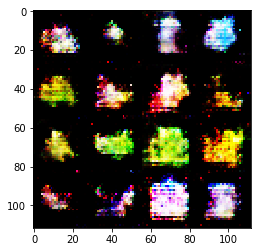

Epoch 7/10000... Discriminator Loss: 1.0031... Generator Loss: 0.9312


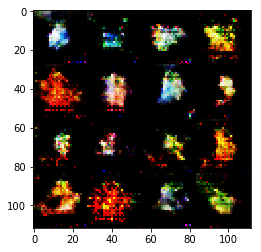

Epoch 7/10000... Discriminator Loss: 0.8064... Generator Loss: 1.5717


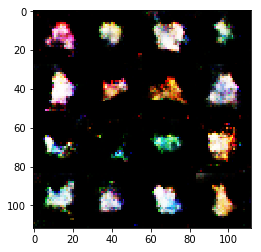

Epoch 7/10000... Discriminator Loss: 1.1764... Generator Loss: 0.8276


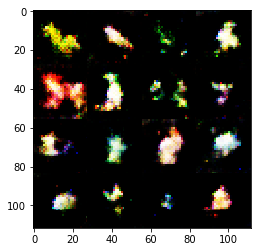

Epoch 7/10000... Discriminator Loss: 0.9984... Generator Loss: 1.0785


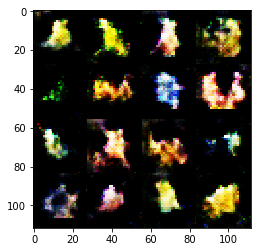

Epoch 7/10000... Discriminator Loss: 1.2526... Generator Loss: 1.1854


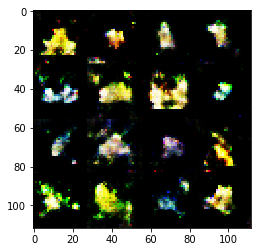

Epoch 7/10000... Discriminator Loss: 1.2257... Generator Loss: 1.1725


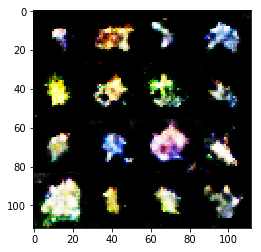

Epoch 7/10000... Discriminator Loss: 1.1520... Generator Loss: 1.3944


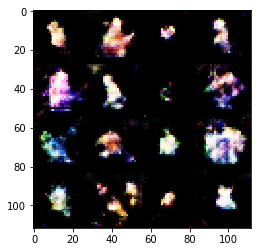

Epoch 7/10000... Discriminator Loss: 1.2946... Generator Loss: 0.6382


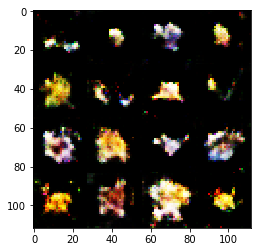

Epoch 7/10000... Discriminator Loss: 1.0671... Generator Loss: 0.9710


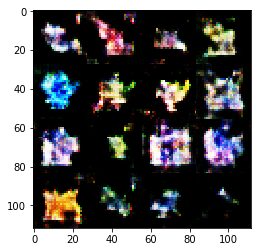

Epoch 7/10000... Discriminator Loss: 1.3529... Generator Loss: 0.5917


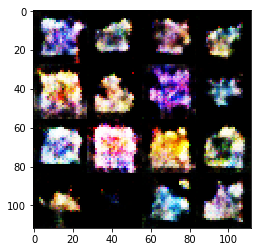

Epoch 7/10000... Discriminator Loss: 1.2324... Generator Loss: 1.9633


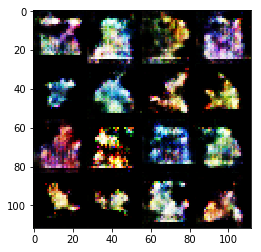

Epoch 7/10000... Discriminator Loss: 0.9825... Generator Loss: 1.2442


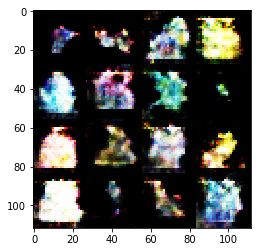

Epoch 7/10000... Discriminator Loss: 1.0517... Generator Loss: 0.8406


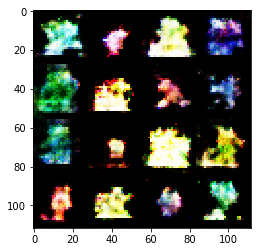

Epoch 7/10000... Discriminator Loss: 1.2333... Generator Loss: 0.8252


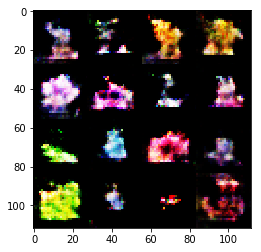

Epoch 7/10000... Discriminator Loss: 0.9465... Generator Loss: 1.7384


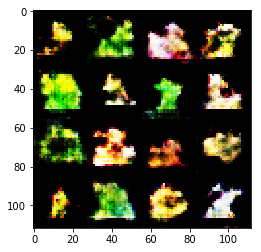

Epoch 7/10000... Discriminator Loss: 1.0743... Generator Loss: 1.4504


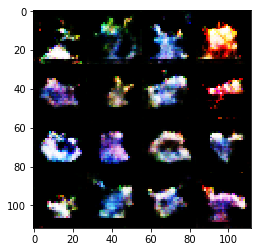

Epoch 7/10000... Discriminator Loss: 1.3313... Generator Loss: 1.1173


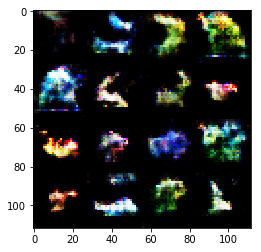

Epoch 7/10000... Discriminator Loss: 1.2599... Generator Loss: 0.6492


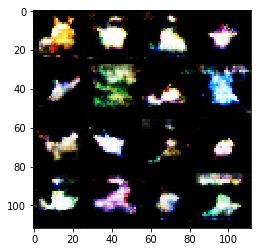

Epoch 7/10000... Discriminator Loss: 1.0803... Generator Loss: 1.7528


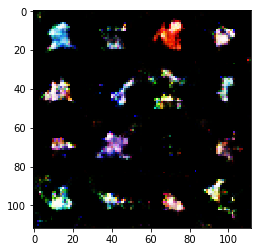

Epoch 7/10000... Discriminator Loss: 1.3592... Generator Loss: 0.5132


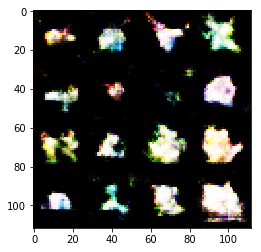

Epoch 7/10000... Discriminator Loss: 1.2369... Generator Loss: 0.7636


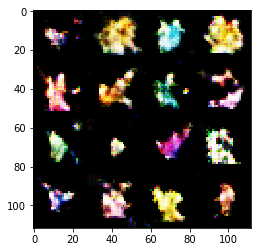

Epoch 7/10000... Discriminator Loss: 0.9033... Generator Loss: 1.2569


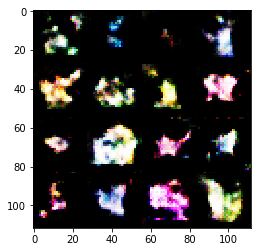

Epoch 7/10000... Discriminator Loss: 1.3173... Generator Loss: 0.7071


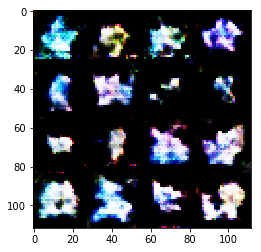

Epoch 7/10000... Discriminator Loss: 0.3997... Generator Loss: 4.4889


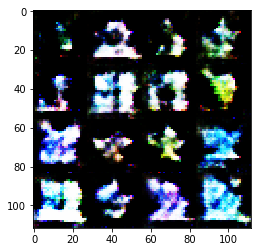

Epoch 7/10000... Discriminator Loss: 0.3812... Generator Loss: 3.8856


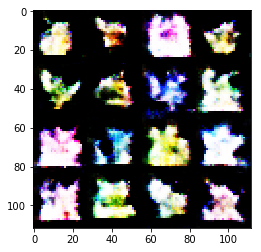

Epoch 7/10000... Discriminator Loss: 0.6975... Generator Loss: 1.7029


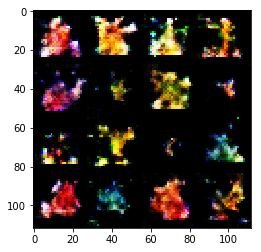

Epoch 7/10000... Discriminator Loss: 0.8707... Generator Loss: 1.7139


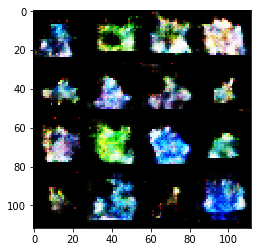

Epoch 7/10000... Discriminator Loss: 0.9401... Generator Loss: 1.4965


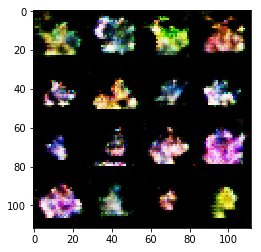

Epoch 7/10000... Discriminator Loss: 0.6581... Generator Loss: 2.9581


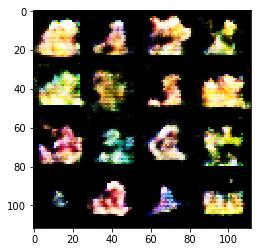

Epoch 7/10000... Discriminator Loss: 1.0682... Generator Loss: 1.1356


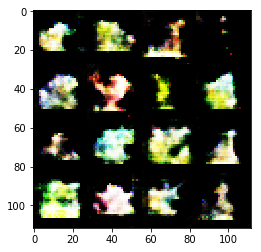

Epoch 7/10000... Discriminator Loss: 0.9076... Generator Loss: 1.3823


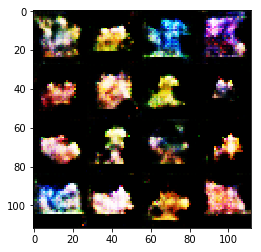

Epoch 7/10000... Discriminator Loss: 0.9682... Generator Loss: 1.5376


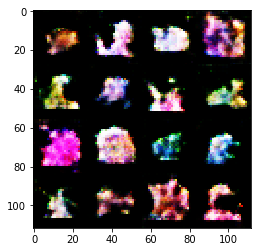

Epoch 7/10000... Discriminator Loss: 0.7793... Generator Loss: 1.9507


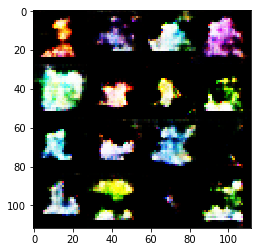

Epoch 7/10000... Discriminator Loss: 0.3672... Generator Loss: 4.2105


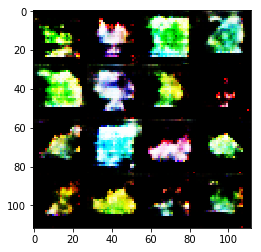

Epoch 7/10000... Discriminator Loss: 0.3829... Generator Loss: 3.5147


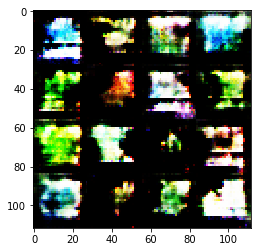

Epoch 7/10000... Discriminator Loss: 0.3960... Generator Loss: 3.9198


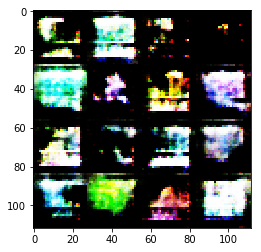

Epoch 7/10000... Discriminator Loss: 0.3679... Generator Loss: 4.2503


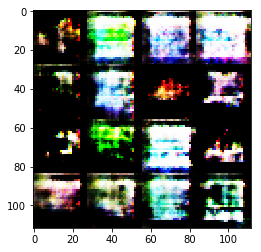

Epoch 7/10000... Discriminator Loss: 0.3590... Generator Loss: 4.3944


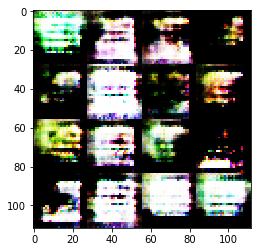

Epoch 7/10000... Discriminator Loss: 0.4017... Generator Loss: 3.4979


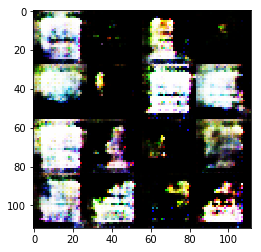

Epoch 8/10000... Discriminator Loss: 0.4193... Generator Loss: 3.9117


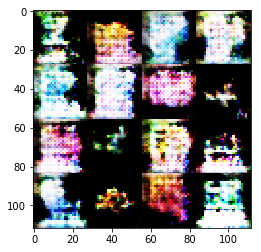

Epoch 8/10000... Discriminator Loss: 0.4671... Generator Loss: 2.8006


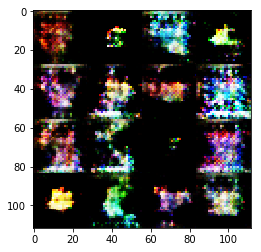

Epoch 8/10000... Discriminator Loss: 0.9157... Generator Loss: 1.4748


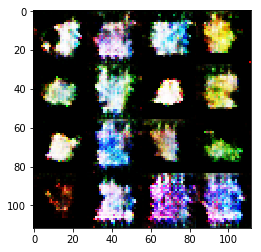

Epoch 8/10000... Discriminator Loss: 0.9886... Generator Loss: 1.7099


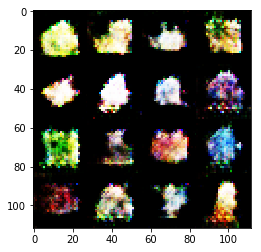

Epoch 8/10000... Discriminator Loss: 0.9334... Generator Loss: 1.4838


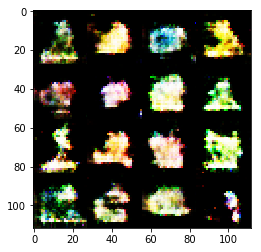

Epoch 8/10000... Discriminator Loss: 0.8310... Generator Loss: 1.5930


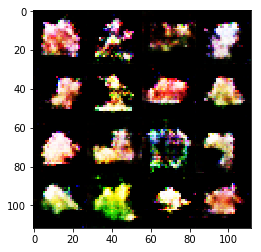

Epoch 8/10000... Discriminator Loss: 1.0394... Generator Loss: 1.4174


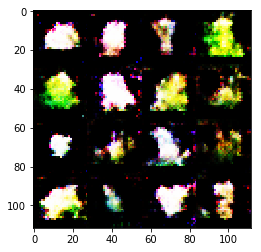

Epoch 8/10000... Discriminator Loss: 1.0946... Generator Loss: 1.1331


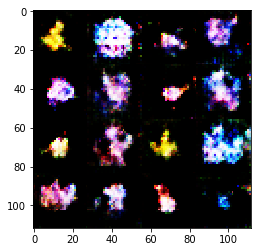

Epoch 8/10000... Discriminator Loss: 1.1398... Generator Loss: 0.8347


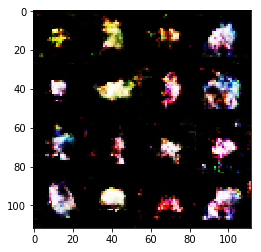

Epoch 8/10000... Discriminator Loss: 1.1683... Generator Loss: 2.2996


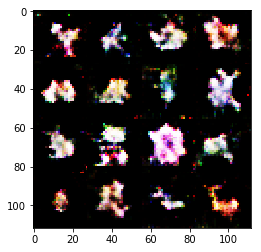

Epoch 8/10000... Discriminator Loss: 1.1761... Generator Loss: 0.9351


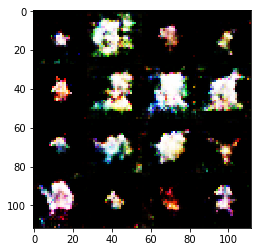

Epoch 8/10000... Discriminator Loss: 1.7696... Generator Loss: 2.3221


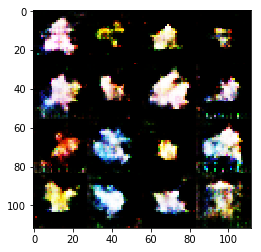

Epoch 8/10000... Discriminator Loss: 1.5246... Generator Loss: 0.5345


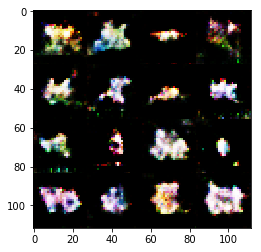

Epoch 8/10000... Discriminator Loss: 1.3108... Generator Loss: 0.9105


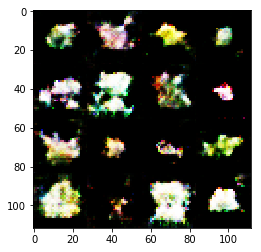

Epoch 8/10000... Discriminator Loss: 1.3581... Generator Loss: 0.5984


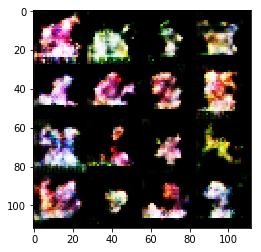

Epoch 8/10000... Discriminator Loss: 0.8082... Generator Loss: 2.0810


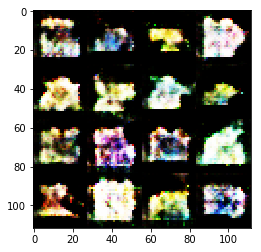

Epoch 8/10000... Discriminator Loss: 1.3423... Generator Loss: 1.9594


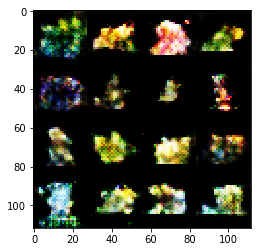

Epoch 8/10000... Discriminator Loss: 0.7384... Generator Loss: 2.2916


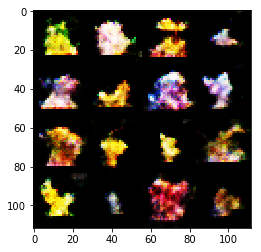

Epoch 8/10000... Discriminator Loss: 1.0390... Generator Loss: 1.1515


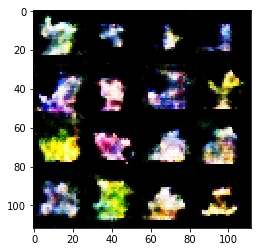

Epoch 8/10000... Discriminator Loss: 0.8191... Generator Loss: 1.4634


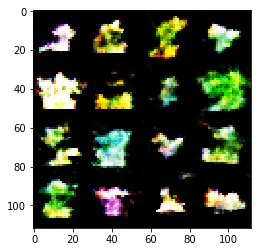

Epoch 8/10000... Discriminator Loss: 1.0090... Generator Loss: 0.8716


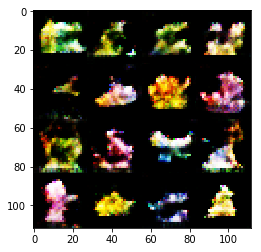

Epoch 8/10000... Discriminator Loss: 1.2065... Generator Loss: 0.9258


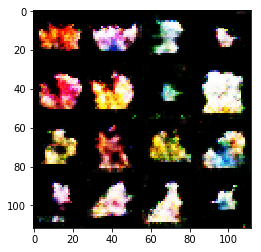

Epoch 8/10000... Discriminator Loss: 0.8617... Generator Loss: 1.5978


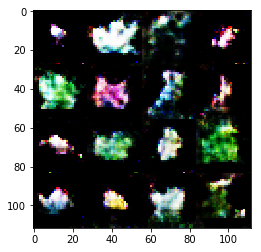

Epoch 8/10000... Discriminator Loss: 0.9652... Generator Loss: 1.0704


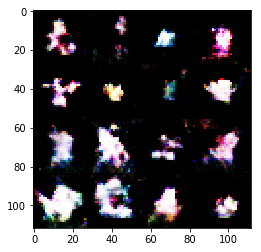

Epoch 8/10000... Discriminator Loss: 2.1299... Generator Loss: 0.2892


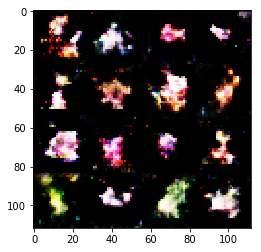

Epoch 8/10000... Discriminator Loss: 1.0846... Generator Loss: 1.6292


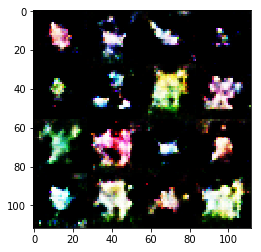

Epoch 8/10000... Discriminator Loss: 1.4584... Generator Loss: 0.5435


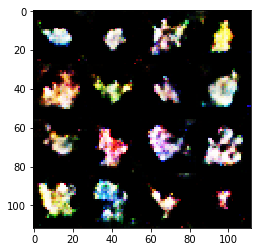

Epoch 8/10000... Discriminator Loss: 1.0956... Generator Loss: 1.2389


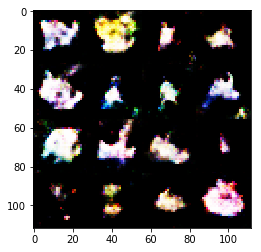

Epoch 8/10000... Discriminator Loss: 0.9448... Generator Loss: 1.1022


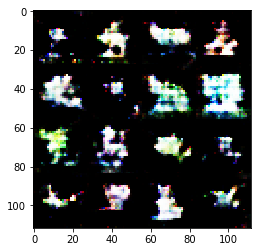

Epoch 8/10000... Discriminator Loss: 0.3813... Generator Loss: 4.2087


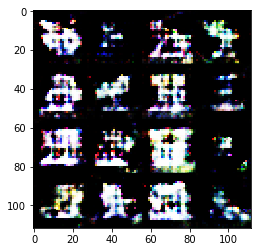

Epoch 8/10000... Discriminator Loss: 1.1890... Generator Loss: 0.8979


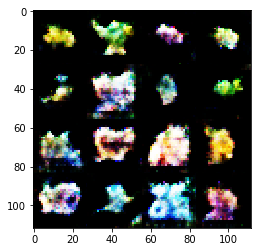

Epoch 8/10000... Discriminator Loss: 1.2701... Generator Loss: 0.9378


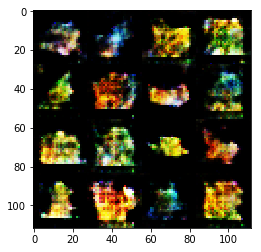

Epoch 8/10000... Discriminator Loss: 0.8980... Generator Loss: 1.3648


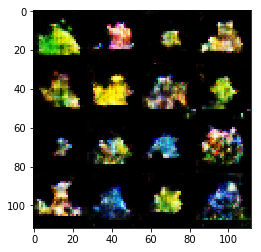

Epoch 8/10000... Discriminator Loss: 0.8437... Generator Loss: 1.6678


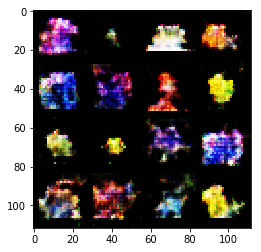

Epoch 8/10000... Discriminator Loss: 0.9720... Generator Loss: 1.1366


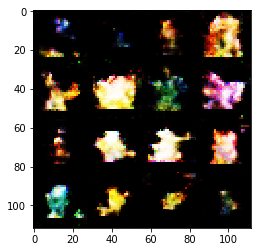

Epoch 8/10000... Discriminator Loss: 0.7269... Generator Loss: 1.9887


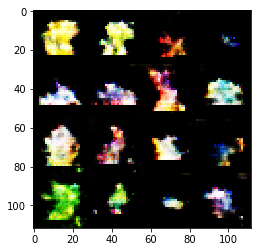

Epoch 8/10000... Discriminator Loss: 0.6381... Generator Loss: 2.9489


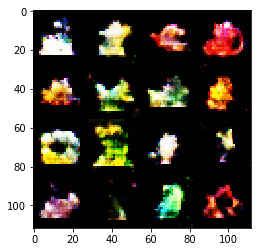

Epoch 8/10000... Discriminator Loss: 0.7958... Generator Loss: 1.3828


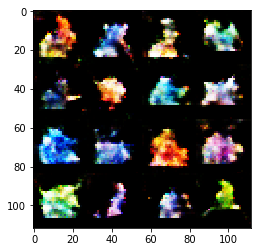

Epoch 8/10000... Discriminator Loss: 1.1323... Generator Loss: 0.7949


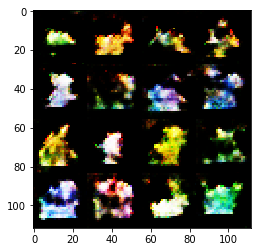

Epoch 8/10000... Discriminator Loss: 0.3550... Generator Loss: 4.9773


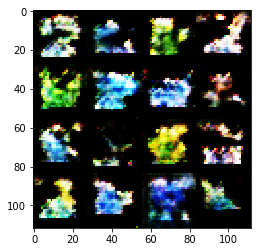

Epoch 8/10000... Discriminator Loss: 0.3762... Generator Loss: 4.1923


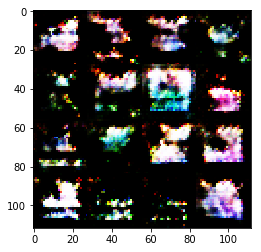

Epoch 8/10000... Discriminator Loss: 0.3700... Generator Loss: 4.0468


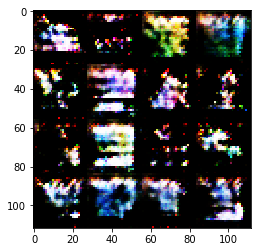

Epoch 8/10000... Discriminator Loss: 0.4017... Generator Loss: 3.7757


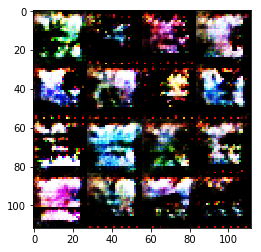

Epoch 8/10000... Discriminator Loss: 0.3534... Generator Loss: 4.5562


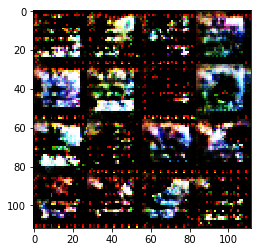

Epoch 8/10000... Discriminator Loss: 0.3459... Generator Loss: 4.6880


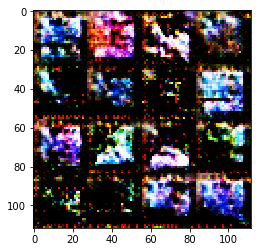

Epoch 9/10000... Discriminator Loss: 0.3962... Generator Loss: 4.5371


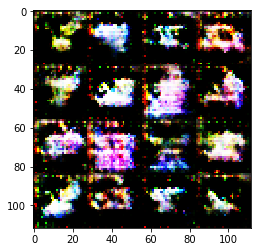

Epoch 9/10000... Discriminator Loss: 0.6353... Generator Loss: 1.6688


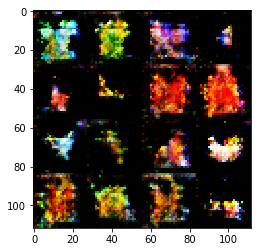

Epoch 9/10000... Discriminator Loss: 1.4458... Generator Loss: 3.8811


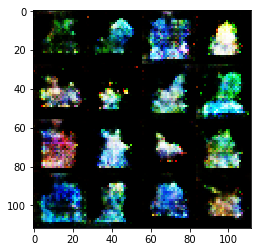

Epoch 9/10000... Discriminator Loss: 1.0338... Generator Loss: 2.1567


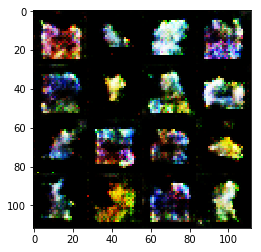

Epoch 9/10000... Discriminator Loss: 1.3197... Generator Loss: 2.3718


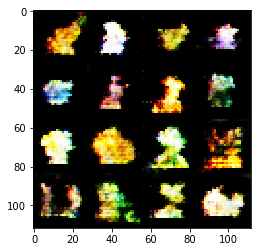

Epoch 9/10000... Discriminator Loss: 0.9625... Generator Loss: 1.2508


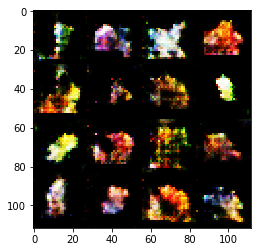

Epoch 9/10000... Discriminator Loss: 0.8507... Generator Loss: 1.9423


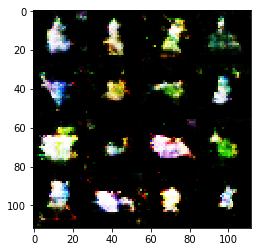

Epoch 9/10000... Discriminator Loss: 1.2614... Generator Loss: 0.6087


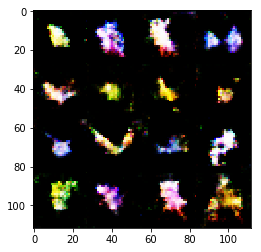

Epoch 9/10000... Discriminator Loss: 1.5776... Generator Loss: 0.4225


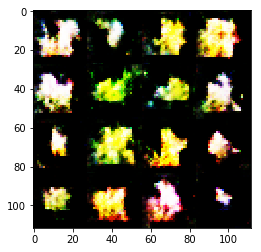

Epoch 9/10000... Discriminator Loss: 0.8192... Generator Loss: 1.7594


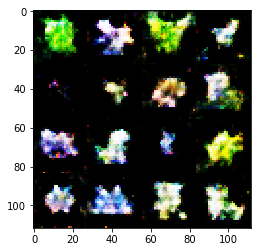

Epoch 9/10000... Discriminator Loss: 1.1248... Generator Loss: 1.2838


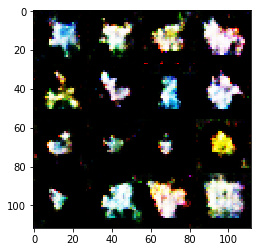

Epoch 9/10000... Discriminator Loss: 1.2750... Generator Loss: 1.0258


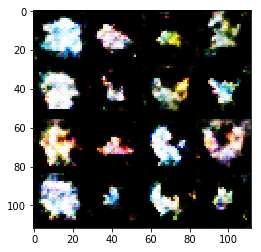

Epoch 9/10000... Discriminator Loss: 1.2424... Generator Loss: 2.8065


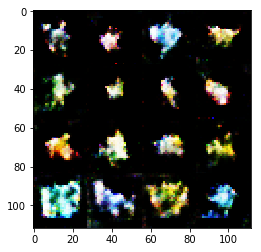

Epoch 9/10000... Discriminator Loss: 1.2718... Generator Loss: 0.8913


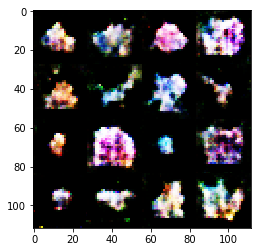

Epoch 9/10000... Discriminator Loss: 0.7007... Generator Loss: 1.8847


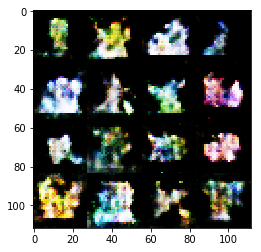

Epoch 9/10000... Discriminator Loss: 0.9200... Generator Loss: 1.2675


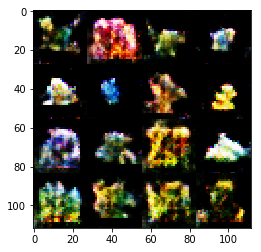

Epoch 9/10000... Discriminator Loss: 1.4648... Generator Loss: 0.5358


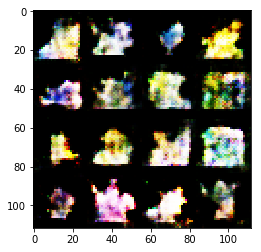

Epoch 9/10000... Discriminator Loss: 1.4552... Generator Loss: 0.7587


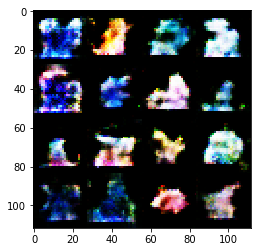

Epoch 9/10000... Discriminator Loss: 0.8884... Generator Loss: 1.5851


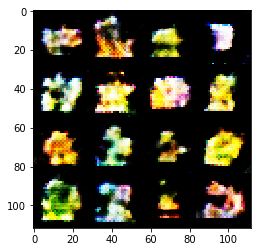

Epoch 9/10000... Discriminator Loss: 0.5420... Generator Loss: 2.7983


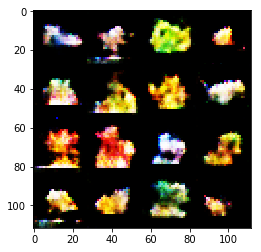

Epoch 9/10000... Discriminator Loss: 1.1817... Generator Loss: 0.9714


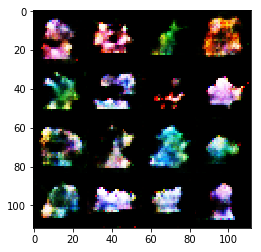

Epoch 9/10000... Discriminator Loss: 1.2206... Generator Loss: 0.8226


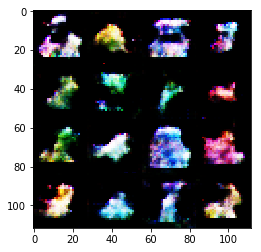

Epoch 9/10000... Discriminator Loss: 0.7753... Generator Loss: 1.4722


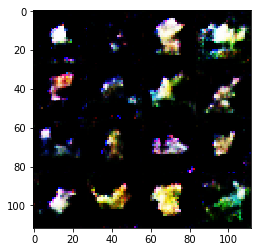

Epoch 9/10000... Discriminator Loss: 1.0799... Generator Loss: 1.3260


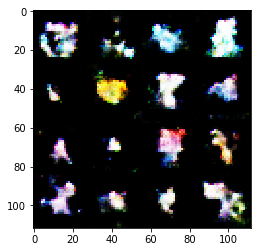

Epoch 9/10000... Discriminator Loss: 1.0919... Generator Loss: 1.2538


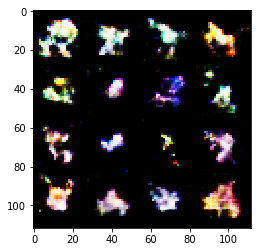

Epoch 9/10000... Discriminator Loss: 1.0769... Generator Loss: 1.1301


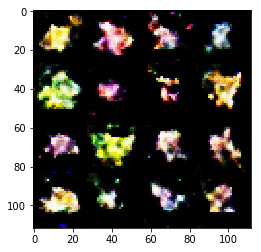

Epoch 9/10000... Discriminator Loss: 1.2998... Generator Loss: 0.7383


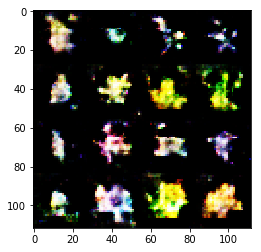

Epoch 9/10000... Discriminator Loss: 1.1778... Generator Loss: 0.7497


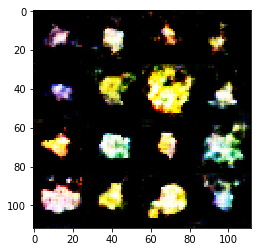

Epoch 9/10000... Discriminator Loss: 0.5611... Generator Loss: 1.7443


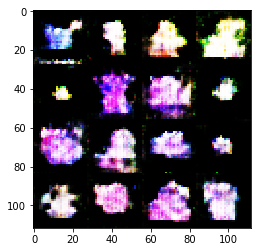

Epoch 9/10000... Discriminator Loss: 0.3793... Generator Loss: 3.7972


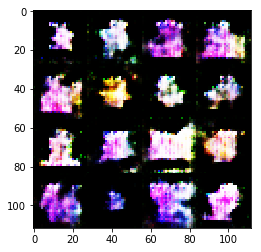

Epoch 9/10000... Discriminator Loss: 0.7293... Generator Loss: 3.0117


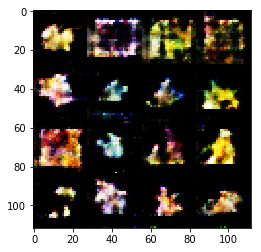

Epoch 9/10000... Discriminator Loss: 0.9541... Generator Loss: 1.2619


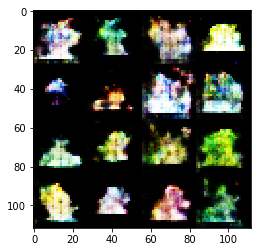

Epoch 9/10000... Discriminator Loss: 0.9902... Generator Loss: 1.1702


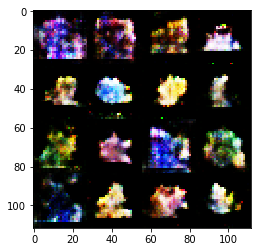

Epoch 9/10000... Discriminator Loss: 0.8876... Generator Loss: 1.3061


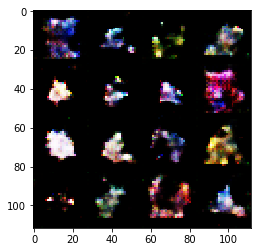

Epoch 9/10000... Discriminator Loss: 1.1296... Generator Loss: 0.9610


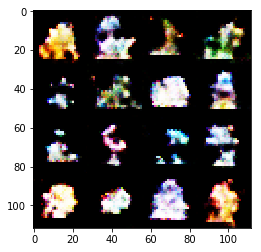

Epoch 9/10000... Discriminator Loss: 1.0588... Generator Loss: 0.9758


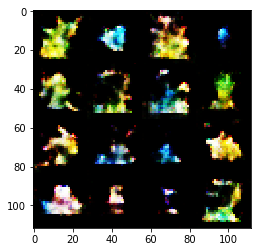

Epoch 9/10000... Discriminator Loss: 1.0697... Generator Loss: 1.1030


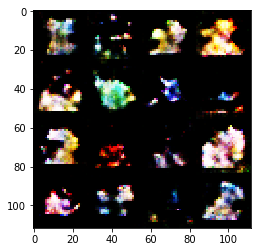

Epoch 9/10000... Discriminator Loss: 0.9416... Generator Loss: 1.4378


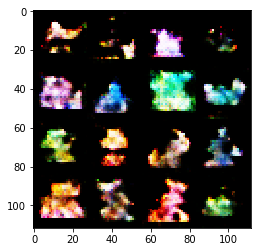

Epoch 9/10000... Discriminator Loss: 0.4471... Generator Loss: 3.1537


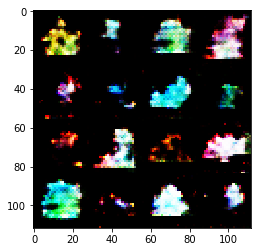

Epoch 9/10000... Discriminator Loss: 0.3970... Generator Loss: 3.7866


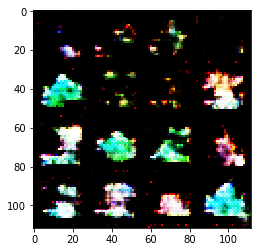

Epoch 9/10000... Discriminator Loss: 0.3902... Generator Loss: 3.8796


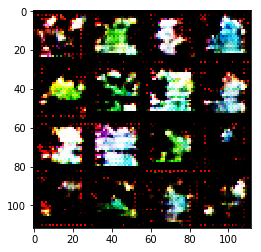

Epoch 9/10000... Discriminator Loss: 0.3455... Generator Loss: 4.7867


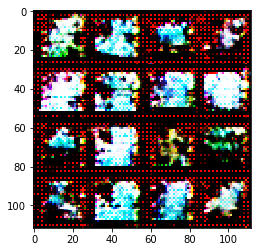

Epoch 9/10000... Discriminator Loss: 0.3662... Generator Loss: 4.4380


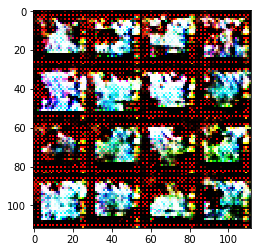

Epoch 9/10000... Discriminator Loss: 0.3492... Generator Loss: 4.8150


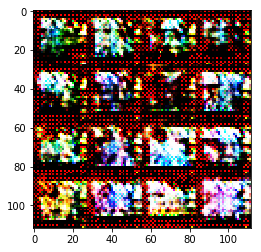

Epoch 9/10000... Discriminator Loss: 0.3588... Generator Loss: 4.1554


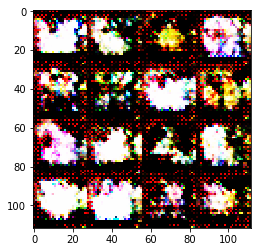

Epoch 10/10000... Discriminator Loss: 0.3734... Generator Loss: 4.6056


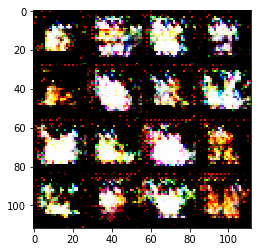

Epoch 10/10000... Discriminator Loss: 0.5086... Generator Loss: 2.5083


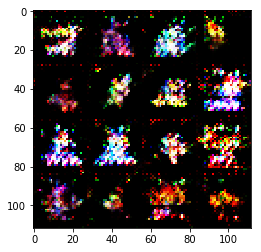

Epoch 10/10000... Discriminator Loss: 0.6848... Generator Loss: 1.4714


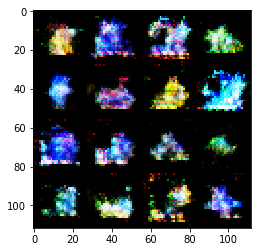

Epoch 10/10000... Discriminator Loss: 0.8545... Generator Loss: 1.1465


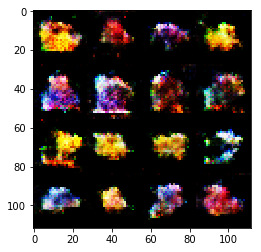

Epoch 10/10000... Discriminator Loss: 0.8642... Generator Loss: 1.3524


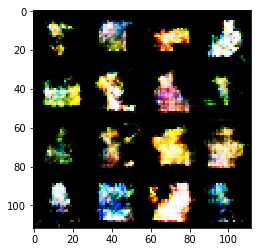

Epoch 10/10000... Discriminator Loss: 1.3104... Generator Loss: 0.5637


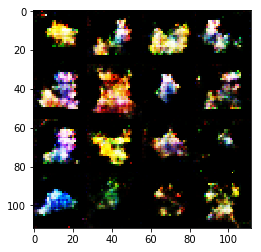

Epoch 10/10000... Discriminator Loss: 0.6350... Generator Loss: 1.9225


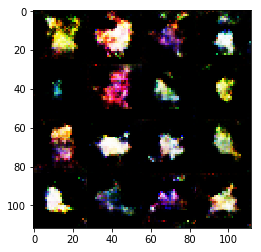

Epoch 10/10000... Discriminator Loss: 1.1915... Generator Loss: 0.8766


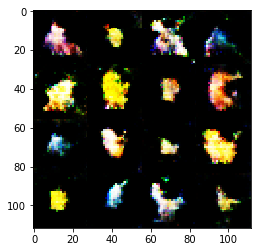

Epoch 10/10000... Discriminator Loss: 1.0405... Generator Loss: 1.0350


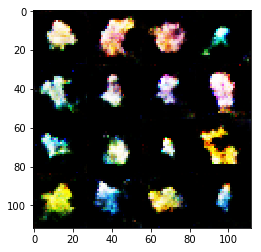

Epoch 10/10000... Discriminator Loss: 1.0915... Generator Loss: 0.9834


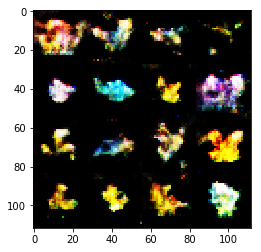

Epoch 10/10000... Discriminator Loss: 0.8421... Generator Loss: 1.8094


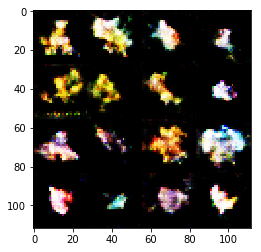

Epoch 10/10000... Discriminator Loss: 1.3349... Generator Loss: 0.8699


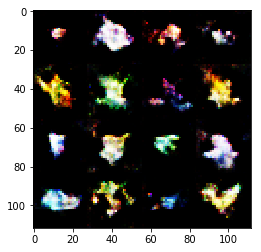

Epoch 10/10000... Discriminator Loss: 1.2211... Generator Loss: 1.3862


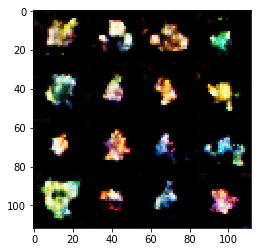

Epoch 10/10000... Discriminator Loss: 0.9739... Generator Loss: 1.2080


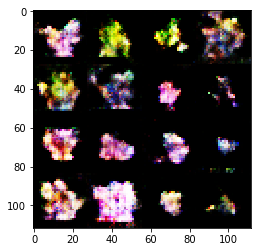

Epoch 10/10000... Discriminator Loss: 0.8833... Generator Loss: 1.1631


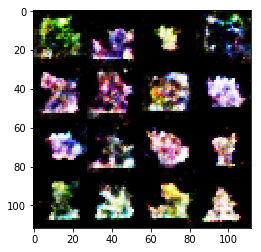

Epoch 10/10000... Discriminator Loss: 0.8377... Generator Loss: 1.4248


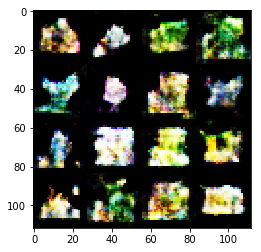

Epoch 10/10000... Discriminator Loss: 0.8952... Generator Loss: 1.1928


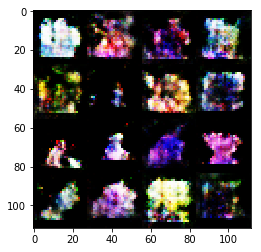

Epoch 10/10000... Discriminator Loss: 0.7026... Generator Loss: 2.1430


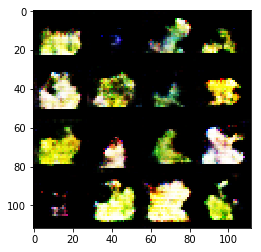

Epoch 10/10000... Discriminator Loss: 1.1702... Generator Loss: 0.9871


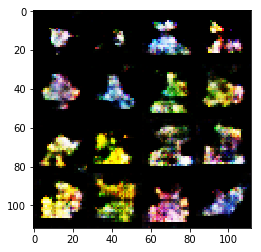

Epoch 10/10000... Discriminator Loss: 1.1832... Generator Loss: 0.9571


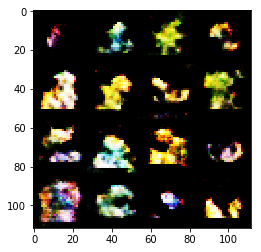

Epoch 10/10000... Discriminator Loss: 0.7582... Generator Loss: 1.8786


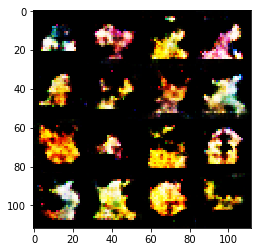

Epoch 10/10000... Discriminator Loss: 1.0166... Generator Loss: 1.1981


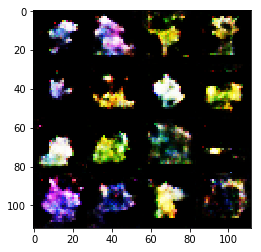

Epoch 10/10000... Discriminator Loss: 0.9369... Generator Loss: 1.6654


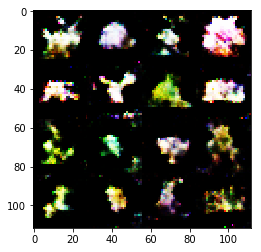

Epoch 10/10000... Discriminator Loss: 0.8444... Generator Loss: 1.2777


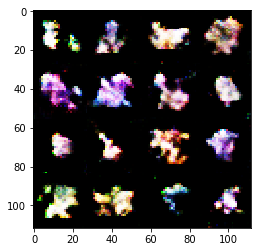

Epoch 10/10000... Discriminator Loss: 1.1733... Generator Loss: 1.4948


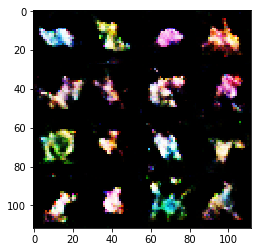

Epoch 10/10000... Discriminator Loss: 1.3005... Generator Loss: 0.8479


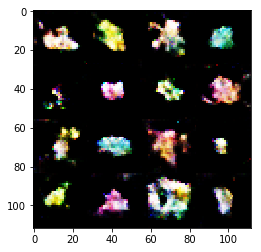

Epoch 10/10000... Discriminator Loss: 0.9880... Generator Loss: 1.1928


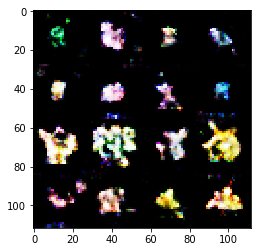

Epoch 10/10000... Discriminator Loss: 1.0613... Generator Loss: 1.4713


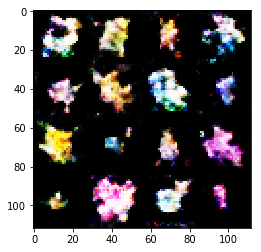

Epoch 10/10000... Discriminator Loss: 0.3879... Generator Loss: 3.7386


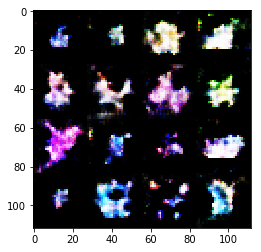

Epoch 10/10000... Discriminator Loss: 0.3586... Generator Loss: 3.9406


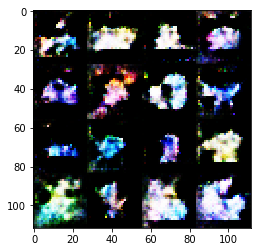

Epoch 10/10000... Discriminator Loss: 0.9001... Generator Loss: 1.3446


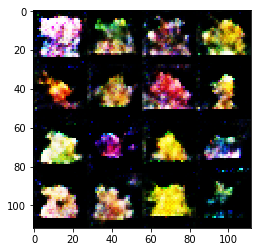

Epoch 10/10000... Discriminator Loss: 1.0092... Generator Loss: 2.0638


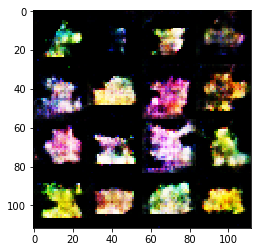

Epoch 10/10000... Discriminator Loss: 0.9912... Generator Loss: 1.9420


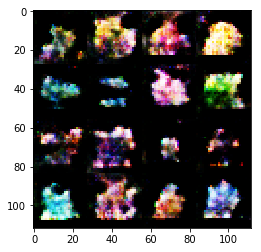

Epoch 10/10000... Discriminator Loss: 0.6700... Generator Loss: 2.0287


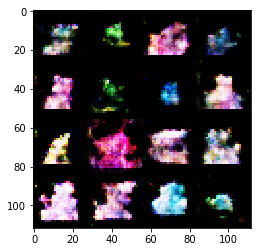

Epoch 10/10000... Discriminator Loss: 1.4794... Generator Loss: 0.6646


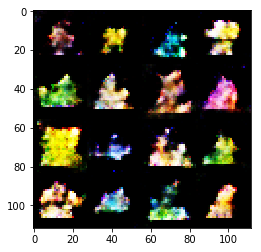

Epoch 10/10000... Discriminator Loss: 1.0093... Generator Loss: 1.0390


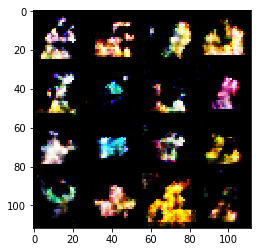

Epoch 10/10000... Discriminator Loss: 0.8911... Generator Loss: 1.4050


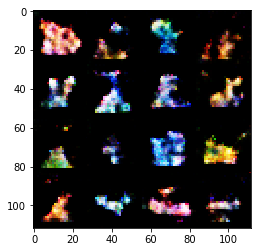

Epoch 10/10000... Discriminator Loss: 1.2581... Generator Loss: 0.7421


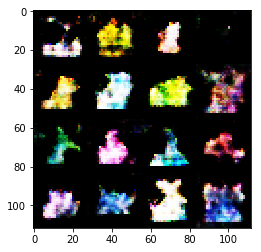

Epoch 10/10000... Discriminator Loss: 0.3990... Generator Loss: 3.5939


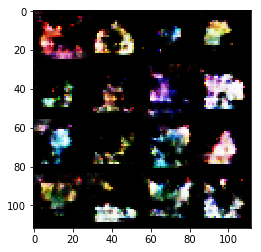

Epoch 10/10000... Discriminator Loss: 0.3724... Generator Loss: 3.8577


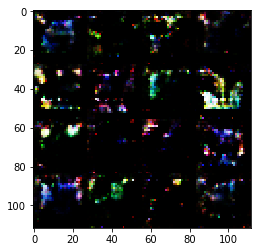

Epoch 10/10000... Discriminator Loss: 0.3577... Generator Loss: 4.9170


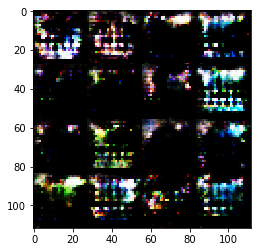

Epoch 10/10000... Discriminator Loss: 0.3442... Generator Loss: 5.1366


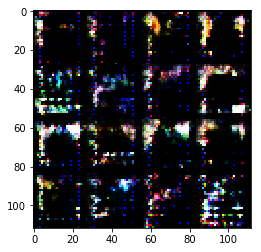

Epoch 10/10000... Discriminator Loss: 0.3453... Generator Loss: 4.8468


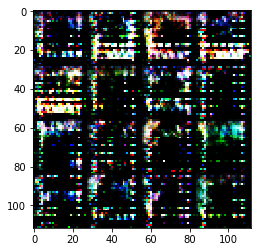

Epoch 10/10000... Discriminator Loss: 0.3465... Generator Loss: 5.1357


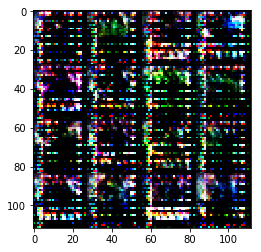

Epoch 10/10000... Discriminator Loss: 0.3441... Generator Loss: 5.1018


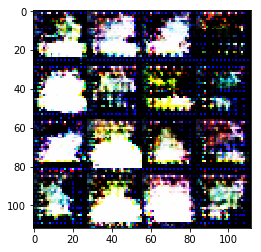

Epoch 11/10000... Discriminator Loss: 0.5629... Generator Loss: 2.4799


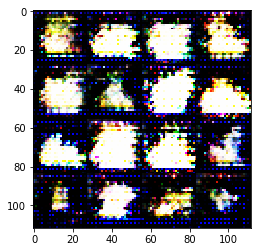

Epoch 11/10000... Discriminator Loss: 0.5167... Generator Loss: 2.2827


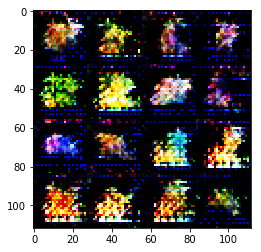

Epoch 11/10000... Discriminator Loss: 0.5184... Generator Loss: 2.6037


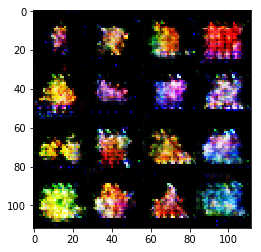

Epoch 11/10000... Discriminator Loss: 1.0668... Generator Loss: 0.8572


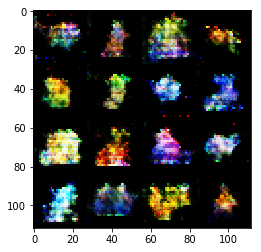

Epoch 11/10000... Discriminator Loss: 0.9901... Generator Loss: 1.1205


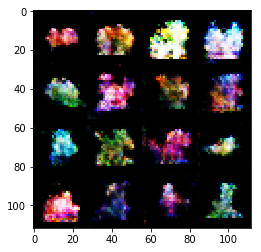

Epoch 11/10000... Discriminator Loss: 0.8393... Generator Loss: 1.8127


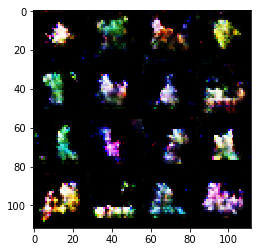

Epoch 11/10000... Discriminator Loss: 0.8786... Generator Loss: 1.6247


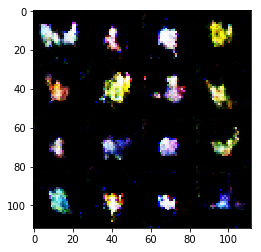

Epoch 11/10000... Discriminator Loss: 1.1339... Generator Loss: 0.8497


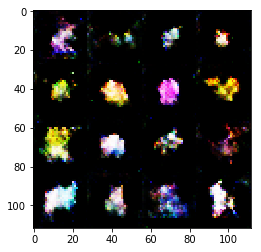

Epoch 11/10000... Discriminator Loss: 1.0263... Generator Loss: 1.0435


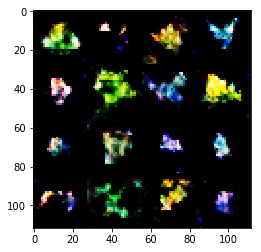

Epoch 11/10000... Discriminator Loss: 0.8769... Generator Loss: 1.2855


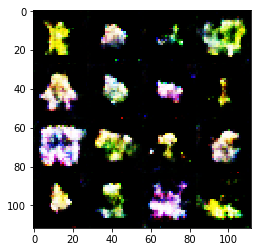

Epoch 11/10000... Discriminator Loss: 1.1470... Generator Loss: 0.7800


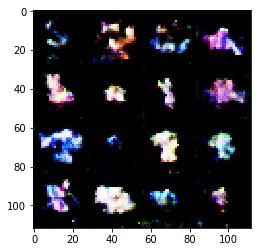

Epoch 11/10000... Discriminator Loss: 0.8654... Generator Loss: 2.8747


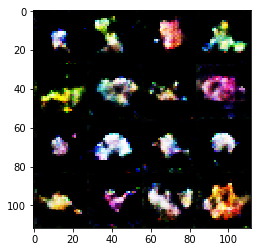

Epoch 11/10000... Discriminator Loss: 1.1560... Generator Loss: 1.0701


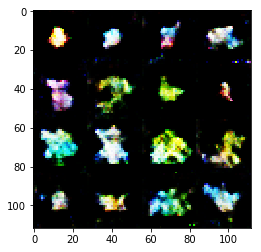

Epoch 11/10000... Discriminator Loss: 0.8958... Generator Loss: 2.0675


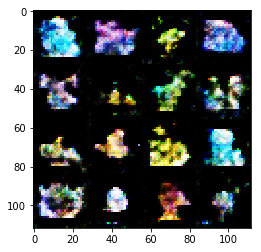

Epoch 11/10000... Discriminator Loss: 0.7144... Generator Loss: 1.6799


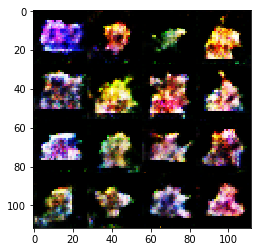

Epoch 11/10000... Discriminator Loss: 0.7831... Generator Loss: 1.6104


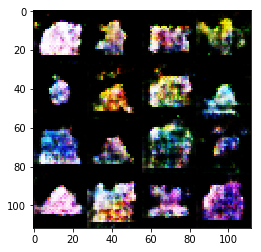

Epoch 11/10000... Discriminator Loss: 1.0744... Generator Loss: 1.1281


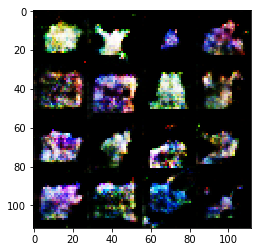

Epoch 11/10000... Discriminator Loss: 0.8804... Generator Loss: 1.1754


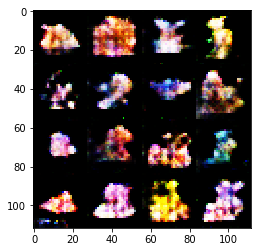

Epoch 11/10000... Discriminator Loss: 1.0073... Generator Loss: 1.2282


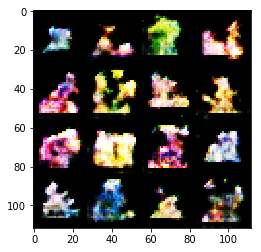

Epoch 11/10000... Discriminator Loss: 0.7909... Generator Loss: 2.1254


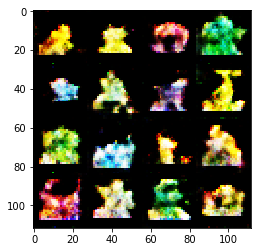

Epoch 11/10000... Discriminator Loss: 0.9316... Generator Loss: 1.1885


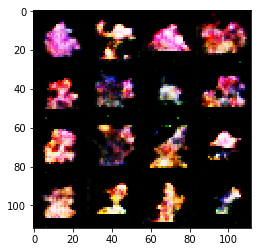

Epoch 11/10000... Discriminator Loss: 0.9046... Generator Loss: 1.1415


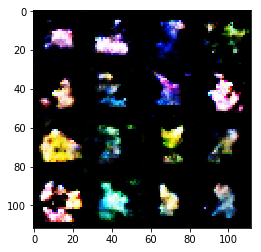

Epoch 11/10000... Discriminator Loss: 0.5812... Generator Loss: 2.2241


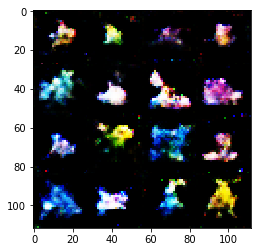

Epoch 11/10000... Discriminator Loss: 0.9241... Generator Loss: 0.9933


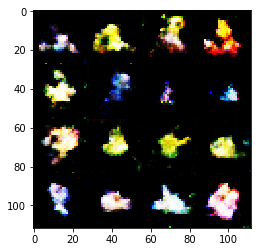

Epoch 11/10000... Discriminator Loss: 0.7097... Generator Loss: 1.4905


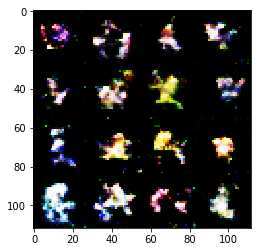

Epoch 11/10000... Discriminator Loss: 0.7106... Generator Loss: 1.7618


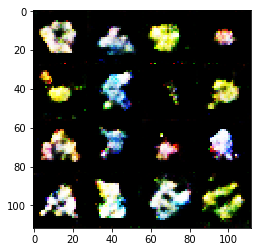

Epoch 11/10000... Discriminator Loss: 1.0617... Generator Loss: 1.7151


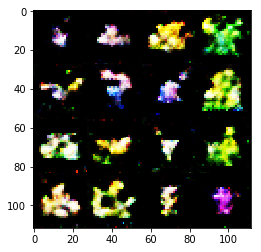

Epoch 11/10000... Discriminator Loss: 1.1125... Generator Loss: 0.7678


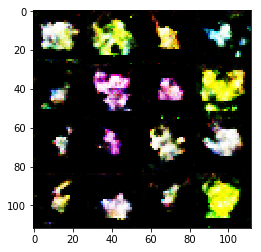

Epoch 11/10000... Discriminator Loss: 0.3900... Generator Loss: 4.7925


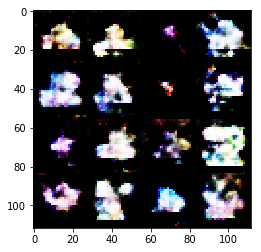

Epoch 11/10000... Discriminator Loss: 0.3921... Generator Loss: 3.8742


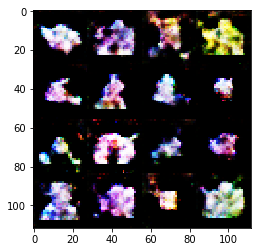

Epoch 11/10000... Discriminator Loss: 0.6624... Generator Loss: 2.7518


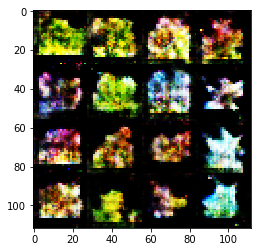

Epoch 11/10000... Discriminator Loss: 1.4090... Generator Loss: 0.7173


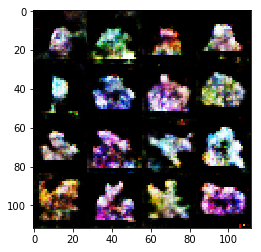

Epoch 11/10000... Discriminator Loss: 1.3167... Generator Loss: 0.8100


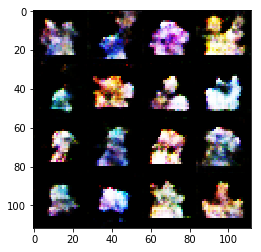

Epoch 11/10000... Discriminator Loss: 0.8402... Generator Loss: 1.6363


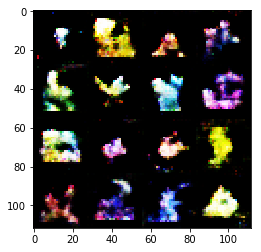

Epoch 11/10000... Discriminator Loss: 0.9679... Generator Loss: 1.1388


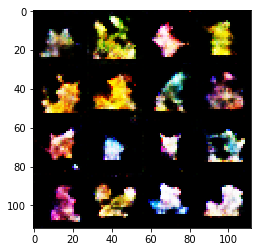

Epoch 11/10000... Discriminator Loss: 0.5762... Generator Loss: 1.9870


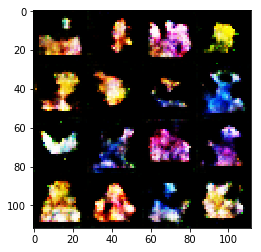

Epoch 11/10000... Discriminator Loss: 0.9185... Generator Loss: 1.5258


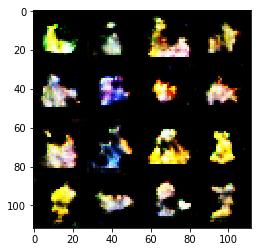

Epoch 11/10000... Discriminator Loss: 0.7264... Generator Loss: 1.8401


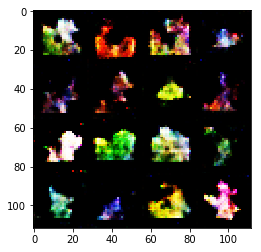

Epoch 11/10000... Discriminator Loss: 0.3680... Generator Loss: 4.3620


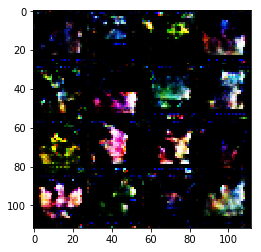

Epoch 11/10000... Discriminator Loss: 0.3932... Generator Loss: 3.8085


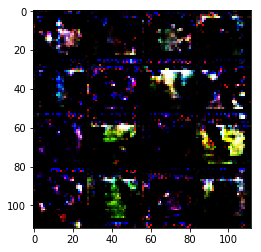

Epoch 11/10000... Discriminator Loss: 0.3534... Generator Loss: 4.8924


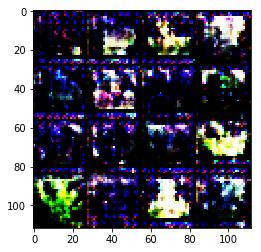

Epoch 11/10000... Discriminator Loss: 0.3513... Generator Loss: 4.6926


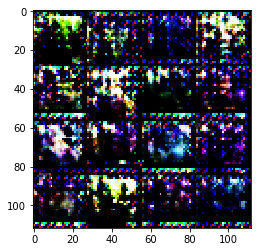

Epoch 11/10000... Discriminator Loss: 0.3527... Generator Loss: 5.0765


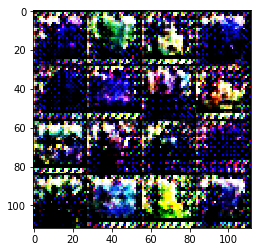

Epoch 11/10000... Discriminator Loss: 0.3508... Generator Loss: 4.7297


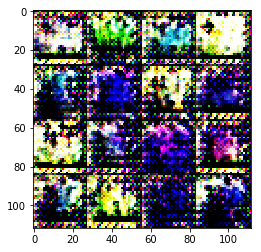

Epoch 12/10000... Discriminator Loss: 1.5454... Generator Loss: 0.5482


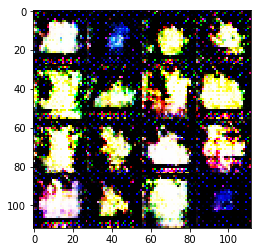

Epoch 12/10000... Discriminator Loss: 0.4737... Generator Loss: 2.4746


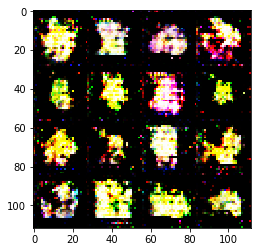

Epoch 12/10000... Discriminator Loss: 0.4094... Generator Loss: 3.8773


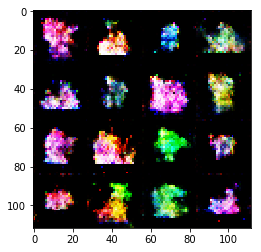

Epoch 12/10000... Discriminator Loss: 0.9854... Generator Loss: 1.0350


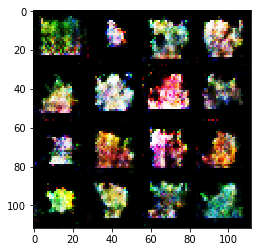

Epoch 12/10000... Discriminator Loss: 1.1178... Generator Loss: 1.1865


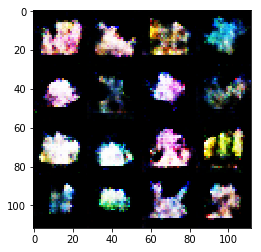

Epoch 12/10000... Discriminator Loss: 0.8914... Generator Loss: 2.8704


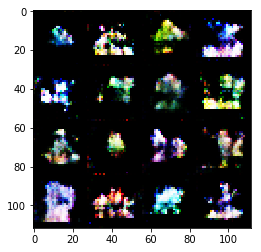

Epoch 12/10000... Discriminator Loss: 0.7714... Generator Loss: 1.7194


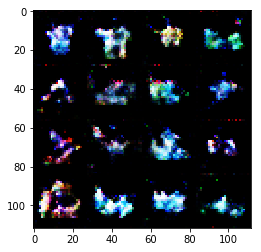

Epoch 12/10000... Discriminator Loss: 0.6972... Generator Loss: 1.8600


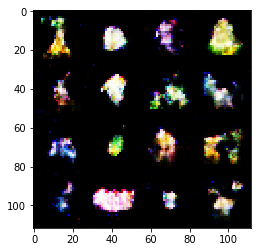

Epoch 12/10000... Discriminator Loss: 0.9955... Generator Loss: 2.4762


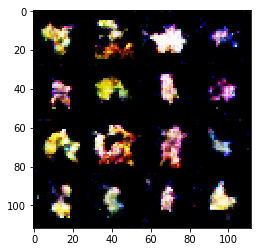

Epoch 12/10000... Discriminator Loss: 0.9834... Generator Loss: 1.0926


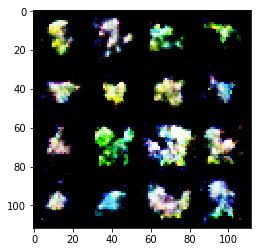

Epoch 12/10000... Discriminator Loss: 1.3148... Generator Loss: 0.5483


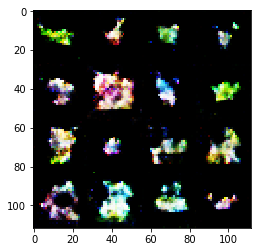

Epoch 12/10000... Discriminator Loss: 0.9714... Generator Loss: 1.4320


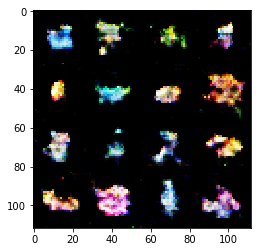

Epoch 12/10000... Discriminator Loss: 1.0960... Generator Loss: 0.9475


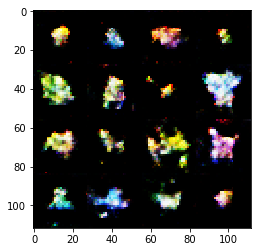

Epoch 12/10000... Discriminator Loss: 1.2029... Generator Loss: 0.9722


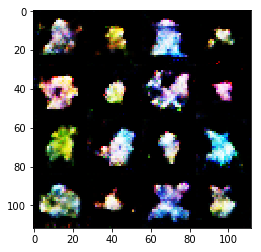

Epoch 12/10000... Discriminator Loss: 0.7002... Generator Loss: 1.7333


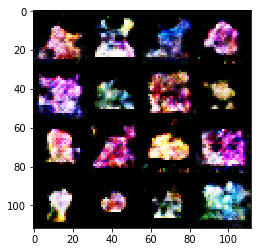

Epoch 12/10000... Discriminator Loss: 0.9457... Generator Loss: 1.0572


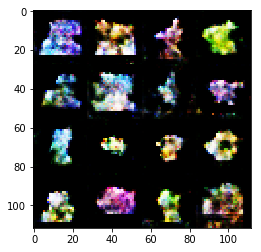

Epoch 12/10000... Discriminator Loss: 0.6400... Generator Loss: 1.8710


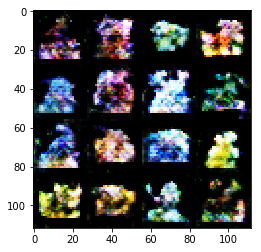

Epoch 12/10000... Discriminator Loss: 0.8901... Generator Loss: 2.1641


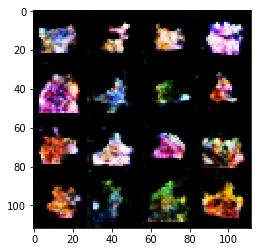

Epoch 12/10000... Discriminator Loss: 0.8196... Generator Loss: 1.7294


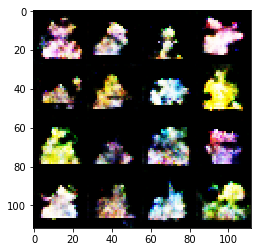

Epoch 12/10000... Discriminator Loss: 0.9720... Generator Loss: 1.4655


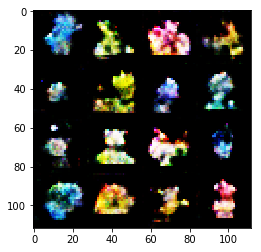

Epoch 12/10000... Discriminator Loss: 0.9226... Generator Loss: 1.4333


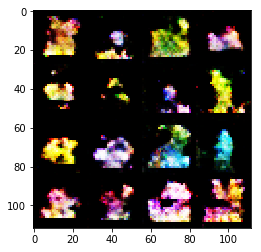

Epoch 12/10000... Discriminator Loss: 0.7986... Generator Loss: 2.0476


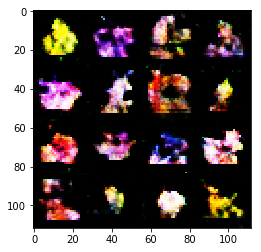

Epoch 12/10000... Discriminator Loss: 1.1691... Generator Loss: 0.8775


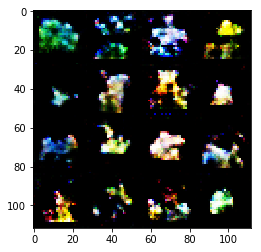

Epoch 12/10000... Discriminator Loss: 2.4070... Generator Loss: 0.2101


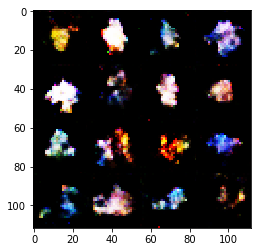

Epoch 12/10000... Discriminator Loss: 1.0580... Generator Loss: 2.5543


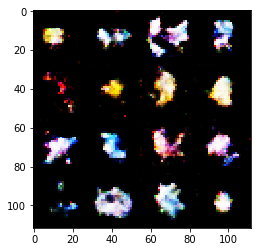

Epoch 12/10000... Discriminator Loss: 1.1710... Generator Loss: 2.2036


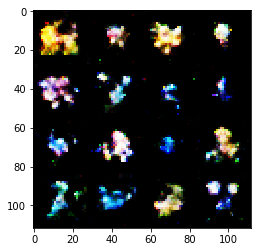

Epoch 12/10000... Discriminator Loss: 1.6048... Generator Loss: 0.5941


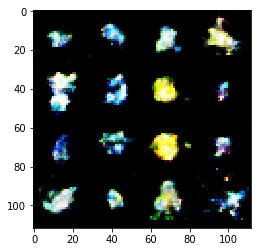

Epoch 12/10000... Discriminator Loss: 0.5195... Generator Loss: 2.1070


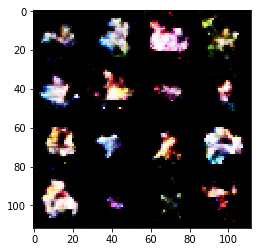

Epoch 12/10000... Discriminator Loss: 1.0991... Generator Loss: 1.1284


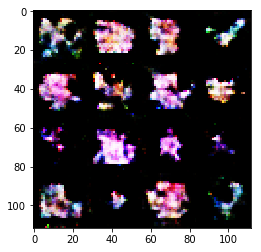

Epoch 12/10000... Discriminator Loss: 0.3819... Generator Loss: 3.5960


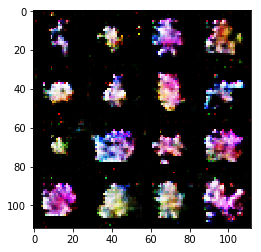

Epoch 12/10000... Discriminator Loss: 0.3674... Generator Loss: 4.1581


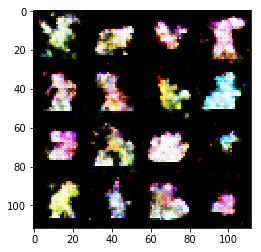

Epoch 12/10000... Discriminator Loss: 0.8550... Generator Loss: 2.6139


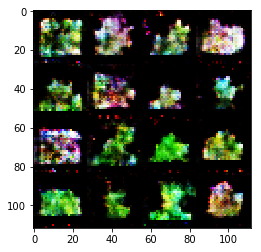

Epoch 12/10000... Discriminator Loss: 0.6562... Generator Loss: 2.4966


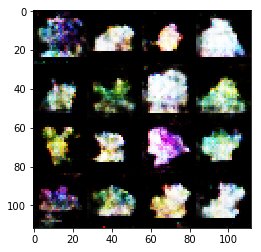

Epoch 12/10000... Discriminator Loss: 0.6874... Generator Loss: 1.9144


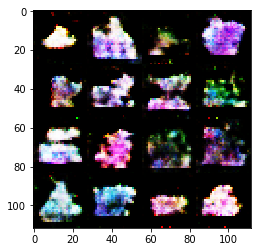

Epoch 12/10000... Discriminator Loss: 0.5437... Generator Loss: 2.9565


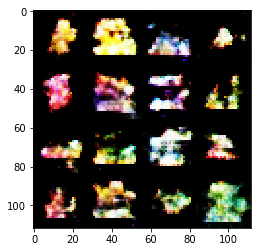

Epoch 12/10000... Discriminator Loss: 0.8734... Generator Loss: 1.8662


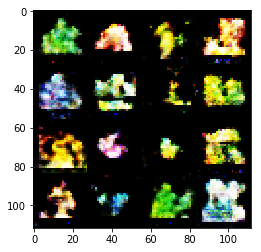

Epoch 12/10000... Discriminator Loss: 0.7684... Generator Loss: 1.9852


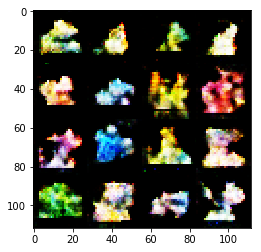

Epoch 12/10000... Discriminator Loss: 0.8387... Generator Loss: 1.3639


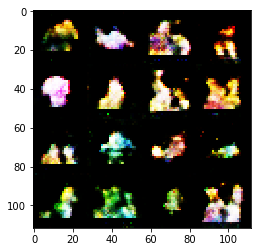

Epoch 12/10000... Discriminator Loss: 0.8535... Generator Loss: 1.6586


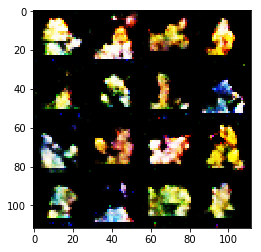

Epoch 12/10000... Discriminator Loss: 0.3624... Generator Loss: 4.6447


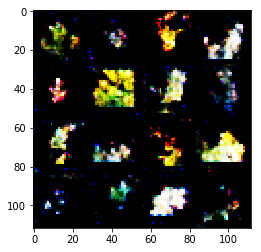

Epoch 12/10000... Discriminator Loss: 0.3726... Generator Loss: 4.1384


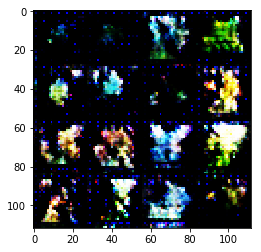

Epoch 12/10000... Discriminator Loss: 0.3485... Generator Loss: 4.6335


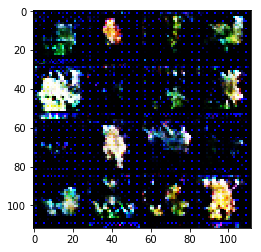

Epoch 12/10000... Discriminator Loss: 0.3602... Generator Loss: 4.5904


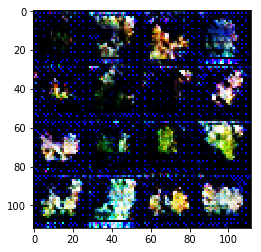

Epoch 12/10000... Discriminator Loss: 0.3575... Generator Loss: 4.4927


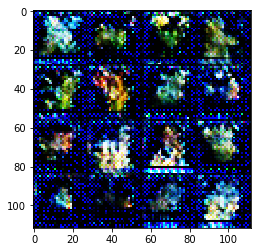

Epoch 12/10000... Discriminator Loss: 0.3633... Generator Loss: 4.0443


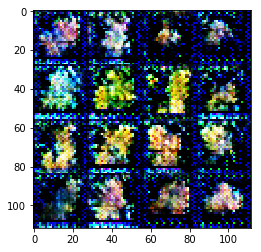

Epoch 13/10000... Discriminator Loss: 0.4164... Generator Loss: 6.4646


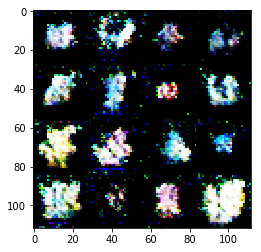

Epoch 13/10000... Discriminator Loss: 0.6918... Generator Loss: 1.4803


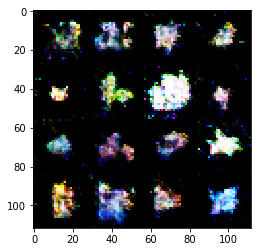

Epoch 13/10000... Discriminator Loss: 0.8053... Generator Loss: 1.6011


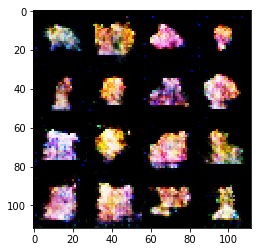

Epoch 13/10000... Discriminator Loss: 0.7143... Generator Loss: 2.7479


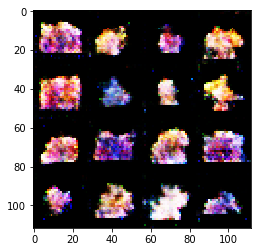

Epoch 13/10000... Discriminator Loss: 0.5923... Generator Loss: 3.0562


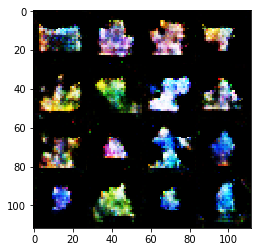

Epoch 13/10000... Discriminator Loss: 0.7070... Generator Loss: 1.9595


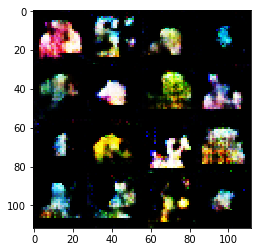

Epoch 13/10000... Discriminator Loss: 0.7172... Generator Loss: 2.5460


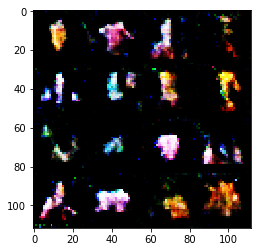

Epoch 13/10000... Discriminator Loss: 1.0095... Generator Loss: 2.5683


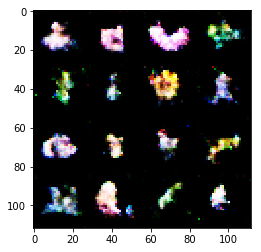

Epoch 13/10000... Discriminator Loss: 1.0156... Generator Loss: 1.6098


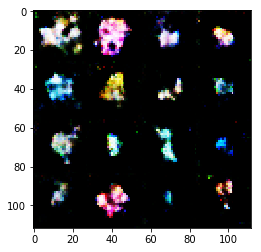

Epoch 13/10000... Discriminator Loss: 1.1327... Generator Loss: 1.1272


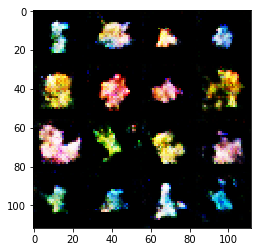

Epoch 13/10000... Discriminator Loss: 0.8759... Generator Loss: 1.7888


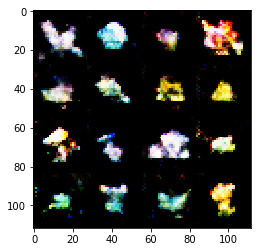

Epoch 13/10000... Discriminator Loss: 1.2096... Generator Loss: 0.8602


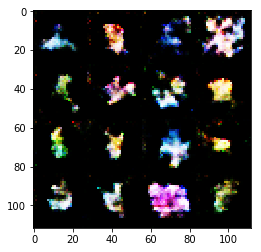

Epoch 13/10000... Discriminator Loss: 0.8816... Generator Loss: 1.7137


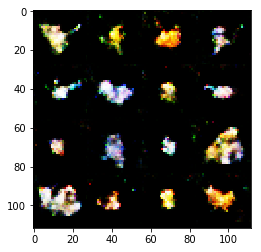

Epoch 13/10000... Discriminator Loss: 1.1644... Generator Loss: 0.8337


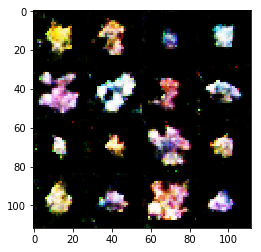

Epoch 13/10000... Discriminator Loss: 1.6153... Generator Loss: 0.5086


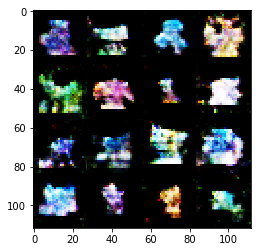

Epoch 13/10000... Discriminator Loss: 0.5023... Generator Loss: 2.9451


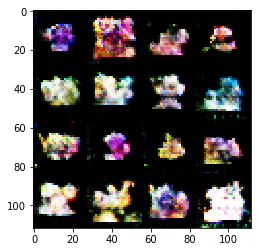

Epoch 13/10000... Discriminator Loss: 0.9071... Generator Loss: 1.1706


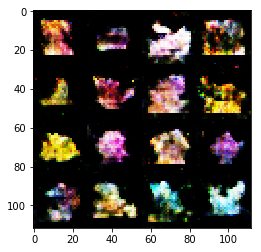

Epoch 13/10000... Discriminator Loss: 0.9239... Generator Loss: 1.3437


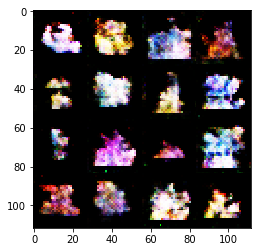

Epoch 13/10000... Discriminator Loss: 0.8373... Generator Loss: 1.3190


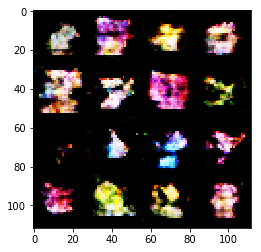

Epoch 13/10000... Discriminator Loss: 1.1846... Generator Loss: 0.8851


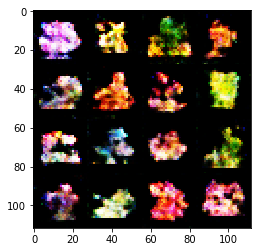

Epoch 13/10000... Discriminator Loss: 0.8462... Generator Loss: 1.5759


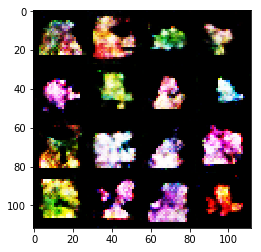

Epoch 13/10000... Discriminator Loss: 0.8224... Generator Loss: 1.4483


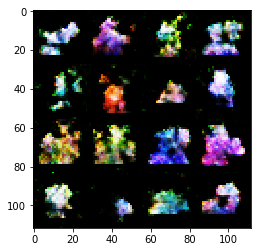

Epoch 13/10000... Discriminator Loss: 0.6091... Generator Loss: 1.9515


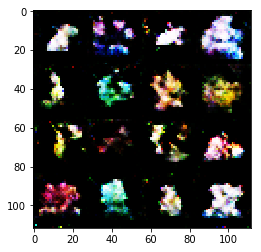

Epoch 13/10000... Discriminator Loss: 1.2050... Generator Loss: 3.6146


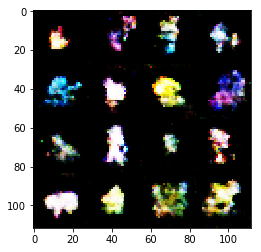

Epoch 13/10000... Discriminator Loss: 1.5471... Generator Loss: 0.4728


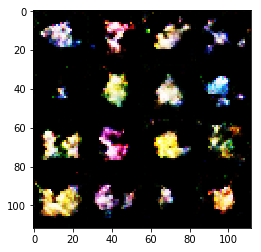

Epoch 13/10000... Discriminator Loss: 1.2526... Generator Loss: 0.8278


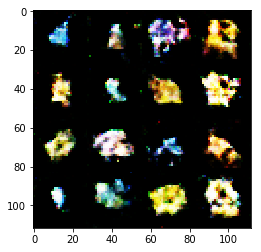

Epoch 13/10000... Discriminator Loss: 0.9472... Generator Loss: 0.9640


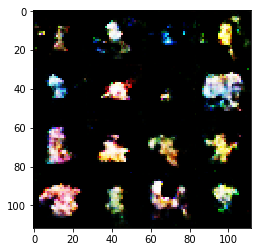

Epoch 13/10000... Discriminator Loss: 1.1960... Generator Loss: 0.8746


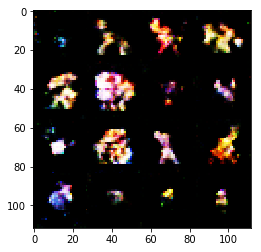

Epoch 13/10000... Discriminator Loss: 0.9622... Generator Loss: 1.3404


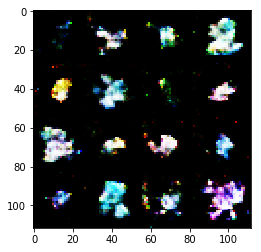

Epoch 13/10000... Discriminator Loss: 0.3880... Generator Loss: 3.6408


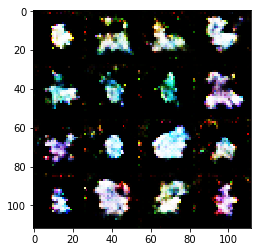

Epoch 13/10000... Discriminator Loss: 0.9013... Generator Loss: 1.1743


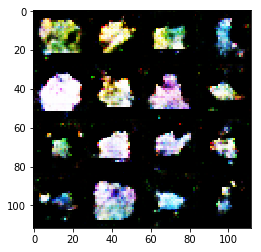

Epoch 13/10000... Discriminator Loss: 0.8838... Generator Loss: 1.2250


KeyboardInterrupt: 

In [22]:
batch_size = 32
epochs = 10000
z_dim = 128
learning_rate = 0.0005
beta1 = 0.5
alpha = 0.1
# Smoothing 
smooth = 0.1

dataset = helper.Dataset('RGB', helper.get_images())
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, dataset.get_batches,
          dataset.shape, dataset.image_mode, alpha=alpha, smooth=smooth)

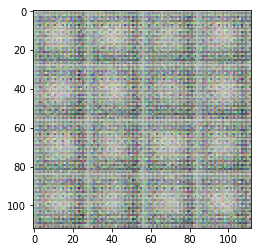

Epoch 1/10000... Discriminator Loss: 1.3373... Generator Loss: 8.2173


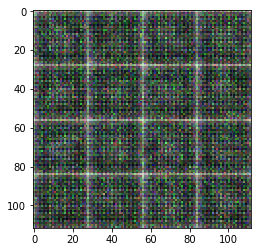

Epoch 1/10000... Discriminator Loss: 4.0608... Generator Loss: 0.0490


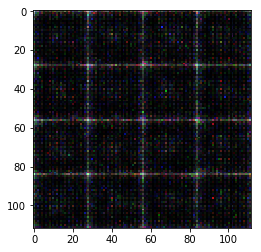

Epoch 1/10000... Discriminator Loss: 1.6742... Generator Loss: 2.5996


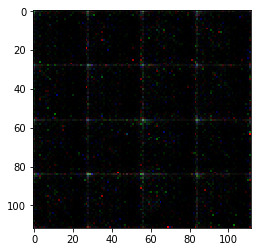

Epoch 1/10000... Discriminator Loss: 1.7250... Generator Loss: 0.5814


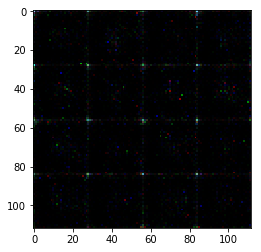

Epoch 1/10000... Discriminator Loss: 1.7484... Generator Loss: 0.4388


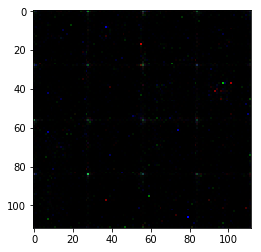

Epoch 1/10000... Discriminator Loss: 2.9990... Generator Loss: 0.3263


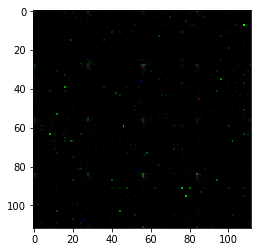

Epoch 1/10000... Discriminator Loss: 1.0581... Generator Loss: 1.2125


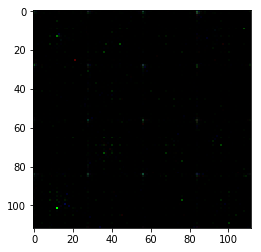

Epoch 1/10000... Discriminator Loss: 1.7858... Generator Loss: 0.4613


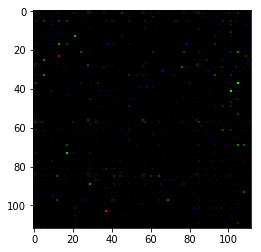

Epoch 1/10000... Discriminator Loss: 0.5212... Generator Loss: 2.8133


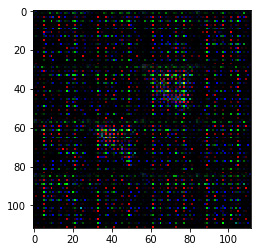

Epoch 1/10000... Discriminator Loss: 0.4578... Generator Loss: 2.6109


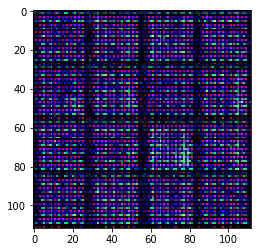

Epoch 1/10000... Discriminator Loss: 0.5064... Generator Loss: 2.4452


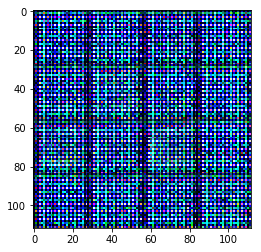

Epoch 1/10000... Discriminator Loss: 0.8638... Generator Loss: 1.2907


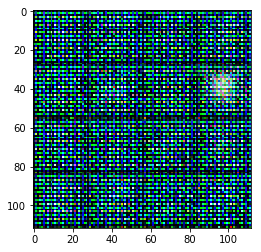

Epoch 2/10000... Discriminator Loss: 0.5232... Generator Loss: 3.0711


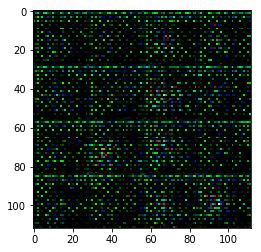

Epoch 2/10000... Discriminator Loss: 0.5897... Generator Loss: 1.8238


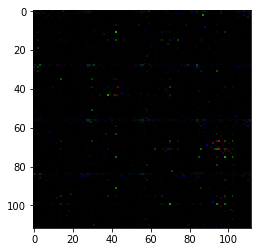

Epoch 2/10000... Discriminator Loss: 1.7266... Generator Loss: 6.5156


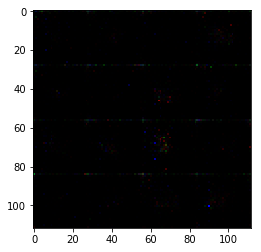

Epoch 2/10000... Discriminator Loss: 2.3803... Generator Loss: 0.1782


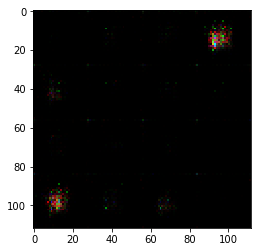

Epoch 2/10000... Discriminator Loss: 2.1864... Generator Loss: 0.2646


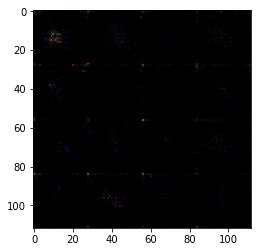

Epoch 2/10000... Discriminator Loss: 1.3965... Generator Loss: 0.7331


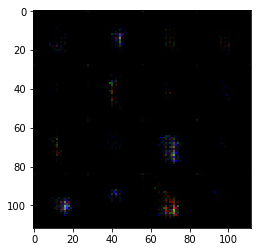

Epoch 2/10000... Discriminator Loss: 1.0439... Generator Loss: 1.0784


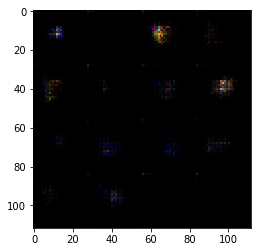

Epoch 2/10000... Discriminator Loss: 1.4901... Generator Loss: 0.5883


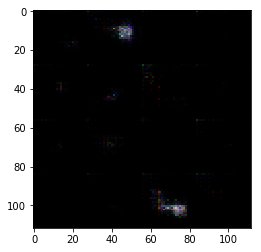

Epoch 2/10000... Discriminator Loss: 0.4447... Generator Loss: 4.2939


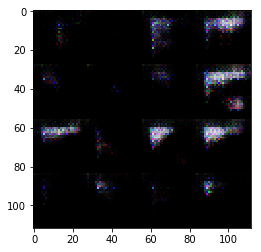

Epoch 2/10000... Discriminator Loss: 0.4231... Generator Loss: 3.3556


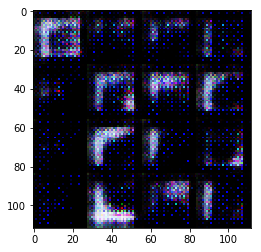

Epoch 2/10000... Discriminator Loss: 0.4312... Generator Loss: 5.5162


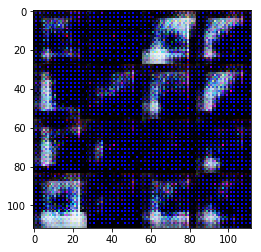

Epoch 2/10000... Discriminator Loss: 0.3865... Generator Loss: 3.9248


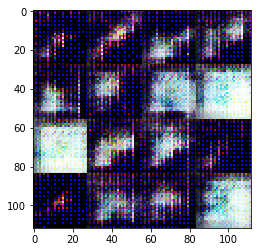

Epoch 3/10000... Discriminator Loss: 0.7166... Generator Loss: 3.9071


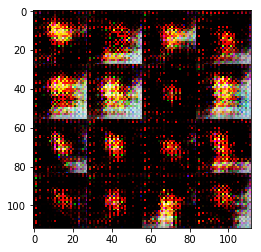

Epoch 3/10000... Discriminator Loss: 0.6799... Generator Loss: 1.7667


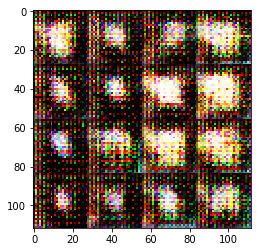

Epoch 3/10000... Discriminator Loss: 0.6197... Generator Loss: 1.8879


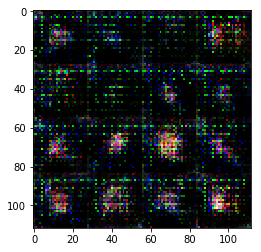

Epoch 3/10000... Discriminator Loss: 2.7240... Generator Loss: 4.3937


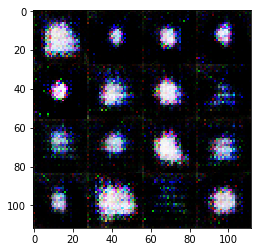

Epoch 3/10000... Discriminator Loss: 1.1651... Generator Loss: 1.4600


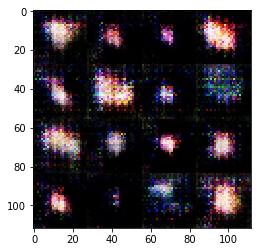

Epoch 3/10000... Discriminator Loss: 1.3448... Generator Loss: 1.9148


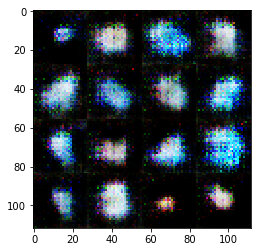

Epoch 3/10000... Discriminator Loss: 1.6519... Generator Loss: 0.5223


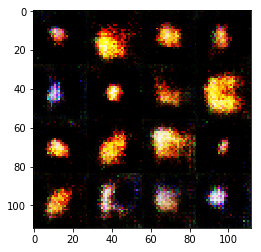

Epoch 3/10000... Discriminator Loss: 1.3780... Generator Loss: 1.3799


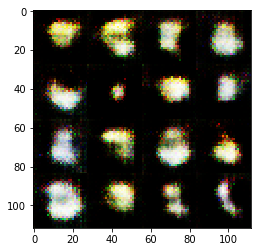

Epoch 3/10000... Discriminator Loss: 0.4626... Generator Loss: 3.4911


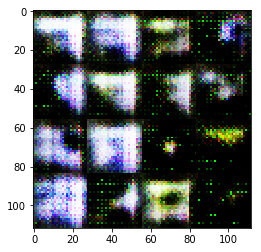

Epoch 3/10000... Discriminator Loss: 0.4949... Generator Loss: 2.7159


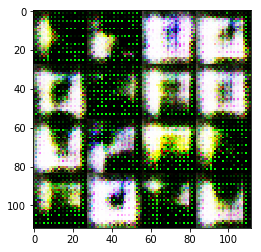

Epoch 3/10000... Discriminator Loss: 0.3799... Generator Loss: 3.7798


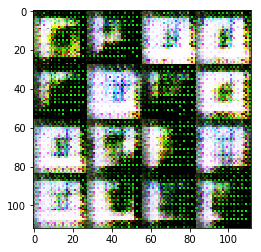

Epoch 3/10000... Discriminator Loss: 0.3790... Generator Loss: 3.3580


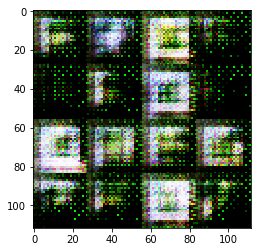

Epoch 4/10000... Discriminator Loss: 4.1957... Generator Loss: 1.4955


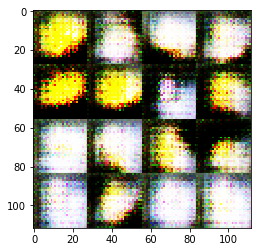

Epoch 4/10000... Discriminator Loss: 0.5219... Generator Loss: 2.6441


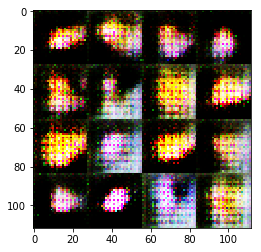

Epoch 4/10000... Discriminator Loss: 0.5018... Generator Loss: 2.0738


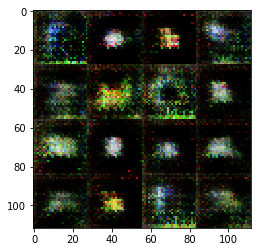

Epoch 4/10000... Discriminator Loss: 0.9179... Generator Loss: 1.5381


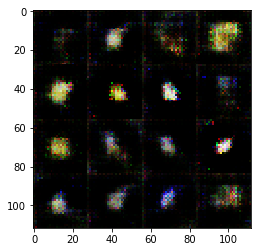

Epoch 4/10000... Discriminator Loss: 0.8793... Generator Loss: 1.6649


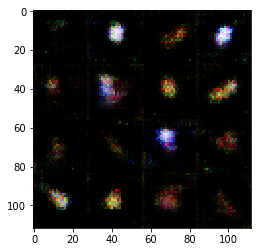

Epoch 4/10000... Discriminator Loss: 1.5590... Generator Loss: 1.7449


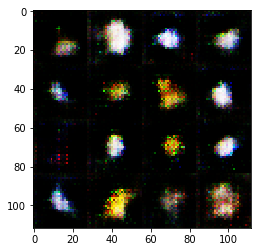

Epoch 4/10000... Discriminator Loss: 0.9998... Generator Loss: 1.1429


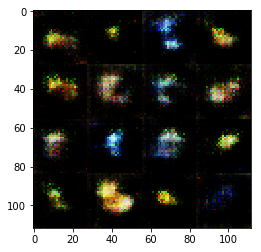

Epoch 4/10000... Discriminator Loss: 1.2446... Generator Loss: 0.7091


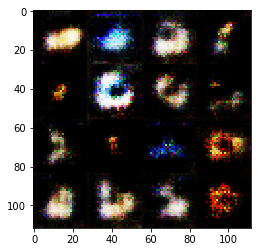

Epoch 4/10000... Discriminator Loss: 1.2829... Generator Loss: 0.7758


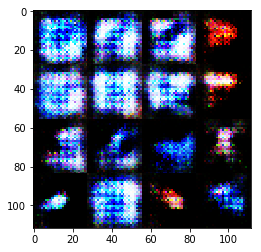

Epoch 4/10000... Discriminator Loss: 0.4276... Generator Loss: 3.0316


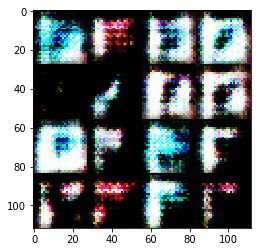

Epoch 4/10000... Discriminator Loss: 0.4064... Generator Loss: 3.4130


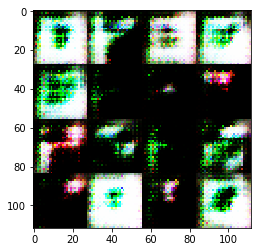

Epoch 4/10000... Discriminator Loss: 0.4306... Generator Loss: 3.2193


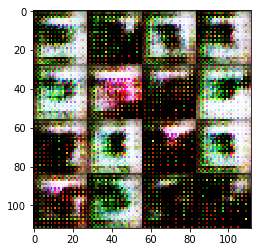

Epoch 4/10000... Discriminator Loss: 0.6514... Generator Loss: 1.7157


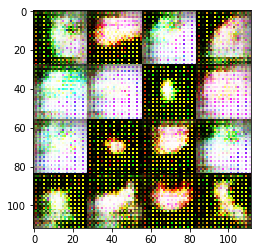

Epoch 5/10000... Discriminator Loss: 0.4533... Generator Loss: 2.8628


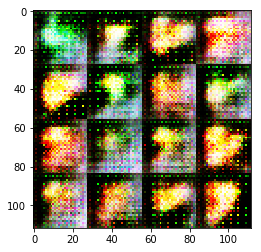

Epoch 5/10000... Discriminator Loss: 0.4488... Generator Loss: 2.6991


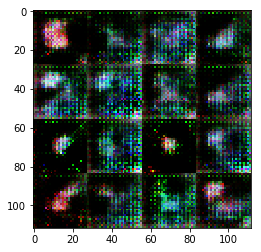

Epoch 5/10000... Discriminator Loss: 2.0735... Generator Loss: 0.3030


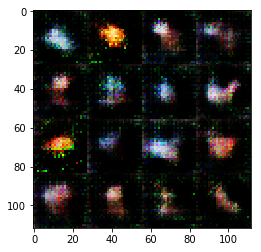

Epoch 5/10000... Discriminator Loss: 1.1780... Generator Loss: 0.6610


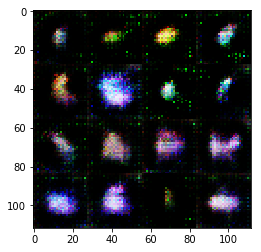

Epoch 5/10000... Discriminator Loss: 1.3550... Generator Loss: 0.6924


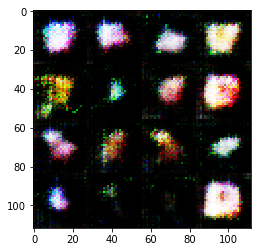

Epoch 5/10000... Discriminator Loss: 1.1549... Generator Loss: 1.0425


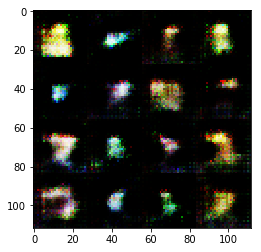

Epoch 5/10000... Discriminator Loss: 1.8975... Generator Loss: 0.2476


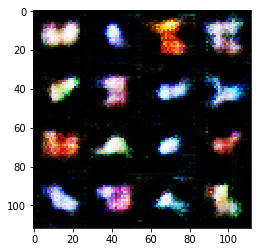

Epoch 5/10000... Discriminator Loss: 1.0978... Generator Loss: 0.9910


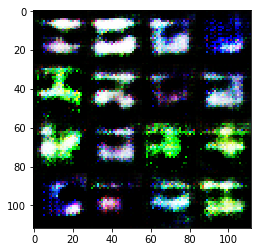

Epoch 5/10000... Discriminator Loss: 0.4344... Generator Loss: 3.5259


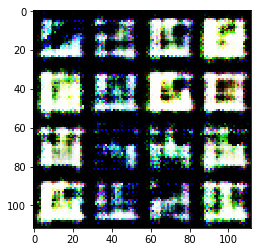

Epoch 5/10000... Discriminator Loss: 0.4144... Generator Loss: 3.1479


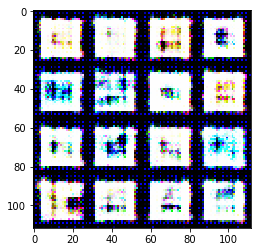

Epoch 5/10000... Discriminator Loss: 0.6550... Generator Loss: 1.4454


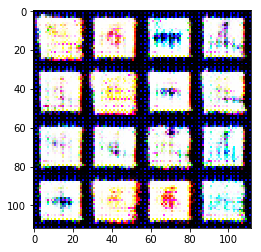

Epoch 5/10000... Discriminator Loss: 0.4001... Generator Loss: 3.1388


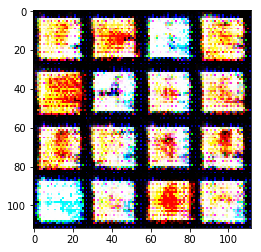

Epoch 6/10000... Discriminator Loss: 0.5557... Generator Loss: 4.7904


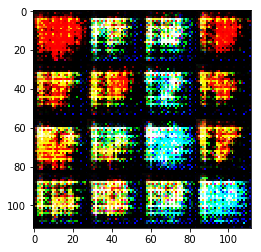

Epoch 6/10000... Discriminator Loss: 0.6264... Generator Loss: 2.0452


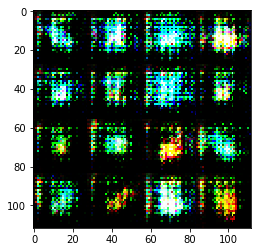

Epoch 6/10000... Discriminator Loss: 0.6946... Generator Loss: 1.7410


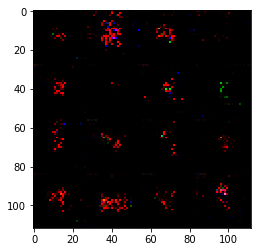

Epoch 6/10000... Discriminator Loss: 0.7882... Generator Loss: 1.7412


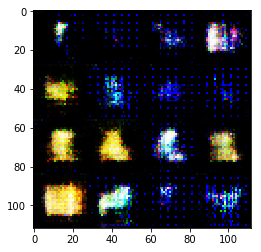

Epoch 6/10000... Discriminator Loss: 0.7357... Generator Loss: 2.0188


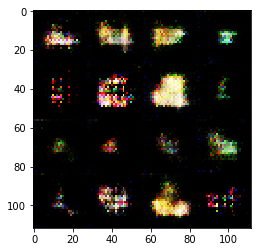

Epoch 6/10000... Discriminator Loss: 1.3891... Generator Loss: 3.1848


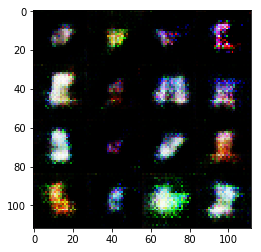

Epoch 6/10000... Discriminator Loss: 1.2432... Generator Loss: 1.8232


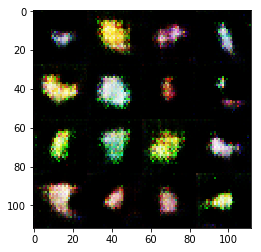

Epoch 6/10000... Discriminator Loss: 1.1805... Generator Loss: 0.9618


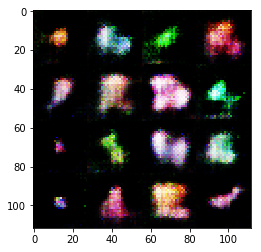

Epoch 6/10000... Discriminator Loss: 0.4097... Generator Loss: 3.6578


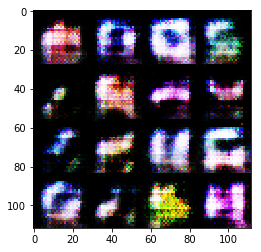

Epoch 6/10000... Discriminator Loss: 0.3913... Generator Loss: 3.2555


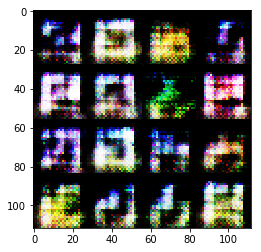

Epoch 6/10000... Discriminator Loss: 0.4308... Generator Loss: 3.0946


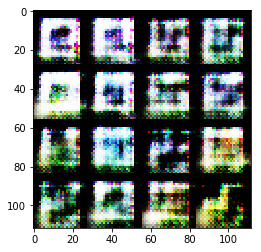

Epoch 6/10000... Discriminator Loss: 0.3885... Generator Loss: 3.2674


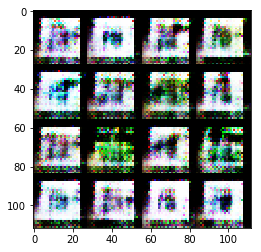

Epoch 7/10000... Discriminator Loss: 1.5756... Generator Loss: 0.5983


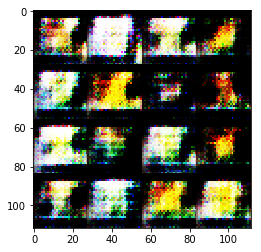

Epoch 7/10000... Discriminator Loss: 0.5823... Generator Loss: 2.0304


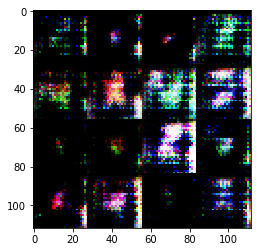

Epoch 7/10000... Discriminator Loss: 0.5393... Generator Loss: 2.1696


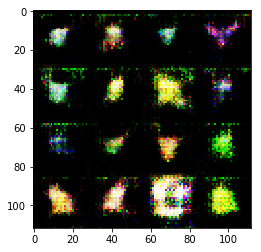

Epoch 7/10000... Discriminator Loss: 1.4217... Generator Loss: 1.9173


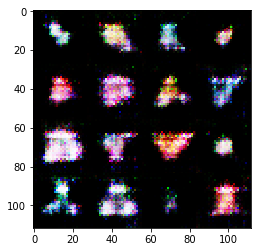

Epoch 7/10000... Discriminator Loss: 1.5784... Generator Loss: 0.5174


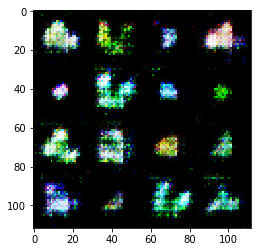

Epoch 7/10000... Discriminator Loss: 1.1785... Generator Loss: 0.7257


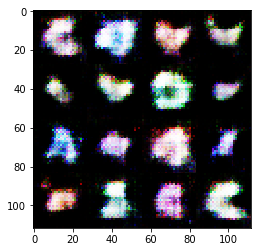

Epoch 7/10000... Discriminator Loss: 1.3646... Generator Loss: 0.8801


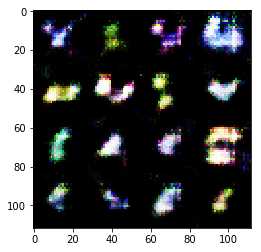

Epoch 7/10000... Discriminator Loss: 1.1961... Generator Loss: 1.4595


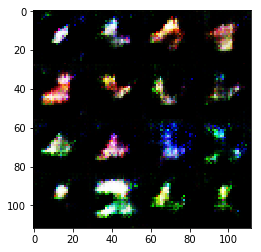

Epoch 7/10000... Discriminator Loss: 1.6352... Generator Loss: 0.4952


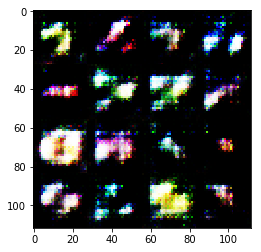

Epoch 7/10000... Discriminator Loss: 0.3986... Generator Loss: 3.3852


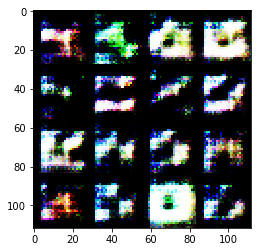

Epoch 7/10000... Discriminator Loss: 0.4014... Generator Loss: 3.5460


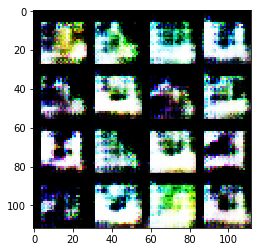

Epoch 7/10000... Discriminator Loss: 0.3701... Generator Loss: 4.0373


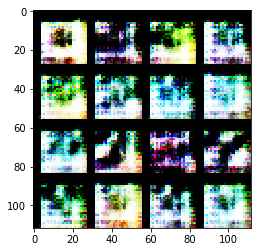

Epoch 7/10000... Discriminator Loss: 0.3985... Generator Loss: 3.3702


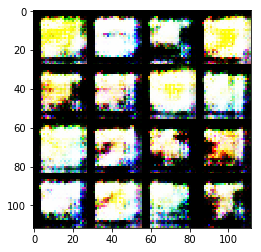

Epoch 8/10000... Discriminator Loss: 0.5593... Generator Loss: 2.0682


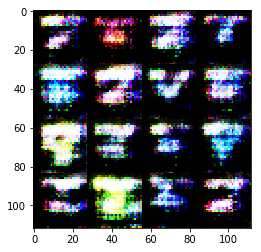

Epoch 8/10000... Discriminator Loss: 0.6173... Generator Loss: 1.7028


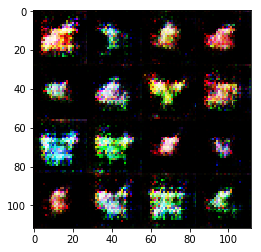

Epoch 8/10000... Discriminator Loss: 1.1157... Generator Loss: 1.4651


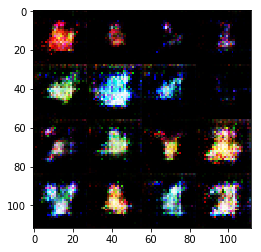

Epoch 8/10000... Discriminator Loss: 1.3925... Generator Loss: 1.0024


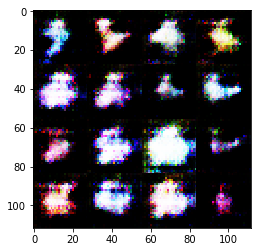

Epoch 8/10000... Discriminator Loss: 1.0389... Generator Loss: 1.3249


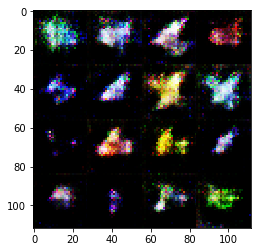

Epoch 8/10000... Discriminator Loss: 1.6689... Generator Loss: 2.6143


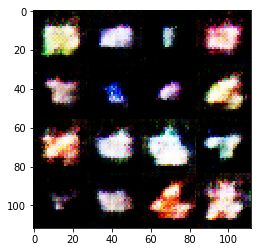

Epoch 8/10000... Discriminator Loss: 1.2902... Generator Loss: 1.8888


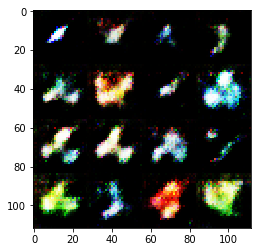

Epoch 8/10000... Discriminator Loss: 1.2069... Generator Loss: 0.9210


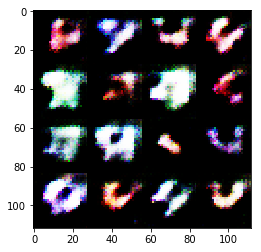

Epoch 8/10000... Discriminator Loss: 0.4037... Generator Loss: 3.2184


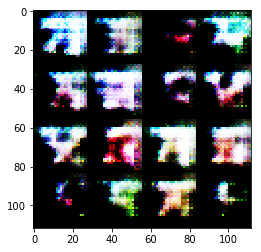

Epoch 8/10000... Discriminator Loss: 0.3870... Generator Loss: 3.4273


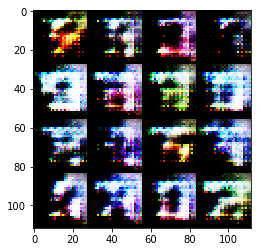

Epoch 8/10000... Discriminator Loss: 0.3968... Generator Loss: 3.1113


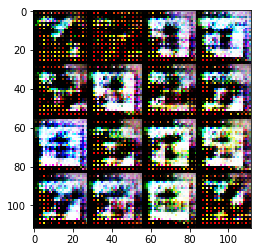

Epoch 8/10000... Discriminator Loss: 0.3936... Generator Loss: 3.1721


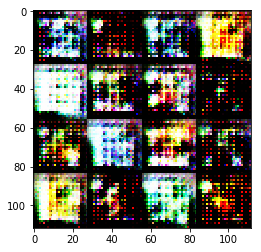

Epoch 9/10000... Discriminator Loss: 0.5465... Generator Loss: 3.4163


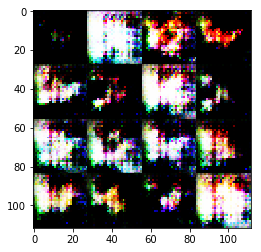

Epoch 9/10000... Discriminator Loss: 0.4732... Generator Loss: 2.4477


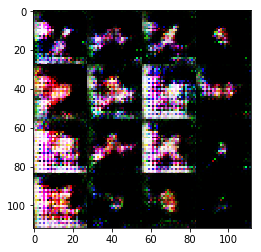

Epoch 9/10000... Discriminator Loss: 0.8622... Generator Loss: 1.0583


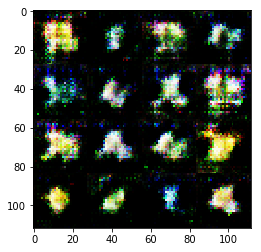

Epoch 9/10000... Discriminator Loss: 1.4763... Generator Loss: 2.3889


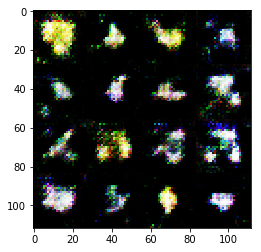

Epoch 9/10000... Discriminator Loss: 1.2592... Generator Loss: 0.9191


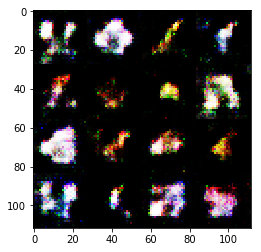

Epoch 9/10000... Discriminator Loss: 1.3528... Generator Loss: 0.6128


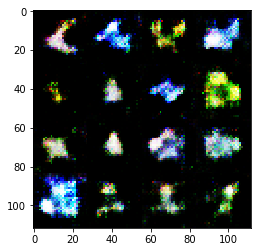

Epoch 9/10000... Discriminator Loss: 1.4818... Generator Loss: 0.4620


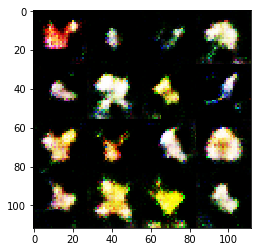

Epoch 9/10000... Discriminator Loss: 1.1740... Generator Loss: 1.0084


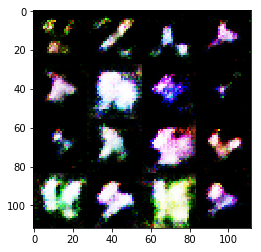

Epoch 9/10000... Discriminator Loss: 0.3792... Generator Loss: 4.2064


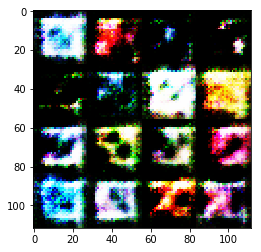

Epoch 9/10000... Discriminator Loss: 0.3751... Generator Loss: 3.5526


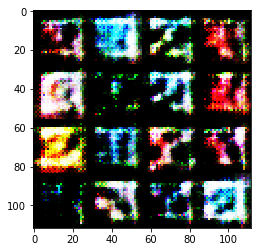

Epoch 9/10000... Discriminator Loss: 0.3895... Generator Loss: 3.4759


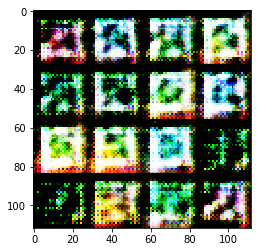

Epoch 9/10000... Discriminator Loss: 0.3676... Generator Loss: 3.7146


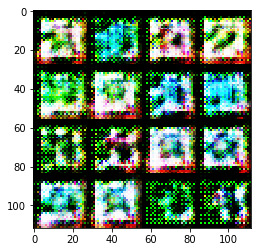

Epoch 10/10000... Discriminator Loss: 0.6015... Generator Loss: 2.3057


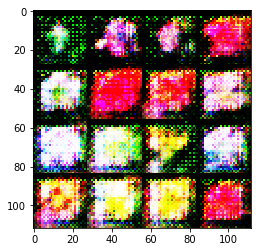

Epoch 10/10000... Discriminator Loss: 0.5392... Generator Loss: 2.0829


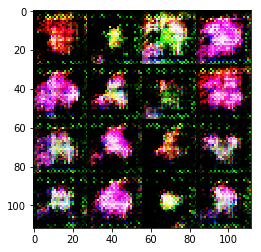

Epoch 10/10000... Discriminator Loss: 0.5913... Generator Loss: 2.5837


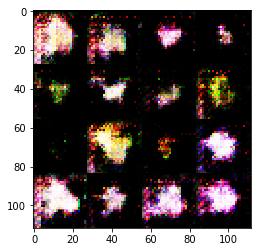

Epoch 10/10000... Discriminator Loss: 1.1607... Generator Loss: 0.7867


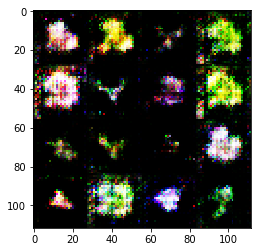

Epoch 10/10000... Discriminator Loss: 1.4971... Generator Loss: 0.4437


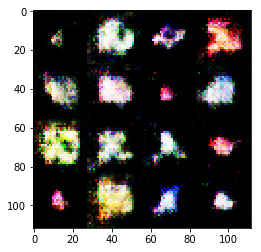

Epoch 10/10000... Discriminator Loss: 1.2221... Generator Loss: 1.8309


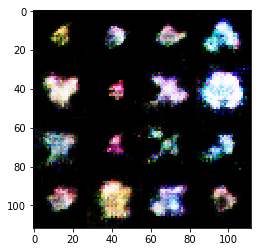

Epoch 10/10000... Discriminator Loss: 1.1605... Generator Loss: 1.0465


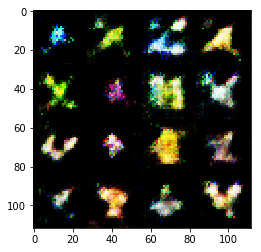

Epoch 10/10000... Discriminator Loss: 1.1615... Generator Loss: 0.8346


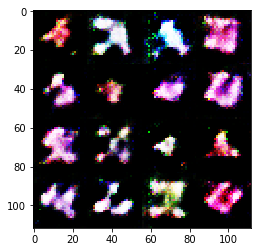

Epoch 10/10000... Discriminator Loss: 0.5544... Generator Loss: 2.2357


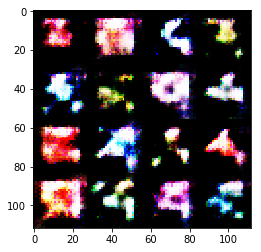

Epoch 10/10000... Discriminator Loss: 0.3799... Generator Loss: 3.5601


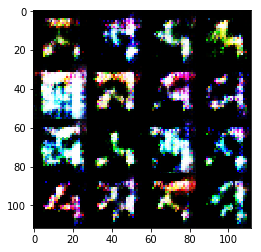

Epoch 10/10000... Discriminator Loss: 0.3671... Generator Loss: 4.0493


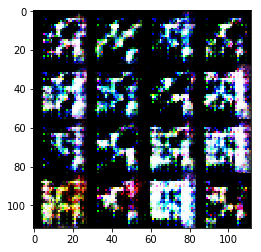

Epoch 10/10000... Discriminator Loss: 0.3639... Generator Loss: 4.1979


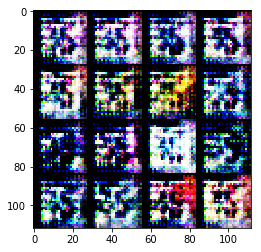

Epoch 10/10000... Discriminator Loss: 0.4086... Generator Loss: 4.0456


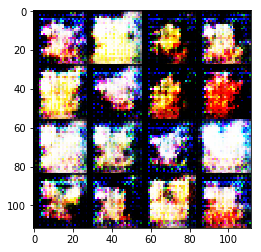

Epoch 11/10000... Discriminator Loss: 0.5287... Generator Loss: 2.1813


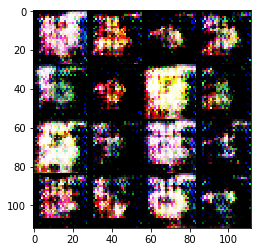

Epoch 11/10000... Discriminator Loss: 0.8869... Generator Loss: 0.9218


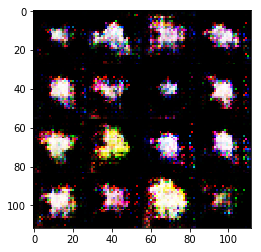

Epoch 11/10000... Discriminator Loss: 1.0454... Generator Loss: 1.1577


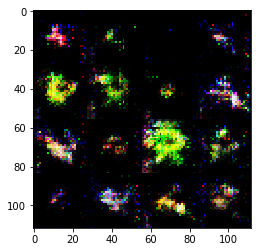

Epoch 11/10000... Discriminator Loss: 1.0506... Generator Loss: 2.2405


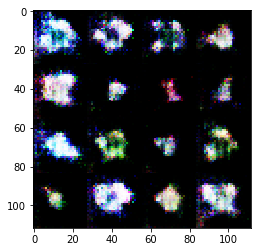

Epoch 11/10000... Discriminator Loss: 1.3125... Generator Loss: 1.5313


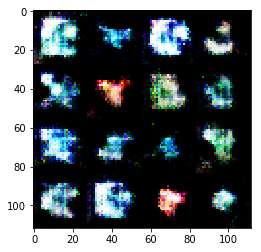

Epoch 11/10000... Discriminator Loss: 1.4056... Generator Loss: 0.7764


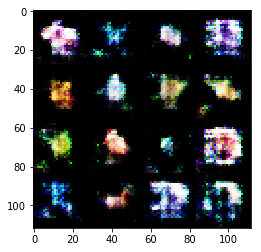

Epoch 11/10000... Discriminator Loss: 0.8508... Generator Loss: 1.4922


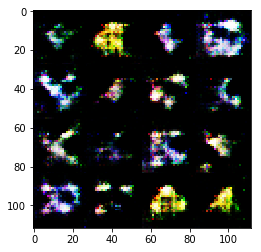

Epoch 11/10000... Discriminator Loss: 1.5601... Generator Loss: 1.7758


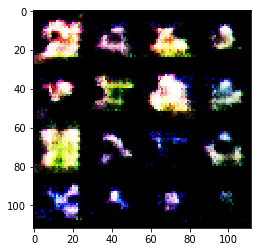

Epoch 11/10000... Discriminator Loss: 0.4230... Generator Loss: 2.9211


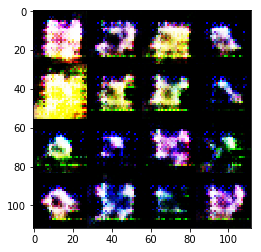

Epoch 11/10000... Discriminator Loss: 0.3795... Generator Loss: 3.7258


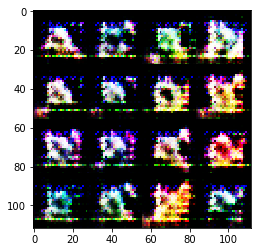

Epoch 11/10000... Discriminator Loss: 0.3844... Generator Loss: 3.9496


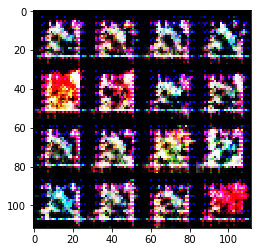

Epoch 11/10000... Discriminator Loss: 0.3873... Generator Loss: 3.6167


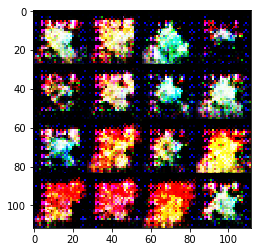

Epoch 12/10000... Discriminator Loss: 0.4992... Generator Loss: 2.3368


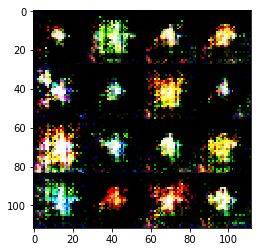

Epoch 12/10000... Discriminator Loss: 0.8324... Generator Loss: 1.2236


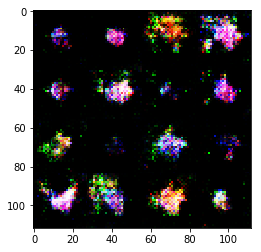

Epoch 12/10000... Discriminator Loss: 1.1415... Generator Loss: 0.8031


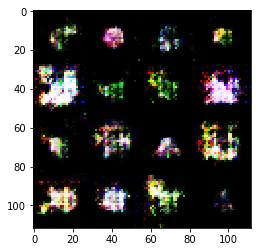

Epoch 12/10000... Discriminator Loss: 1.2991... Generator Loss: 1.2271


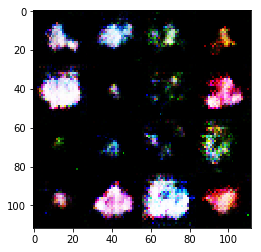

Epoch 12/10000... Discriminator Loss: 1.1165... Generator Loss: 1.2275


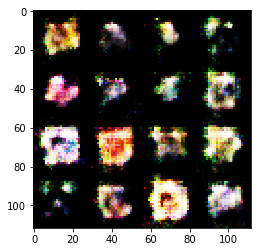

Epoch 12/10000... Discriminator Loss: 1.0434... Generator Loss: 1.0809


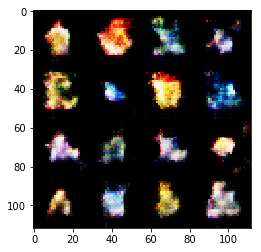

Epoch 12/10000... Discriminator Loss: 1.2775... Generator Loss: 1.2432


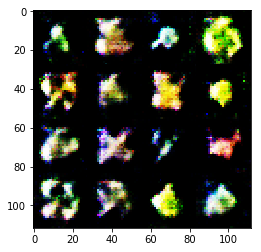

Epoch 12/10000... Discriminator Loss: 1.2020... Generator Loss: 0.8562


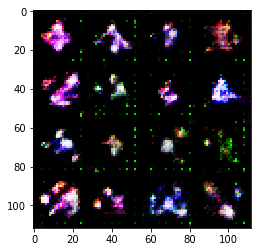

Epoch 12/10000... Discriminator Loss: 0.4054... Generator Loss: 3.1854


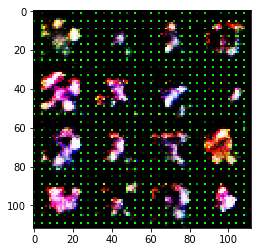

Epoch 12/10000... Discriminator Loss: 0.3717... Generator Loss: 3.9750


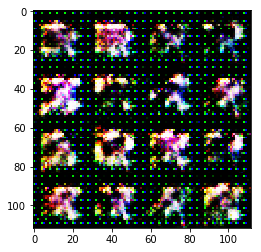

Epoch 12/10000... Discriminator Loss: 0.3571... Generator Loss: 4.2734


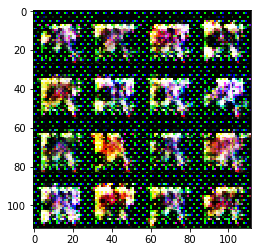

Epoch 12/10000... Discriminator Loss: 0.3500... Generator Loss: 4.7553


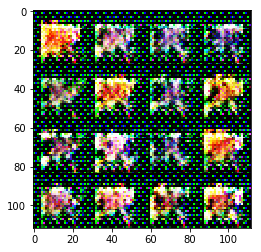

Epoch 13/10000... Discriminator Loss: 0.3956... Generator Loss: 4.3764


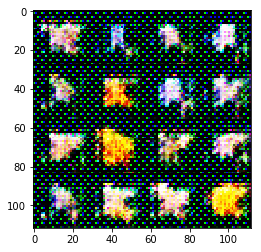

Epoch 13/10000... Discriminator Loss: 0.3853... Generator Loss: 3.3838


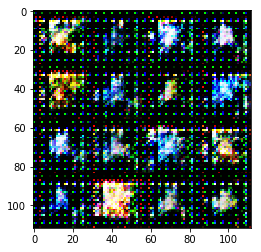

Epoch 13/10000... Discriminator Loss: 0.4453... Generator Loss: 2.6715


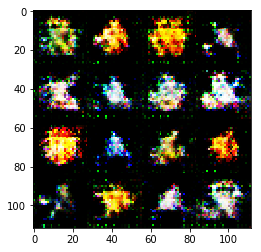

Epoch 13/10000... Discriminator Loss: 1.0579... Generator Loss: 0.7544


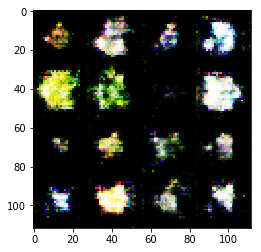

Epoch 13/10000... Discriminator Loss: 1.0144... Generator Loss: 1.1569


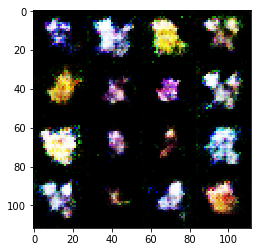

Epoch 13/10000... Discriminator Loss: 1.1977... Generator Loss: 1.6897


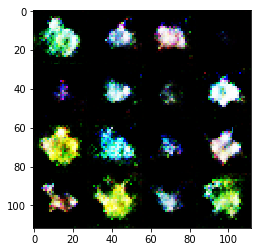

Epoch 13/10000... Discriminator Loss: 1.5181... Generator Loss: 0.5068


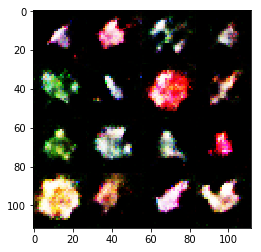

Epoch 13/10000... Discriminator Loss: 1.1316... Generator Loss: 0.8816


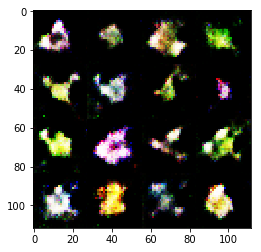

Epoch 13/10000... Discriminator Loss: 0.3941... Generator Loss: 3.9359


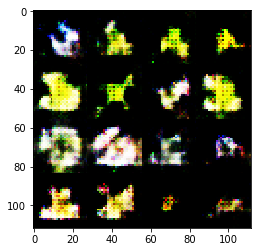

Epoch 13/10000... Discriminator Loss: 0.3868... Generator Loss: 3.4945


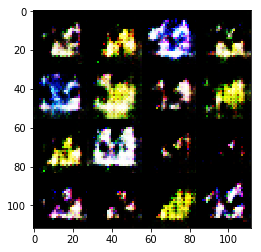

Epoch 13/10000... Discriminator Loss: 0.3667... Generator Loss: 4.4483


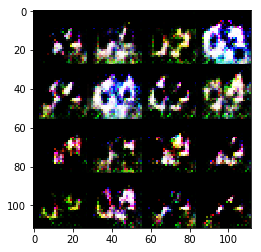

Epoch 13/10000... Discriminator Loss: 0.3566... Generator Loss: 3.9869


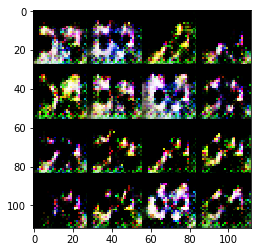

Epoch 14/10000... Discriminator Loss: 4.6969... Generator Loss: 1.5590


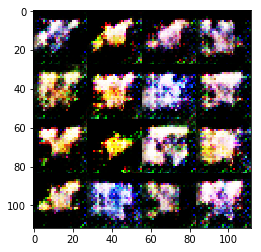

Epoch 14/10000... Discriminator Loss: 0.8112... Generator Loss: 1.5255


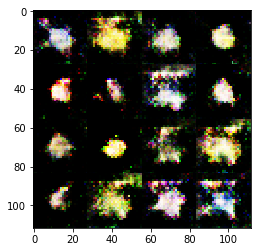

Epoch 14/10000... Discriminator Loss: 1.5056... Generator Loss: 2.5786


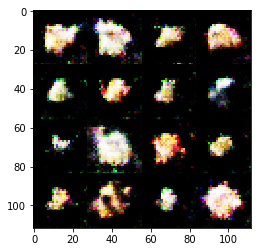

Epoch 14/10000... Discriminator Loss: 1.2260... Generator Loss: 1.0904


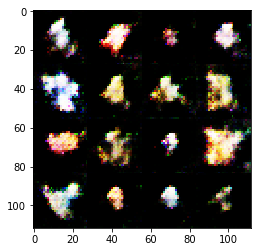

Epoch 14/10000... Discriminator Loss: 1.1945... Generator Loss: 0.8970


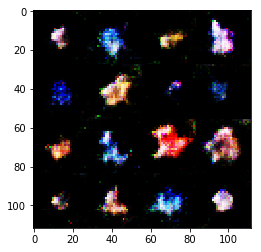

Epoch 14/10000... Discriminator Loss: 0.8858... Generator Loss: 1.0910


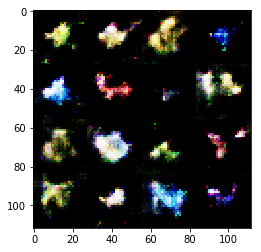

Epoch 14/10000... Discriminator Loss: 1.0942... Generator Loss: 0.9035


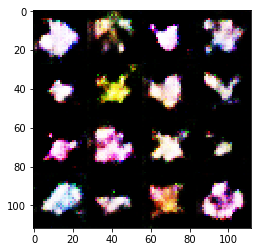

Epoch 14/10000... Discriminator Loss: 1.5665... Generator Loss: 2.4531


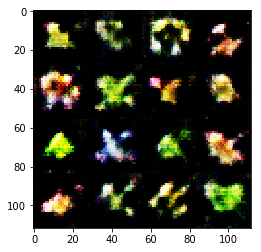

Epoch 14/10000... Discriminator Loss: 1.3054... Generator Loss: 1.1201


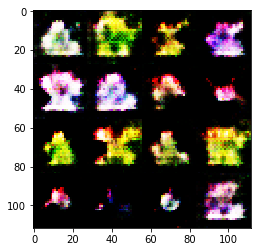

Epoch 14/10000... Discriminator Loss: 0.4216... Generator Loss: 2.9708


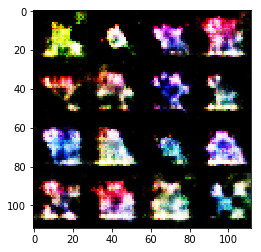

Epoch 14/10000... Discriminator Loss: 0.3721... Generator Loss: 3.8984


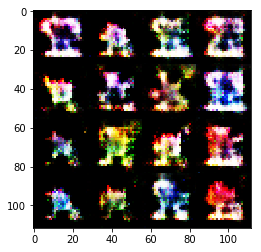

Epoch 14/10000... Discriminator Loss: 0.3692... Generator Loss: 3.9260


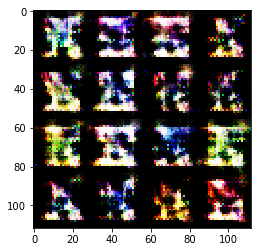

Epoch 14/10000... Discriminator Loss: 0.3831... Generator Loss: 3.6520


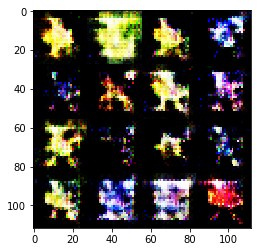

Epoch 15/10000... Discriminator Loss: 0.5820... Generator Loss: 1.9261


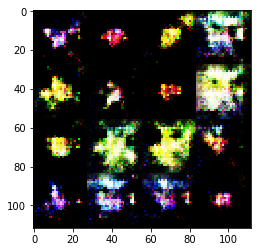

Epoch 15/10000... Discriminator Loss: 0.7598... Generator Loss: 2.1640


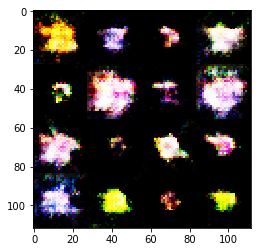

Epoch 15/10000... Discriminator Loss: 1.3107... Generator Loss: 2.4812


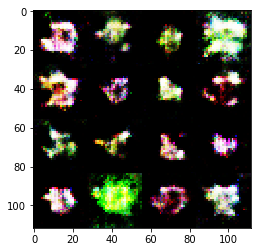

Epoch 15/10000... Discriminator Loss: 1.1456... Generator Loss: 1.0455


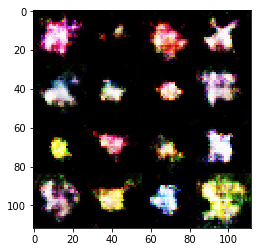

Epoch 15/10000... Discriminator Loss: 1.0885... Generator Loss: 1.2559


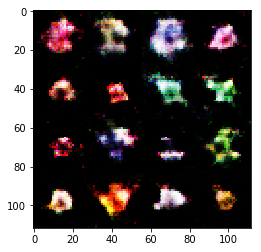

Epoch 15/10000... Discriminator Loss: 1.2729... Generator Loss: 1.6204


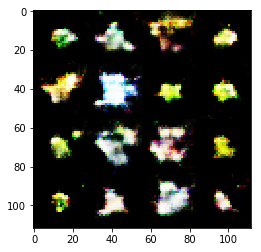

Epoch 15/10000... Discriminator Loss: 1.2357... Generator Loss: 0.6692


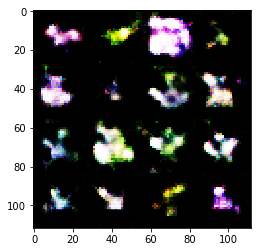

Epoch 15/10000... Discriminator Loss: 1.3013... Generator Loss: 0.8282


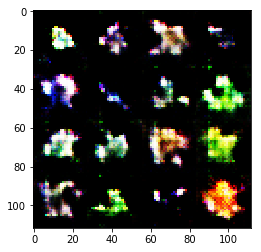

Epoch 15/10000... Discriminator Loss: 0.3834... Generator Loss: 3.6343


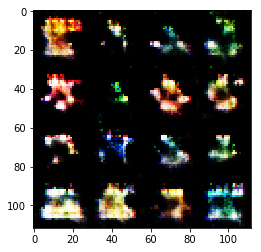

Epoch 15/10000... Discriminator Loss: 0.3584... Generator Loss: 4.1629


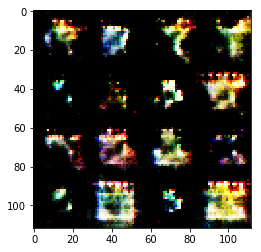

Epoch 15/10000... Discriminator Loss: 0.3551... Generator Loss: 4.3165


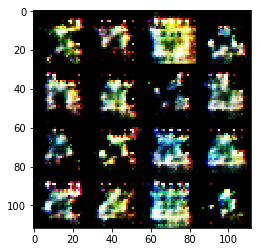

Epoch 15/10000... Discriminator Loss: 0.3472... Generator Loss: 4.4938


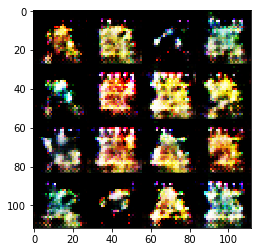

Epoch 16/10000... Discriminator Loss: 0.4577... Generator Loss: 3.2058


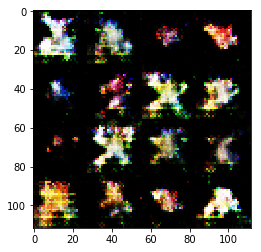

Epoch 16/10000... Discriminator Loss: 1.1362... Generator Loss: 1.0137


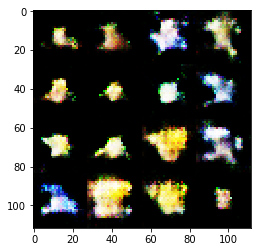

Epoch 16/10000... Discriminator Loss: 1.4176... Generator Loss: 0.5633


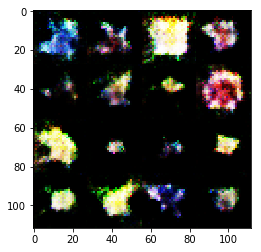

Epoch 16/10000... Discriminator Loss: 1.5819... Generator Loss: 0.3994


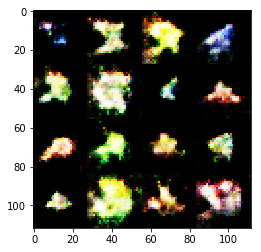

Epoch 16/10000... Discriminator Loss: 1.6676... Generator Loss: 0.3935


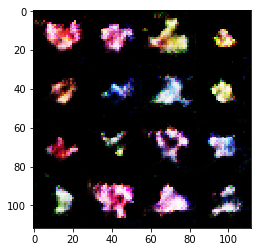

Epoch 16/10000... Discriminator Loss: 1.4820... Generator Loss: 1.9922


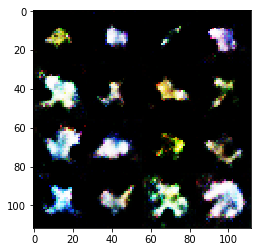

Epoch 16/10000... Discriminator Loss: 1.2350... Generator Loss: 1.0953


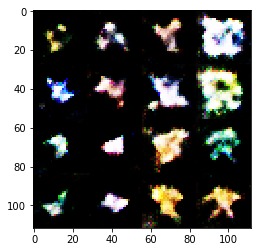

Epoch 16/10000... Discriminator Loss: 1.2795... Generator Loss: 1.0992


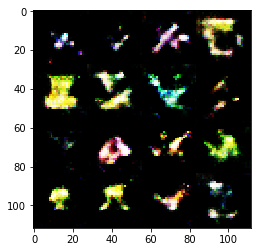

Epoch 16/10000... Discriminator Loss: 0.3864... Generator Loss: 3.8152


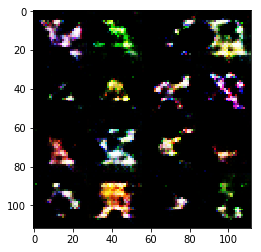

Epoch 16/10000... Discriminator Loss: 0.3694... Generator Loss: 3.9130


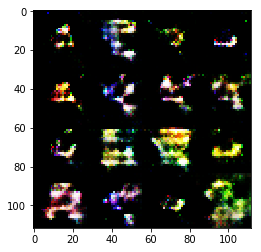

Epoch 16/10000... Discriminator Loss: 0.3579... Generator Loss: 4.2946


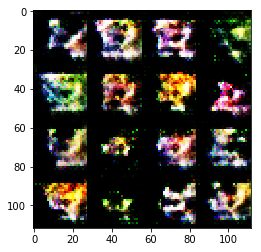

Epoch 16/10000... Discriminator Loss: 0.3567... Generator Loss: 4.2367


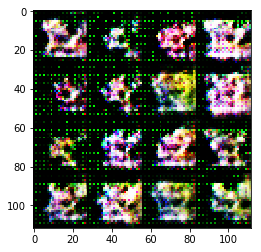

Epoch 17/10000... Discriminator Loss: 1.2928... Generator Loss: 0.6568


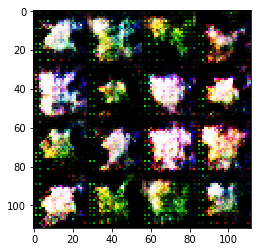

Epoch 17/10000... Discriminator Loss: 0.8260... Generator Loss: 1.4316


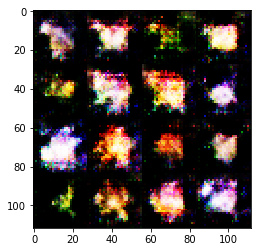

Epoch 17/10000... Discriminator Loss: 1.1145... Generator Loss: 0.9798


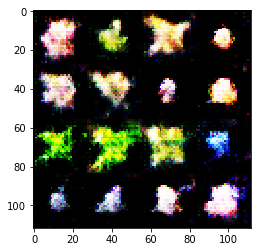

Epoch 17/10000... Discriminator Loss: 1.2676... Generator Loss: 0.8149


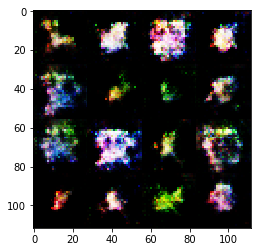

Epoch 17/10000... Discriminator Loss: 1.3497... Generator Loss: 0.7212


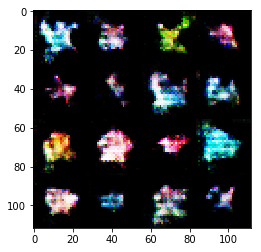

Epoch 17/10000... Discriminator Loss: 1.4455... Generator Loss: 0.4744


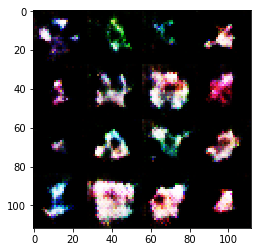

Epoch 17/10000... Discriminator Loss: 1.6086... Generator Loss: 0.6967


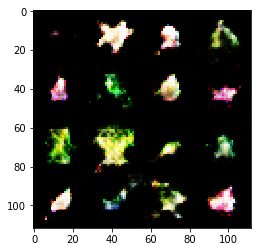

Epoch 17/10000... Discriminator Loss: 1.1643... Generator Loss: 1.6644


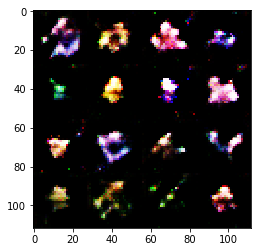

Epoch 17/10000... Discriminator Loss: 1.1091... Generator Loss: 1.0499


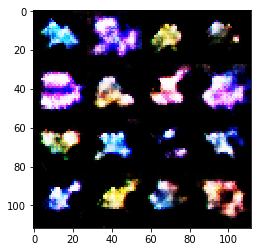

Epoch 17/10000... Discriminator Loss: 0.3970... Generator Loss: 3.8871


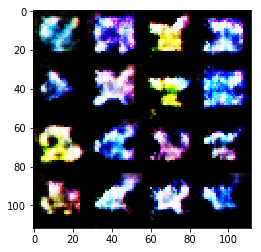

Epoch 17/10000... Discriminator Loss: 0.3727... Generator Loss: 3.8470


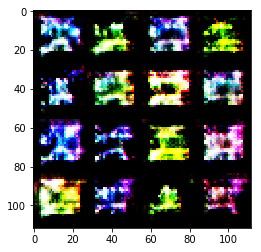

Epoch 17/10000... Discriminator Loss: 0.3662... Generator Loss: 4.1605


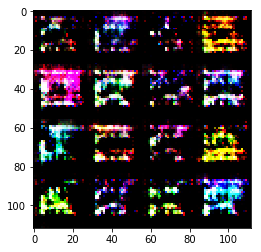

Epoch 17/10000... Discriminator Loss: 0.3715... Generator Loss: 3.7324


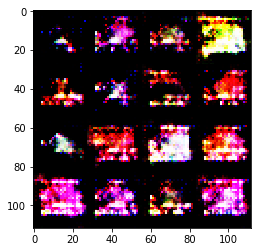

Epoch 18/10000... Discriminator Loss: 0.5899... Generator Loss: 1.7172


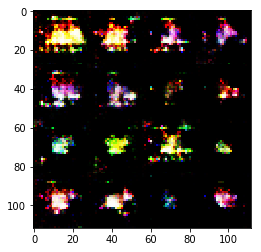

Epoch 18/10000... Discriminator Loss: 0.6539... Generator Loss: 1.7990


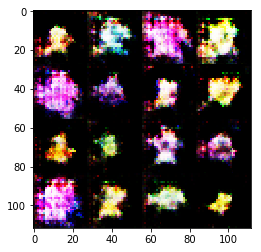

Epoch 18/10000... Discriminator Loss: 0.7779... Generator Loss: 1.5062


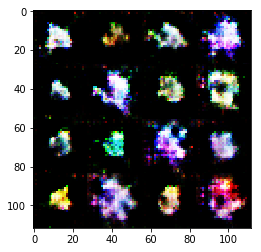

Epoch 18/10000... Discriminator Loss: 1.4560... Generator Loss: 0.5844


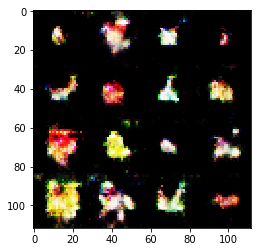

Epoch 18/10000... Discriminator Loss: 0.8117... Generator Loss: 1.6690


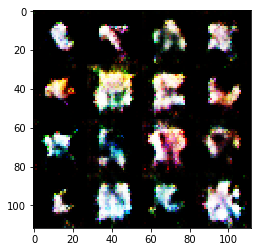

Epoch 18/10000... Discriminator Loss: 1.0371... Generator Loss: 1.0738


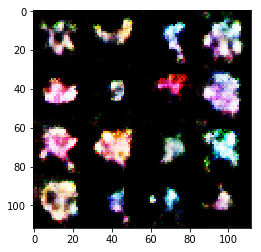

Epoch 18/10000... Discriminator Loss: 1.3423... Generator Loss: 0.6392


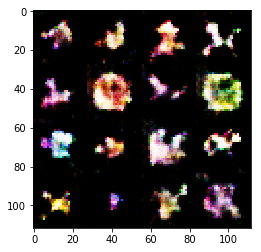

Epoch 18/10000... Discriminator Loss: 1.3382... Generator Loss: 1.2040


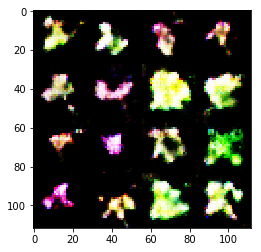

Epoch 18/10000... Discriminator Loss: 0.3813... Generator Loss: 3.6091


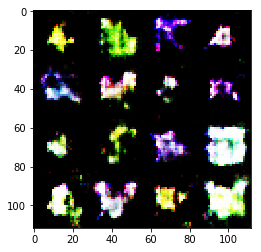

Epoch 18/10000... Discriminator Loss: 0.3704... Generator Loss: 3.8647


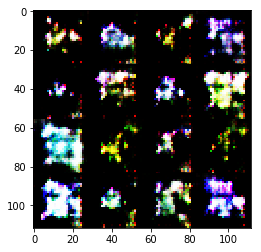

Epoch 18/10000... Discriminator Loss: 0.3835... Generator Loss: 3.5798


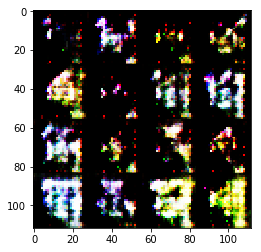

Epoch 18/10000... Discriminator Loss: 0.3585... Generator Loss: 4.1761


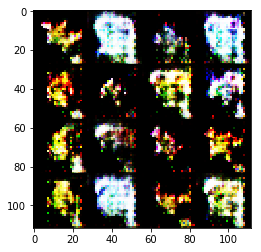

Epoch 19/10000... Discriminator Loss: 0.3934... Generator Loss: 3.3909


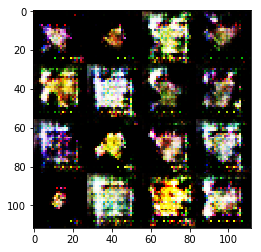

Epoch 19/10000... Discriminator Loss: 0.6841... Generator Loss: 1.6257


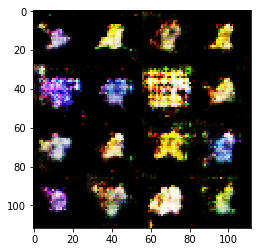

Epoch 19/10000... Discriminator Loss: 0.9954... Generator Loss: 0.9800


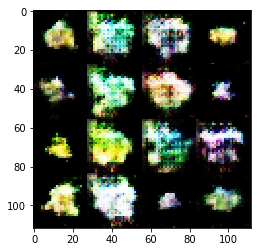

Epoch 19/10000... Discriminator Loss: 1.0024... Generator Loss: 1.8071


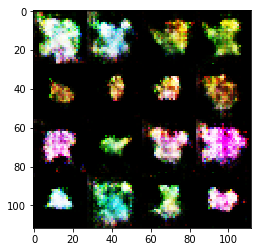

Epoch 19/10000... Discriminator Loss: 1.3454... Generator Loss: 0.8308


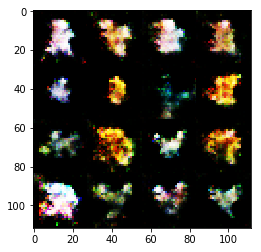

Epoch 19/10000... Discriminator Loss: 1.0572... Generator Loss: 1.2083


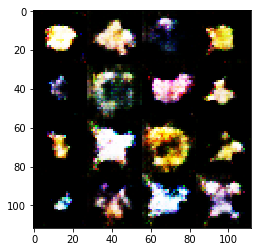

Epoch 19/10000... Discriminator Loss: 1.2520... Generator Loss: 0.7087


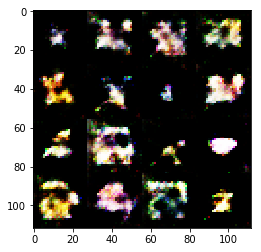

Epoch 19/10000... Discriminator Loss: 1.3099... Generator Loss: 0.7838


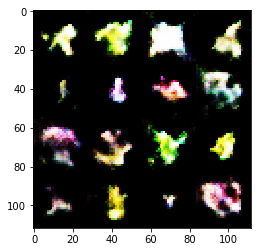

Epoch 19/10000... Discriminator Loss: 0.3705... Generator Loss: 4.2831


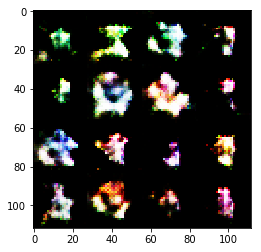

Epoch 19/10000... Discriminator Loss: 0.3614... Generator Loss: 4.0682


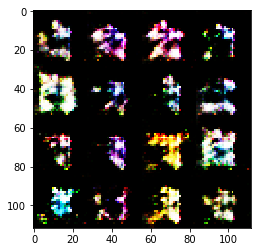

Epoch 19/10000... Discriminator Loss: 0.3592... Generator Loss: 4.0371


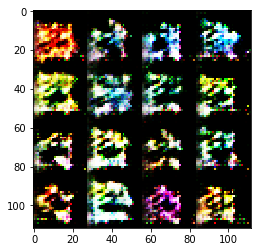

Epoch 19/10000... Discriminator Loss: 0.3493... Generator Loss: 4.4572


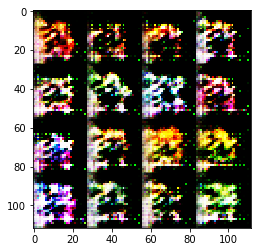

Epoch 20/10000... Discriminator Loss: 0.4656... Generator Loss: 3.9743


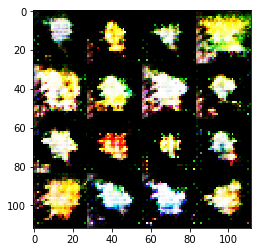

Epoch 20/10000... Discriminator Loss: 0.5548... Generator Loss: 2.0686


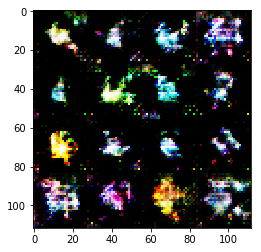

Epoch 20/10000... Discriminator Loss: 0.8637... Generator Loss: 3.0800


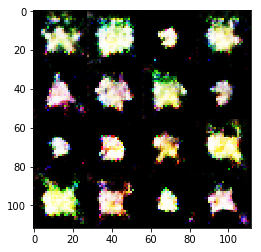

Epoch 20/10000... Discriminator Loss: 2.1738... Generator Loss: 4.6783


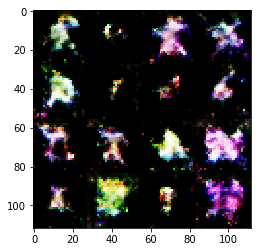

Epoch 20/10000... Discriminator Loss: 0.9410... Generator Loss: 1.4938


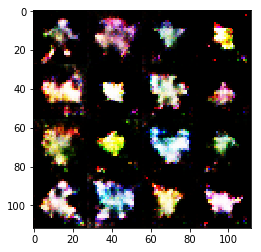

Epoch 20/10000... Discriminator Loss: 1.1401... Generator Loss: 1.7423


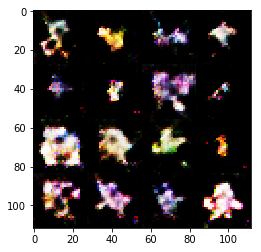

Epoch 20/10000... Discriminator Loss: 1.0853... Generator Loss: 1.0801


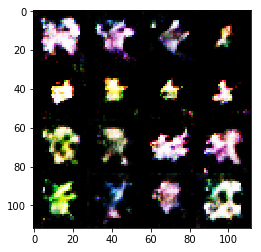

Epoch 20/10000... Discriminator Loss: 1.1667... Generator Loss: 1.2636


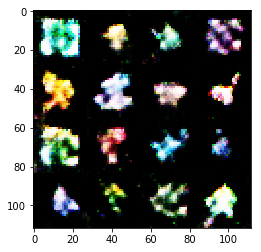

Epoch 20/10000... Discriminator Loss: 0.4271... Generator Loss: 2.9297


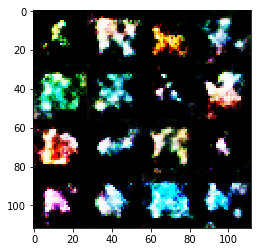

Epoch 20/10000... Discriminator Loss: 0.3718... Generator Loss: 4.0398


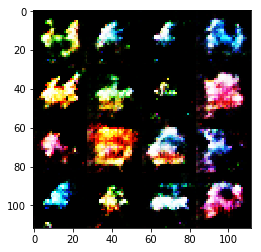

Epoch 20/10000... Discriminator Loss: 0.3572... Generator Loss: 4.5008


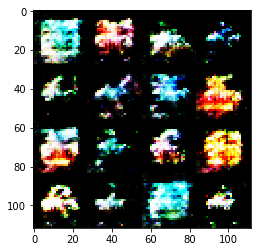

Epoch 20/10000... Discriminator Loss: 0.3564... Generator Loss: 4.5204


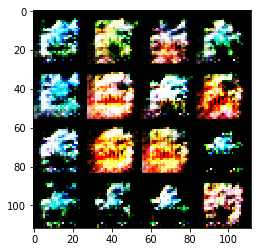

Epoch 20/10000... Discriminator Loss: 0.3655... Generator Loss: 4.2174


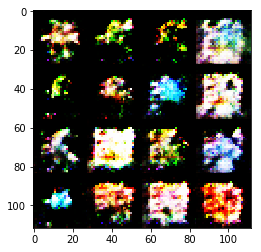

Epoch 21/10000... Discriminator Loss: 0.5192... Generator Loss: 2.1781


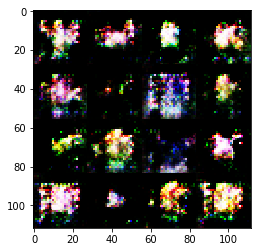

Epoch 21/10000... Discriminator Loss: 1.4120... Generator Loss: 3.6894


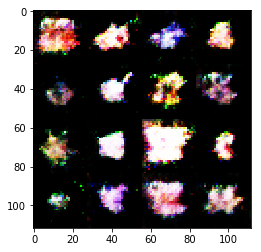

Epoch 21/10000... Discriminator Loss: 1.0694... Generator Loss: 1.1491


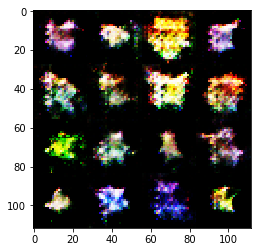

Epoch 21/10000... Discriminator Loss: 1.1904... Generator Loss: 1.1610


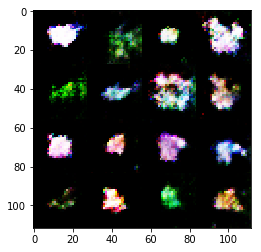

Epoch 21/10000... Discriminator Loss: 1.0979... Generator Loss: 1.0801


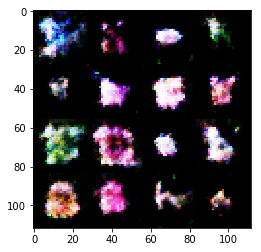

Epoch 21/10000... Discriminator Loss: 0.9754... Generator Loss: 1.2179


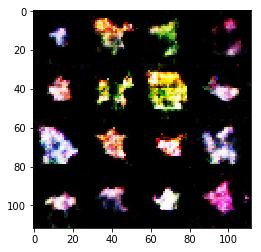

Epoch 21/10000... Discriminator Loss: 0.9063... Generator Loss: 1.8384


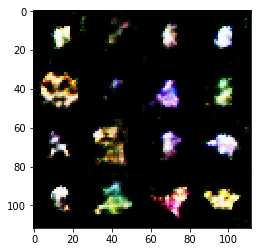

Epoch 21/10000... Discriminator Loss: 1.0815... Generator Loss: 1.0544


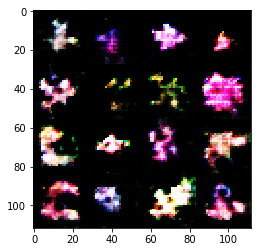

Epoch 21/10000... Discriminator Loss: 0.3822... Generator Loss: 3.6938


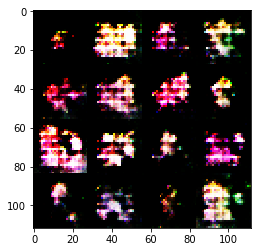

Epoch 21/10000... Discriminator Loss: 0.3681... Generator Loss: 4.0732


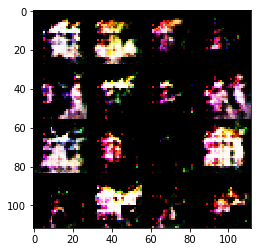

Epoch 21/10000... Discriminator Loss: 0.3660... Generator Loss: 4.2475


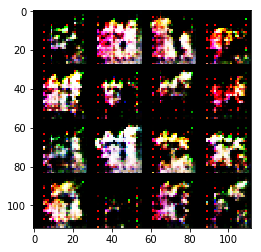

Epoch 21/10000... Discriminator Loss: 0.3653... Generator Loss: 4.0446


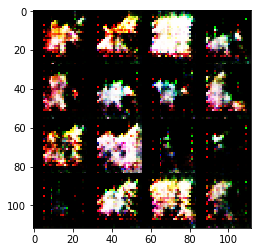

Epoch 22/10000... Discriminator Loss: 0.4025... Generator Loss: 3.0628


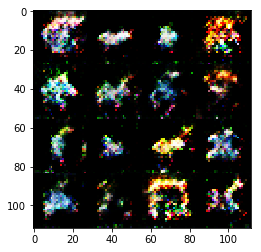

Epoch 22/10000... Discriminator Loss: 2.3203... Generator Loss: 0.1910


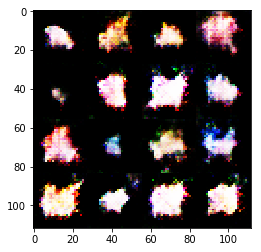

Epoch 22/10000... Discriminator Loss: 0.8646... Generator Loss: 1.4060


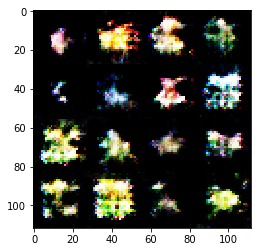

Epoch 22/10000... Discriminator Loss: 1.2112... Generator Loss: 0.8870


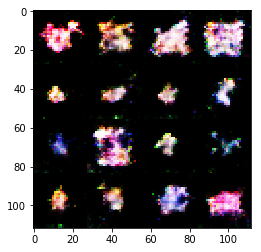

Epoch 22/10000... Discriminator Loss: 1.1260... Generator Loss: 0.9109


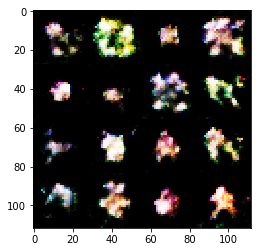

Epoch 22/10000... Discriminator Loss: 1.1398... Generator Loss: 1.0619


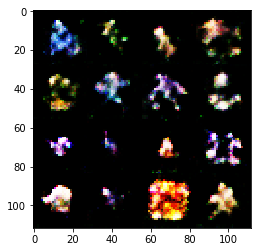

Epoch 22/10000... Discriminator Loss: 1.0323... Generator Loss: 1.3166


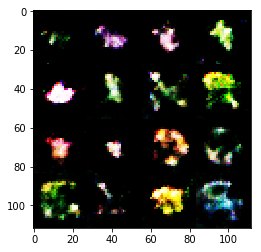

Epoch 22/10000... Discriminator Loss: 1.1479... Generator Loss: 1.4333


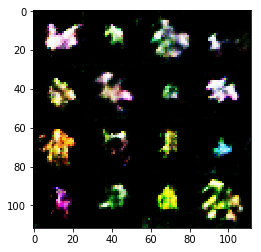

Epoch 22/10000... Discriminator Loss: 0.3841... Generator Loss: 3.6251


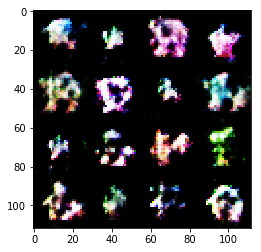

Epoch 22/10000... Discriminator Loss: 0.3592... Generator Loss: 4.1888


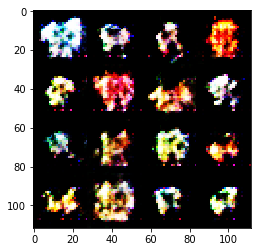

Epoch 22/10000... Discriminator Loss: 0.3549... Generator Loss: 4.2560


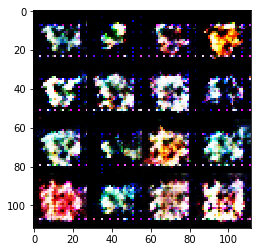

Epoch 22/10000... Discriminator Loss: 0.3491... Generator Loss: 4.6643


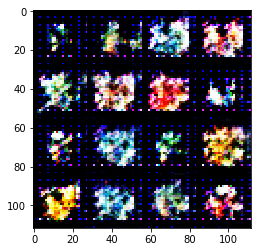

Epoch 23/10000... Discriminator Loss: 0.4422... Generator Loss: 2.9303


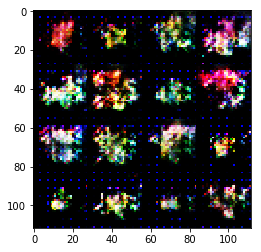

Epoch 23/10000... Discriminator Loss: 0.7158... Generator Loss: 2.4157


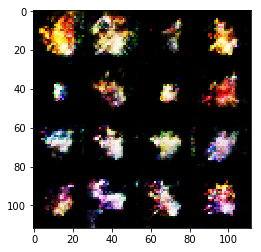

Epoch 23/10000... Discriminator Loss: 0.8927... Generator Loss: 1.1126


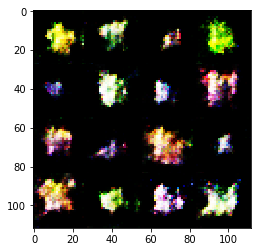

Epoch 23/10000... Discriminator Loss: 0.9201... Generator Loss: 1.3125


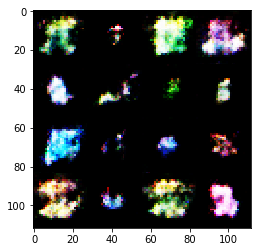

Epoch 23/10000... Discriminator Loss: 0.9657... Generator Loss: 1.1409


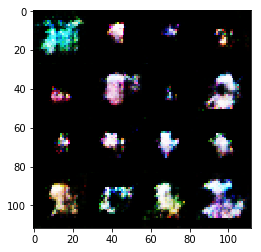

Epoch 23/10000... Discriminator Loss: 1.4518... Generator Loss: 0.6006


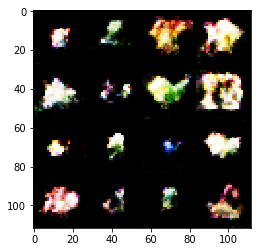

Epoch 23/10000... Discriminator Loss: 1.2648... Generator Loss: 0.7771


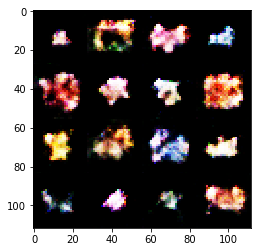

Epoch 23/10000... Discriminator Loss: 1.1069... Generator Loss: 1.0387


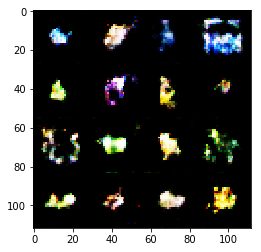

Epoch 23/10000... Discriminator Loss: 0.4038... Generator Loss: 3.9382


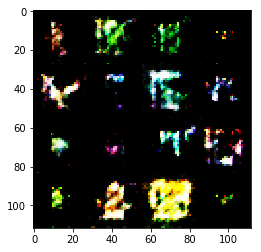

Epoch 23/10000... Discriminator Loss: 0.3692... Generator Loss: 3.9880


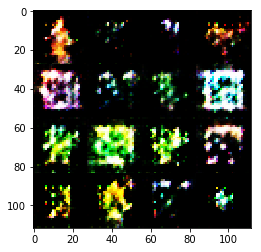

Epoch 23/10000... Discriminator Loss: 0.3576... Generator Loss: 4.5002


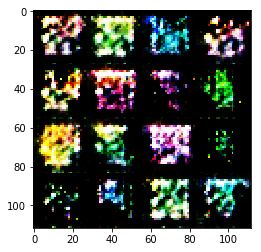

Epoch 23/10000... Discriminator Loss: 0.3516... Generator Loss: 4.5423


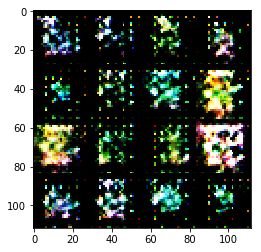

Epoch 24/10000... Discriminator Loss: 3.9491... Generator Loss: 1.3933


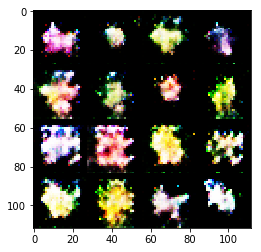

Epoch 24/10000... Discriminator Loss: 0.5401... Generator Loss: 1.9522


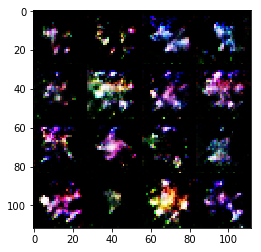

Epoch 24/10000... Discriminator Loss: 1.9114... Generator Loss: 2.3767


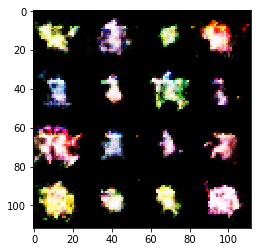

Epoch 24/10000... Discriminator Loss: 1.1069... Generator Loss: 2.5789


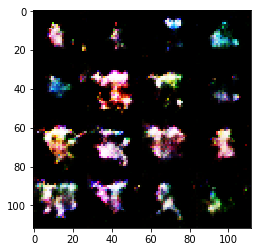

Epoch 24/10000... Discriminator Loss: 1.0604... Generator Loss: 0.9834


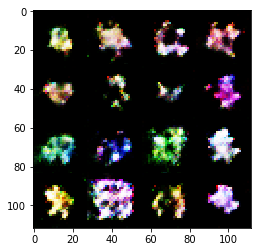

Epoch 24/10000... Discriminator Loss: 1.0475... Generator Loss: 1.1063


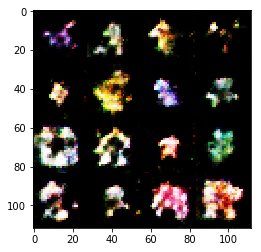

Epoch 24/10000... Discriminator Loss: 0.9940... Generator Loss: 1.1549


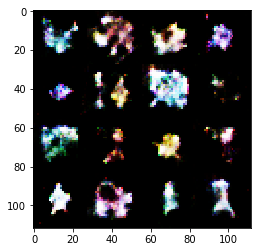

Epoch 24/10000... Discriminator Loss: 1.3555... Generator Loss: 0.7281


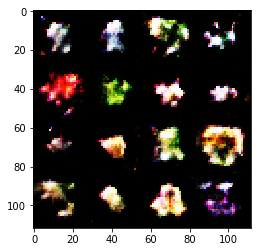

Epoch 24/10000... Discriminator Loss: 1.3683... Generator Loss: 0.8729


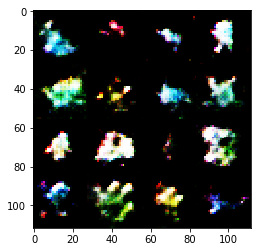

Epoch 24/10000... Discriminator Loss: 0.3769... Generator Loss: 3.6387


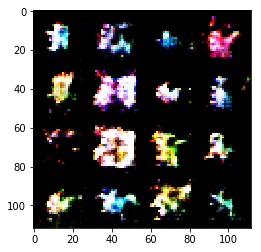

Epoch 24/10000... Discriminator Loss: 0.3697... Generator Loss: 4.1269


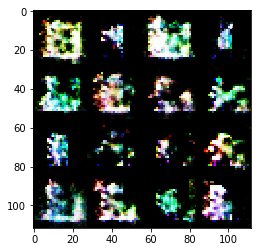

Epoch 24/10000... Discriminator Loss: 0.3567... Generator Loss: 4.2393


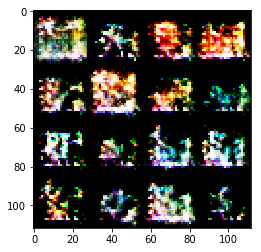

Epoch 24/10000... Discriminator Loss: 0.3665... Generator Loss: 3.9350


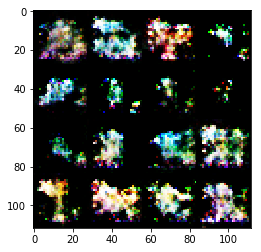

Epoch 25/10000... Discriminator Loss: 0.5599... Generator Loss: 1.9693


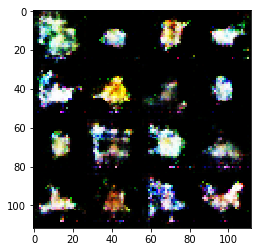

Epoch 25/10000... Discriminator Loss: 1.6285... Generator Loss: 2.3868


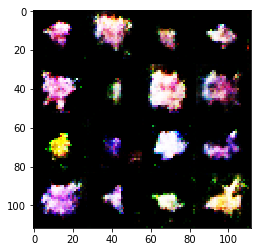

Epoch 25/10000... Discriminator Loss: 0.7551... Generator Loss: 1.6326


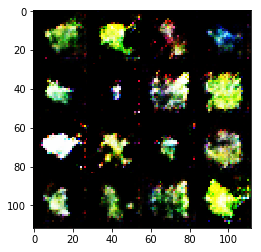

Epoch 25/10000... Discriminator Loss: 0.8182... Generator Loss: 1.7326


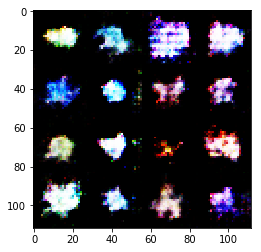

Epoch 25/10000... Discriminator Loss: 1.3132... Generator Loss: 1.2856


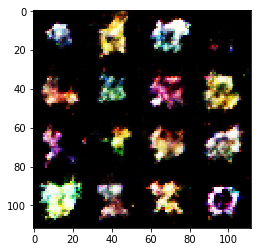

Epoch 25/10000... Discriminator Loss: 1.5361... Generator Loss: 1.9059


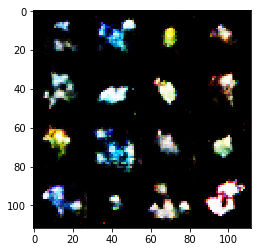

Epoch 25/10000... Discriminator Loss: 1.0720... Generator Loss: 1.1050


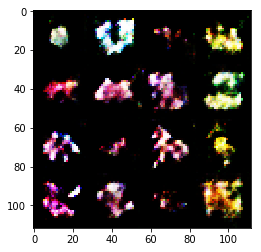

Epoch 25/10000... Discriminator Loss: 1.1020... Generator Loss: 1.1675


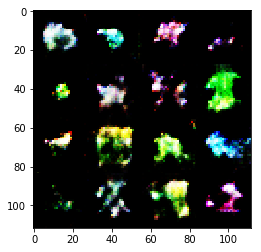

Epoch 25/10000... Discriminator Loss: 0.3766... Generator Loss: 3.7361


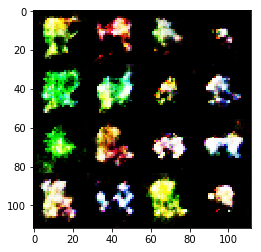

Epoch 25/10000... Discriminator Loss: 0.3575... Generator Loss: 4.2064


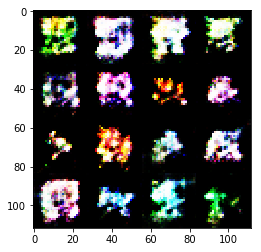

Epoch 25/10000... Discriminator Loss: 0.3488... Generator Loss: 4.4473


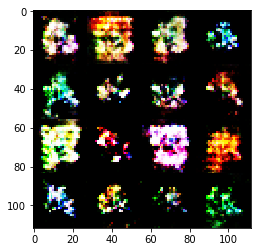

Epoch 25/10000... Discriminator Loss: 0.3506... Generator Loss: 4.6448


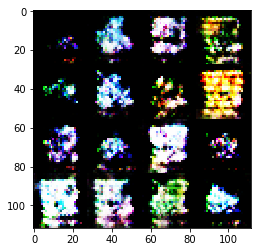

Epoch 26/10000... Discriminator Loss: 0.3987... Generator Loss: 4.0974


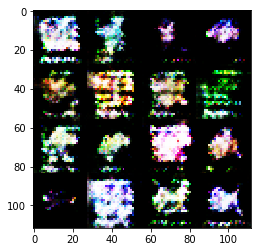

Epoch 26/10000... Discriminator Loss: 0.7888... Generator Loss: 1.3137


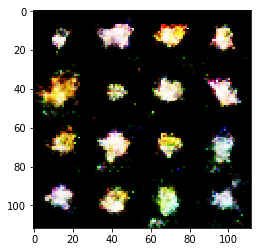

Epoch 26/10000... Discriminator Loss: 0.8945... Generator Loss: 1.1878


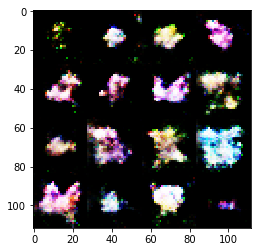

Epoch 26/10000... Discriminator Loss: 0.9621... Generator Loss: 1.5574


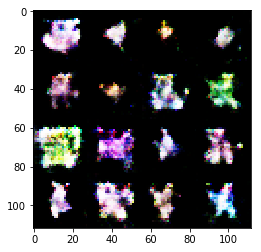

Epoch 26/10000... Discriminator Loss: 1.0858... Generator Loss: 1.3714


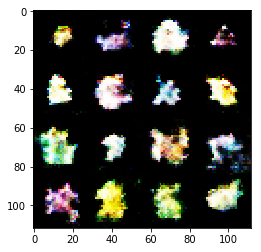

Epoch 26/10000... Discriminator Loss: 1.0699... Generator Loss: 0.9886


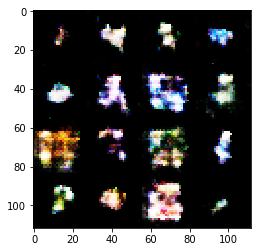

Epoch 26/10000... Discriminator Loss: 1.2669... Generator Loss: 0.7955


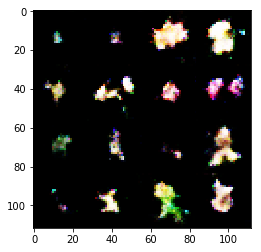

Epoch 26/10000... Discriminator Loss: 1.2530... Generator Loss: 0.9816


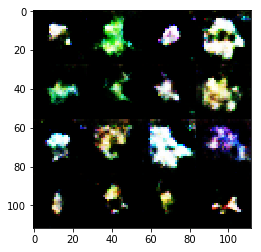

Epoch 26/10000... Discriminator Loss: 0.3900... Generator Loss: 3.6063


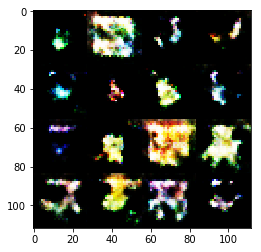

Epoch 26/10000... Discriminator Loss: 0.3586... Generator Loss: 3.9847


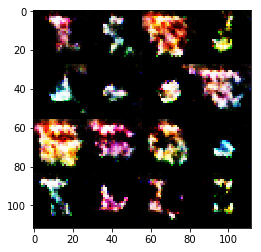

Epoch 26/10000... Discriminator Loss: 0.3626... Generator Loss: 4.0717


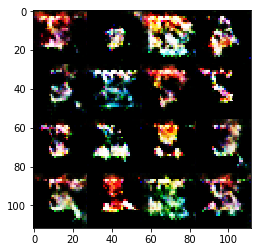

Epoch 26/10000... Discriminator Loss: 0.3511... Generator Loss: 4.5829


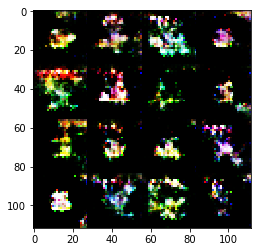

Epoch 27/10000... Discriminator Loss: 2.1757... Generator Loss: 0.2723


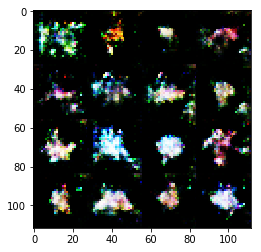

Epoch 27/10000... Discriminator Loss: 2.2232... Generator Loss: 4.7025


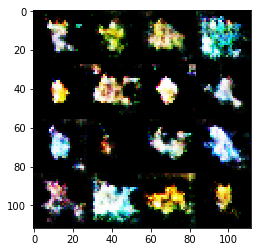

Epoch 27/10000... Discriminator Loss: 1.2035... Generator Loss: 1.1808


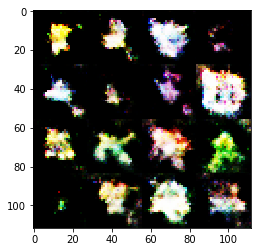

Epoch 27/10000... Discriminator Loss: 0.9638... Generator Loss: 1.2985


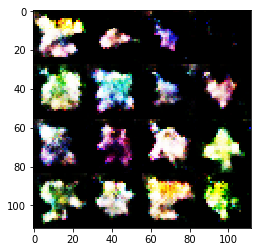

Epoch 27/10000... Discriminator Loss: 1.1558... Generator Loss: 1.2196


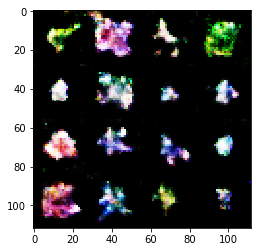

Epoch 27/10000... Discriminator Loss: 1.2109... Generator Loss: 1.2518


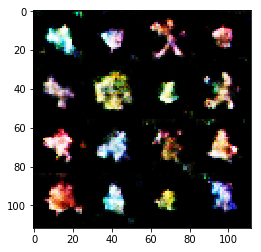

Epoch 27/10000... Discriminator Loss: 1.2965... Generator Loss: 0.7776


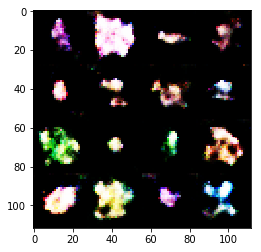

Epoch 27/10000... Discriminator Loss: 1.1265... Generator Loss: 1.1003


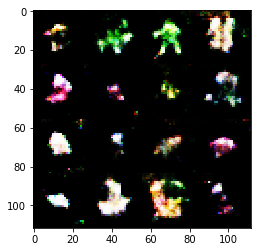

Epoch 27/10000... Discriminator Loss: 0.9120... Generator Loss: 1.6313


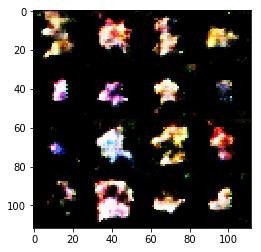

Epoch 27/10000... Discriminator Loss: 0.3655... Generator Loss: 3.7451


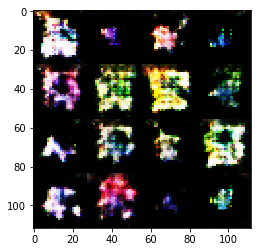

Epoch 27/10000... Discriminator Loss: 0.3535... Generator Loss: 4.1550


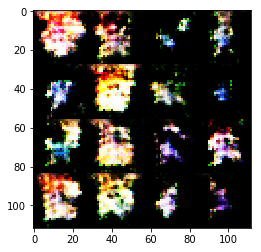

Epoch 27/10000... Discriminator Loss: 0.3508... Generator Loss: 4.3756


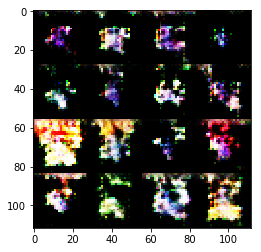

Epoch 27/10000... Discriminator Loss: 0.3535... Generator Loss: 4.1712


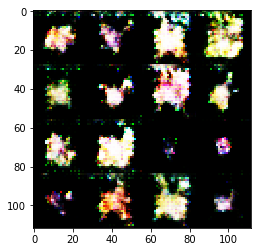

Epoch 28/10000... Discriminator Loss: 0.6290... Generator Loss: 1.6656


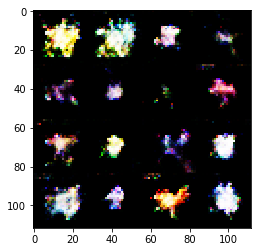

Epoch 28/10000... Discriminator Loss: 0.7915... Generator Loss: 1.8056


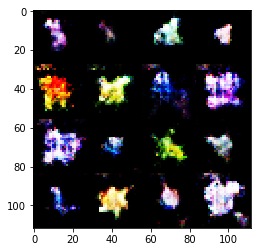

Epoch 28/10000... Discriminator Loss: 1.0231... Generator Loss: 1.6794


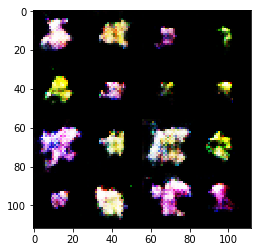

Epoch 28/10000... Discriminator Loss: 0.9890... Generator Loss: 1.3229


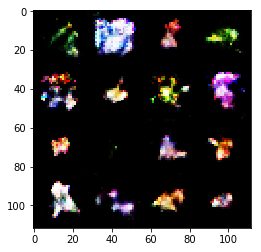

Epoch 28/10000... Discriminator Loss: 1.0648... Generator Loss: 1.3463


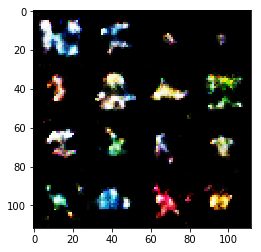

Epoch 28/10000... Discriminator Loss: 0.9699... Generator Loss: 1.0845


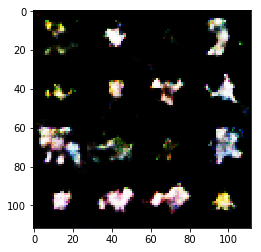

Epoch 28/10000... Discriminator Loss: 1.2513... Generator Loss: 1.1409


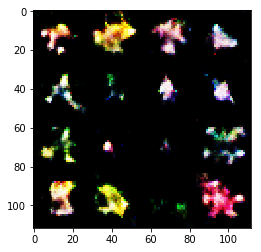

Epoch 28/10000... Discriminator Loss: 1.3739... Generator Loss: 0.6221


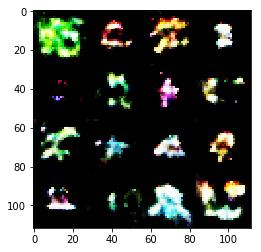

Epoch 28/10000... Discriminator Loss: 0.3882... Generator Loss: 3.4858


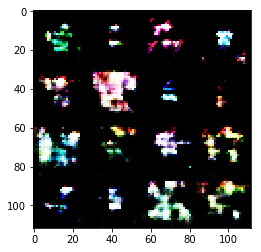

Epoch 28/10000... Discriminator Loss: 0.3596... Generator Loss: 4.0427


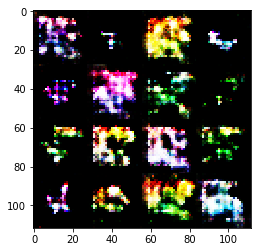

Epoch 28/10000... Discriminator Loss: 0.3633... Generator Loss: 4.2610


KeyboardInterrupt: 

In [25]:
batch_size = 64
epochs = 10000
z_dim = 160
learning_rate = 0.0005
beta1 = 0.5
alpha = 0.1
# Smoothing 
smooth = 0.1

dataset = helper.Dataset('RGB', helper.get_images())
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, dataset.get_batches,
          dataset.shape, dataset.image_mode, alpha=alpha, smooth=smooth)